# Solvency Capital Requirement (SCR) Prediction Model

## Executive Summary
- **Objective**: Predict SCR, EM (Eligible Margin), and Solvency Quote for insurance companies
- **Key Metrics**: Quote (EM/SCR ratio) for regulatory compliance assessment
- **Dataset**: 10,230 observations with financial and risk metrics


## Table of Contents
1. [Environment Setup & Imports](#section1)
2. [Utility Functions](#section2)
3. [Data Loading & Preprocessing](#section3)
4. [Exploratory Data Analysis](#section4)
5. [Model Development](#section5)
6. [Model Comparison](#section6)
7. [Visualis](#section7)
8. [Saving Artifacts](#section8)
9. [Backtesting](#section9)
10. [SHAP Analysis](#section10)

<a id='section1'></a>
## 1. Environment Setup & Imports

In [4]:
# Standard library imports
import os
import copy
import json
import pickle
import warnings
from pathlib import Path
from datetime import datetime

# Numerical and data handling
import numpy as np
import pandas as pd

# Plotting and visualization
import matplotlib.pyplot as plt
import seaborn as sns

# Statistical utilities
from scipy import stats
from scipy.stats import loguniform

# Scikit-learn base tools
from sklearn.base import clone
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import (
    StandardScaler,
    MinMaxScaler,
    PolynomialFeatures,
    FunctionTransformer
)
from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import HalvingRandomSearchCV

# Regression and baseline models
from sklearn.dummy import DummyRegressor
from sklearn.linear_model import (
    LinearRegression,
    Ridge,
    RidgeCV,
    ElasticNet,
    LassoCV
)
from sklearn.ensemble import (
    RandomForestRegressor,
    GradientBoostingRegressor
)
from sklearn.multioutput import MultiOutputRegressor
from sklearn.neural_network import MLPRegressor

# Model selection and validation
from sklearn.model_selection import (
    train_test_split,
    cross_val_score,
    GridSearchCV,
    RandomizedSearchCV,
    KFold
)

# Model evaluation metrics
from sklearn.metrics import (
    mean_absolute_error,
    mean_squared_error,
    r2_score,
    root_mean_squared_error,
    make_scorer
)

# XGBoost
import xgboost as xgb

# PyTorch
import torch
import torch.nn as nn

# Skorch wrappers and utilities
from skorch import NeuralNetRegressor
from skorch.callbacks import EarlyStopping
from skorch.dataset import ValidSplit

# Model explainability
import shap

# Warning handling
warnings.filterwarnings("ignore")

# Visualization style
plt.style.use("seaborn-v0_8-darkgrid")
sns.set_palette("husl")

# Reproducibility
RANDOM_STATE = 8
np.random.seed(RANDOM_STATE)

# Output folders
os.makedirs("figs", exist_ok=True)

<a id='section2'></a>
## 2. Utility Functions

In [5]:
def plot_distribution_analysis(df, target_col='Quote'):
    """Plot target distribution with regulatory thresholds and proper legends"""
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(15, 12))

    # Histogram with regulatory thresholds
    n_bins = 50
    counts, bins, patches = ax1.hist(df[target_col], bins=n_bins, alpha=0.7, density=True,
                                    color='skyblue', edgecolor='black', linewidth=0.5)

    if target_col == 'Quote' or target_col == 'Quote_original':
        # Add threshold lines with proper labels
        ax1.axvline(x=0, color='red', linestyle='--', linewidth=2, alpha=0.8, label='Insolvency Threshold (0)')
        ax1.axvline(x=1, color='orange', linestyle='--', linewidth=2, alpha=0.8, label='Undercapitalized Threshold (1)')
        ax1.axvline(x=2, color='green', linestyle='--', linewidth=2, alpha=0.8, label='Well-Capitalized Threshold (2)')

        # Add mean and median lines
        mean_val = df[target_col].mean()
        median_val = df[target_col].median()
        ax1.axvline(x=mean_val, color='purple', linestyle='-', linewidth=2, alpha=0.8, label=f'Mean ({mean_val:.2f})')
        ax1.axvline(x=median_val, color='brown', linestyle='-', linewidth=2, alpha=0.8, label=f'Median ({median_val:.2f})')

        ax1.legend(loc='upper right', fontsize=9)

    ax1.set_xlabel(target_col)
    ax1.set_ylabel('Density')
    ax1.set_title(f'{target_col} Distribution with Regulatory Thresholds')
    ax1.grid(True, alpha=0.3)

    # Box plot with threshold lines
    box_plot = ax2.boxplot(df[target_col], patch_artist=True,
                        boxprops=dict(facecolor='lightblue', alpha=0.7),
                        medianprops=dict(color='red', linewidth=2),
                        whiskerprops=dict(color='blue', linewidth=1.5),
                        capprops=dict(color='blue', linewidth=1.5))

    if target_col == 'Quote' or target_col == 'Quote_original':
        ax2.axhline(y=0, color='red', linestyle='--', alpha=0.8, linewidth=2, label='Insolvency')
        ax2.axhline(y=1, color='orange', linestyle='--', alpha=0.8, linewidth=2, label='Undercapitalized')
        ax2.axhline(y=2, color='green', linestyle='--', alpha=0.8, linewidth=2, label='Well-Capitalized')
        ax2.legend(loc='upper right', fontsize=9)

    ax2.set_ylabel(target_col)
    ax2.set_title(f'{target_col} Box Plot')
    ax2.grid(True, alpha=0.3)

    # Q-Q plot
    stats.probplot(df[target_col], dist="norm", plot=ax3)
    ax3.set_title(f'{target_col} Q-Q Plot (Normal Distribution)')
    ax3.grid(True, alpha=0.3)

    # Regulatory status or statistics
    if (target_col == 'Quote' or target_col == 'Quote_original') and 'regulatory_status' in df.columns:
        status_counts = df['regulatory_status'].value_counts()
        colors_pie = ['red', 'orange', 'gold', 'green']
        explode = (0.05, 0.05, 0.05, 0.05)

        wedges, texts, autotexts = ax4.pie(status_counts.values,
                                        labels=status_counts.index,
                                        autopct='%1.1f%%',
                                        colors=colors_pie,
                                        explode=explode,
                                        shadow=True,
                                        startangle=90)

        for autotext in autotexts:
            autotext.set_color('white')
            autotext.set_fontweight('bold')
            autotext.set_fontsize(10)

        ax4.set_title(f'{target_col} Regulatory Status Distribution', fontweight='bold')
        ax4.legend(wedges, [f'{label}: {count} obs' for label, count in status_counts.items()],
                loc="center left", bbox_to_anchor=(1, 0, 0.5, 1), fontsize=9)

    else:
        # For other targets, show statistics
        stats_text = f"""
        Mean: {df[target_col].mean():.2e}
        Median: {df[target_col].median():.2e}
        Std: {df[target_col].std():.2e}
        Min: {df[target_col].min():.2e}
        Max: {df[target_col].max():.2e}
        Skewness: {df[target_col].skew():.3f}
        Kurtosis: {df[target_col].kurtosis():.3f}
        """

        ax4.text(0.1, 0.5, stats_text, transform=ax4.transAxes, fontsize=12,
                bbox=dict(boxstyle='round,pad=0.5', facecolor='lightgray', alpha=0.8),
                verticalalignment='center')
        ax4.set_title(f'{target_col} Statistics', fontweight='bold')
        ax4.axis('off')

    plt.tight_layout()
    return fig

def huber_loss(y_true, y_pred, delta=1.0):
    """Calculate Huber loss manually for comparison"""
    error = y_true - y_pred
    is_small = np.abs(error) <= delta
    loss = np.where(is_small, 0.5 * error**2, delta * (np.abs(error) - 0.5 * delta))
    return np.mean(loss)

def calculate_all_metrics(y_true, y_pred, prefix=""):
    """Calculate comprehensive regression metrics including regulatory context"""
    metrics = {
        f'{prefix}RMSE': np.sqrt(mean_squared_error(y_true, y_pred)),
        f'{prefix}MAE': mean_absolute_error(y_true, y_pred),
        f'{prefix}R2': r2_score(y_true, y_pred),
        f'{prefix}Huber': huber_loss(y_true, y_pred),
        f'{prefix}MSE': mean_squared_error(y_true, y_pred)
    }

    # Add regulatory classification metrics for Quote predictions
    if isinstance(y_true, (pd.Series, np.ndarray)):
        # Regulatory threshold classification accuracy
        true_insolvent = (y_true < 0)
        pred_insolvent = (y_pred < 0)
        true_undercap = (y_true < 1)
        pred_undercap = (y_pred < 1)
        true_wellcap = (y_true > 2)
        pred_wellcap = (y_pred > 2)

        if len(y_true) > 0:
            metrics[f'{prefix}Insolvent_Accuracy'] = np.mean(true_insolvent == pred_insolvent)
            metrics[f'{prefix}Undercap_Accuracy'] = np.mean(true_undercap == pred_undercap)
            metrics[f'{prefix}WellCap_Accuracy'] = np.mean(true_wellcap == pred_wellcap)

            # MAPE for non-zero values (avoid division by zero)
            nonzero_mask = y_true != 0
            if np.sum(nonzero_mask) > 0:
                mape = np.mean(np.abs((y_true[nonzero_mask] - y_pred[nonzero_mask]) / y_true[nonzero_mask])) * 100
                metrics[f'{prefix}MAPE'] = mape

    return metrics

def analyze_regulatory_performance(y_true, y_pred, target_name="Quote"):
    """Analyze model performance across regulatory categories"""

    # Define regulatory categories
    categories = {
        'Insolvent': y_true < 0,
        'Undercapitalized': (y_true >= 0) & (y_true < 1),
        'Adequate': (y_true >= 1) & (y_true <= 2),
        'Well-Capitalized': y_true > 2
    }
    print(f"\nRegulatory performance analysis - {target_name}")

    results = {}
    for category, mask in categories.items():
        if np.sum(mask) > 0:
            y_true_cat = y_true[mask]
            y_pred_cat = y_pred[mask]

            rmse = np.sqrt(mean_squared_error(y_true_cat, y_pred_cat))
            mae = mean_absolute_error(y_true_cat, y_pred_cat)
            r2 = r2_score(y_true_cat, y_pred_cat)

            results[category] = {
                'count': np.sum(mask),
                'percentage': np.sum(mask) / len(y_true) * 100,
                'RMSE': rmse,
                'MAE': mae,
                'R2': r2
            }

            print(f"\n{category} ({np.sum(mask)} obs, {np.sum(mask)/len(y_true)*100:.1f}%):")
            print(f"  RMSE: {rmse:.4f}")
            print(f"  MAE: {mae:.4f}")
            print(f"  R²: {r2:.4f}")

    return results


<a id='section3'></a>
## 3. Data Loading & Preprocessing

In [6]:
filename = "datasets/BDSII Daten 2 - Original.xlsx"

# Load the dataset
df = pd.read_excel(filename, engine="openpyxl", sheet_name="Tabelle1")

# Basic info
print(f"Dataset shape: {df.shape}")
print(f"\nColumn names:")
print(df.columns.tolist())

# Show data types and missing values
print(f"\nData info:")
df.info()

Dataset shape: (10230, 53)

Column names:
['Nr.', 'ZSK1', 'ZSK2', 'ZSK3', 'Vola4', 'Vola5', 'Vola6', 'Verlust7', 'Verlust8', 'MR9', 'MR10', 'MR11', 'MR12', 'MR13', 'MR14', 'MR15', 'MR16', 'MR17', 'MR18', 'MR19', 'MR20', 'GCR', 'SF', 'VT', 'EM', 'SCR', 'Quote', 'SCR_Sterblichkeit', 'SCR_Langlebigkeit', 'SCR_Invalidität/Morbidität', 'SCR_Kosten', 'SCR_Stornoanstieg', 'SCR_Stornor\x81ückgang', 'SCR_Massenstorno', 'SCR_Katastrophe', 'SCR_Zinsrü\x81ckgang', 'SCR_Zinsanstieg', 'SCR_Zins', 'SCR_Aktien - sonstige', 'SCR_Aktien', 'SCR_Spread - Kreditderivate', 'SCR_Spread - Verbriefungen', 'SCR_Spread', 'SCR_Währung', 'SCR_Storno', 'SCR_Ausfall', 'SCR_vt. Risiko Leben', 'SCR_Marktrisiko', 'SCR_KV - Invalidität/Morbidität-Krankenkosten', 'SCR_KV - Storno', 'SCR_KV - Invalidität/Morbidität', 'SCR_vt. Risiko Kranken Leben', 'SCR_vt. Risiko Kranken']

Data info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10230 entries, 0 to 10229
Data columns (total 53 columns):
 #   Column                  

In [7]:
# Display first few rows and basic statistics
print("First 5 rows:")
display(df.head())

print("\nBasic statistics:")
display(df.describe())

# Check for missing values
print("\nMissing values per column:")
missing = df.isnull().sum()
if missing.sum() > 0:
    display(missing[missing > 0])
else:
    print("No missing values found!")

First 5 rows:


,Nr.,ZSK1,ZSK2,ZSK3,Vola4,Vola5,Vola6,Verlust7,Verlust8,MR9,...,SCR_Währung,SCR_Storno,SCR_Ausfall,SCR_vt. Risiko Leben,SCR_Marktrisiko,SCR_KV - Invalidität/Morbidität-Krankenkosten,SCR_KV - Storno,SCR_KV - Invalidität/Morbidität,SCR_vt. Risiko Kranken Leben,SCR_vt. Risiko Kranken
0,1,0.922054,0.837028,0.809331,0.178250,0.901512,0.179174,0.191340,0.056881,0.25,...,3.696637e+06,1.259369e+08,4.947828e+06,1.693477e+08,2.485150e+08,0,1.881415e+07,3.950270e+06,3.002901e+07,3.085861e+07
1,2,0.619457,0.135444,0.742208,0.895245,0.203651,0.913381,0.066844,0.195996,0.25,...,3.105048e+07,9.535958e+07,2.942526e+07,2.027676e+08,6.249370e+08,0,6.236973e+07,2.844268e+07,8.625383e+07,8.840456e+07
2,3,0.527813,0.066627,0.979909,0.088391,0.905464,0.964193,0.445658,0.465802,0.25,...,2.181494e+07,1.048889e+08,1.838920e+07,2.094667e+08,4.425492e+08,0,6.612406e+07,2.016012e+07,8.706289e+07,8.791140e+07
3,4,0.471844,0.922035,0.351186,0.162060,0.121955,0.002218,0.269084,0.183026,0.25,...,5.694879e+06,1.553755e+08,5.885370e+06,2.285957e+08,2.603563e+08,0,3.359380e+07,0.000000e+00,5.049460e+07,5.077710e+07
4,5,0.940594,0.515785,0.569936,0.505810,0.090705,0.095968,0.987834,0.026776,0.20,...,1.500139e+06,2.583574e+07,1.655039e+06,5.252214e+07,1.741157e+08,0,5.345757e+06,1.365427e+06,1.169754e+07,1.215587e+07



Basic statistics:


,Nr.,ZSK1,ZSK2,ZSK3,Vola4,Vola5,Vola6,Verlust7,Verlust8,MR9,...,SCR_Währung,SCR_Storno,SCR_Ausfall,SCR_vt. Risiko Leben,SCR_Marktrisiko,SCR_KV - Invalidität/Morbidität-Krankenkosten,SCR_KV - Storno,SCR_KV - Invalidität/Morbidität,SCR_vt. Risiko Kranken Leben,SCR_vt. Risiko Kranken
count,10230.000000,10230.000000,10230.000000,10230.000000,10230.000000,10230.000000,10230.000000,10230.000000,10230.000000,10230.000000,...,1.023000e+04,1.023000e+04,1.023000e+04,1.023000e+04,1.023000e+04,10230.0,1.023000e+04,1.023000e+04,1.023000e+04,1.023000e+04
mean,5115.500000,0.498359,0.501292,0.501726,0.496930,0.499031,0.498952,0.497446,0.497672,0.257884,...,2.003423e+07,1.375735e+08,1.447019e+07,2.298562e+08,4.089385e+08,0.0,5.002370e+07,1.633640e+07,7.120010e+07,7.229778e+07
std,2953.290961,0.288240,0.288746,0.290709,0.288066,0.289820,0.289006,0.288894,0.287902,0.100396,...,1.726425e+07,6.422675e+07,1.157794e+07,9.134292e+07,2.420279e+08,0.0,2.625406e+07,1.720114e+07,3.510716e+07,3.559494e+07
min,1.000000,0.000515,0.000190,0.000020,0.000057,0.000007,0.000067,0.000071,0.000042,0.000000,...,0.000000e+00,1.748688e+07,0.000000e+00,3.952842e+07,7.861402e+07,0.0,1.265915e+06,0.000000e+00,7.386552e+06,8.303533e+06
25%,2558.250000,0.247055,0.253814,0.247773,0.247494,0.248149,0.248278,0.244353,0.250443,0.250000,...,6.389076e+06,1.004206e+08,5.508291e+06,1.750292e+08,2.365435e+08,0.0,2.924175e+07,3.910464e+06,4.397509e+07,4.461941e+07
50%,5115.500000,0.495068,0.502662,0.503118,0.493481,0.496887,0.498579,0.497553,0.496953,0.250000,...,1.484092e+07,1.217192e+08,1.128524e+07,2.055409e+08,2.931432e+08,0.0,4.477624e+07,9.410621e+06,6.378941e+07,6.460017e+07
75%,7672.750000,0.746391,0.750831,0.753393,0.745659,0.746684,0.749258,0.746840,0.749032,0.250000,...,2.907775e+07,1.517040e+08,2.033345e+07,2.542236e+08,5.418601e+08,0.0,6.729873e+07,2.397897e+07,9.274046e+07,9.393486e+07
max,10230.000000,0.999966,0.999839,0.999944,0.999920,0.999961,0.999990,0.999919,0.999981,1.000000,...,1.119976e+08,9.486931e+08,1.410946e+08,9.648183e+08,1.549454e+09,0.0,1.759731e+08,1.020760e+08,2.166000e+08,2.206092e+08



Missing values per column:
No missing values found!


In [8]:
# The columns we do not need
cols_to_drop = [
    "GCR",
    "SF",
    "VT",
    "SCR_Sterblichkeit",
    "SCR_Langlebigkeit",
    "SCR_Invalidität/Morbidität",
    "SCR_Kosten",
    "SCR_Stornoanstieg",
    "SCR_Stornorückgang",
    "SCR_Stornorückgang",
    'SCR_Stornor\x81ückgang',
    "SCR_Zinsrückgang",
    'SCR_Zinsrü\x81ckgang',
    "SCR_Massenstorno",
    "SCR_Katastrophe",
    "SCR_Zinsrückgang",
    "SCR_Zinsanstieg",
    "SCR_Zins",
    "SCR_Aktien - sonstige",
    "SCR_Aktien",
    "SCR_Spread - Kreditderivate",
    "SCR_Spread - Verbriefungen",
    "SCR_Spread",
    "SCR_Währung",
    "SCR_Storno",
    "SCR_Ausfall",
    "SCR_vt. Risiko Leben",
    "SCR_Marktrisiko",
    "SCR_KV - Invalidität/Morbidität-Krankenkosten",
    "SCR_KV - Storno",
    "SCR_KV - Invalidität/Morbidität",
    "SCR_vt. Risiko Kranken Leben",
    "SCR_vt. Risiko Kranken"
]

# Drop the columns
df = df.drop(columns = cols_to_drop, errors = "ignore")
print (df)

# Save the cleaned data to a csv file
df.to_csv("datasets/BDSII_Daten_2_clean.csv", index = False, encoding = "utf-8")

         Nr.      ZSK1      ZSK2      ZSK3     Vola4     Vola5     Vola6  \
0          1  0.922054  0.837028  0.809331  0.178250  0.901512  0.179174   
1          2  0.619457  0.135444  0.742208  0.895245  0.203651  0.913381   
2          3  0.527813  0.066627  0.979909  0.088391  0.905464  0.964193   
3          4  0.471844  0.922035  0.351186  0.162060  0.121955  0.002218   
4          5  0.940594  0.515785  0.569936  0.505810  0.090705  0.095968   
...      ...       ...       ...       ...       ...       ...       ...   
10225  10226  0.763622  0.327949  0.289693  0.877789  0.381019  0.006277   
10226  10227  0.238384  0.559913  0.625051  0.777966  0.961738  0.420370   
10227  10228  0.927517  0.914390  0.295995  0.562008  0.218986  0.820501   
10228  10229  0.077694  0.745109  0.960088  0.100979  0.008323  0.233740   
10229  10230  0.148495  0.032707  0.597295  0.689358  0.743186  0.529150   

       Verlust7  Verlust8   MR9  ...      MR14  MR15    MR16  MR17  MR18  \
0      0.19

<a id='section4'></a>
## 4. Exploratory Data Analysis

In [9]:
# Load the dataset
df = pd.read_csv("datasets/BDSII_Daten_2_clean.csv")

# Define feature columns and targets
feature_cols = [col for col in df.columns if col not in ['Nr.', 'Quote', 'SCR', 'EM']]
target_cols = ['EM', 'SCR', 'Quote']

# Drop 'Nr.' because it's just an index
if 'Nr.' in df.columns:
    df = df.drop('Nr.', axis=1)

# Print shape and first 5 rows
print(f"Dataset shape: {df.shape}")
print(f"Features: {len(feature_cols)} columns")
# print(feature_cols)
print(f"\nFirst 5 rows:\n{df.head()}")

# Verify Quote calculation
print(f"\nQuote validation (should be ~0): {(df['Quote'] - df['EM']/df['SCR']).abs().max():.6f}")


Dataset shape: (10230, 23)
Features: 20 columns

First 5 rows:
       ZSK1      ZSK2      ZSK3     Vola4     Vola5     Vola6  Verlust7  \
0  0.922054  0.837028  0.809331  0.178250  0.901512  0.179174  0.191340   
1  0.619457  0.135444  0.742208  0.895245  0.203651  0.913381  0.066844   
2  0.527813  0.066627  0.979909  0.088391  0.905464  0.964193  0.445658   
3  0.471844  0.922035  0.351186  0.162060  0.121955  0.002218  0.269084   
4  0.940594  0.515785  0.569936  0.505810  0.090705  0.095968  0.987834   

   Verlust8   MR9  MR10  ...      MR14  MR15    MR16  MR17  MR18  MR19  MR20  \
0  0.056881  0.25  0.25  ...  0.222222  0.60  0.4825  0.38  1.00     1   0.6   
1  0.195996  0.25  0.25  ...  0.222222  0.60  0.4825  0.38  1.00     1   0.6   
2  0.465802  0.25  0.25  ...  0.222222  0.60  0.4825  0.38  1.00     1   0.6   
3  0.183026  0.25  0.25  ...  0.222222  0.35  0.4825  0.38  1.00     1   0.6   
4  0.026776  0.20  0.10  ...  0.888889  0.10  0.0305  0.10  0.06     1   0.7   

     

In [10]:
# Summary statistics for all targets (using original scale data)
print(f"\nTarget variables summary:")
for target in target_cols:
    print(f"\n\t {target}:")
    if target in ['EM', 'SCR']:
        # Format EUR values as integers (in millions)
        mean_val = int(df[target].mean() / 1e6)
        std_val = int(df[target].std() / 1e6)
        min_val = int(df[target].min() / 1e6)
        max_val = int(df[target].max() / 1e6)
        median_val = int(df[target].median() / 1e6)
        print(f"\t\t Mean: EUR {mean_val:,}M, Std: EUR {std_val:,}M")
        print(f"\t\t Min: EUR {min_val:,}M, Max: EUR {max_val:,}M")
        print(f"\t\t Median: EUR {median_val:,}M")
    elif target == 'Quote':
        # Format Quote as percentage
        mean_val = df[target].mean() * 100
        std_val = df[target].std() * 100
        min_val = df[target].min() * 100
        max_val = df[target].max() * 100
        median_val = df[target].median() * 100
        print(f"\t\t Mean: {mean_val:.0f}%, Std: {std_val:.0f}%")
        print(f"\t\t Min: {min_val:.0f}%, Max: {max_val:.0f}%")
        print(f"\t\t Median: {median_val:.0f}%")

print(f"\nQuote distribution analysis: ")
print(f"Negative Quotes (insolvent): {(df['Quote'] < 0).sum()} ({(df['Quote'] < 0).mean()*100:.1f}%)")
print(f"Quote < 100% (undercapitalized): {(df['Quote'] < 1).sum()} ({(df['Quote'] < 1).mean()*100:.1f}%)")
print(f"Quote 100-200% (adequate): {((df['Quote'] >= 1) & (df['Quote'] < 2)).sum()} ({((df['Quote'] >= 1) & (df['Quote'] < 2)).mean()*100:.1f}%)")
print(f"Quote > 200% (well-capitalized): {(df['Quote'] >= 2).sum()} ({(df['Quote'] >= 2).mean()*100:.1f}%)")

# Check for insolvent scenarios (EM < 0)
print(f"\nSolvency status:")
print(f"Negative EM (insolvent entities): {(df['EM'] < 0).sum()} ({(df['EM'] < 0).mean()*100:.1f}%)")
print(f"Min EM: EUR {int(df['EM'].min() / 1e6):,}M, Max EM: EUR {int(df['EM'].max() / 1e6):,}M")

# Check for missing values
print(f"\nMissing values count:")
missing_counts = df[feature_cols + target_cols].isnull().sum()
print(missing_counts[missing_counts > 0] if missing_counts.any() else "No missing values found")


Target variables summary:

	 EM:
		 Mean: EUR 1,114M, Std: EUR 433M
		 Min: EUR -4,740M, Max: EUR 2,109M
		 Median: EUR 1,180M

	 SCR:
		 Mean: EUR 633M, Std: EUR 293M
		 Min: EUR 224M, Max: EUR 2,149M
		 Median: EUR 505M

	 Quote:
		 Mean: 217%, Std: 101%
		 Min: -247%, Max: 465%
		 Median: 243%

Quote distribution analysis: 
Negative Quotes (insolvent): 272 (2.7%)
Quote < 100% (undercapitalized): 1654 (16.2%)
Quote 100-200% (adequate): 2077 (20.3%)
Quote > 200% (well-capitalized): 6499 (63.5%)

Solvency status:
Negative EM (insolvent entities): 272 (2.7%)
Min EM: EUR -4,740M, Max EM: EUR 2,109M

Missing values count:
No missing values found


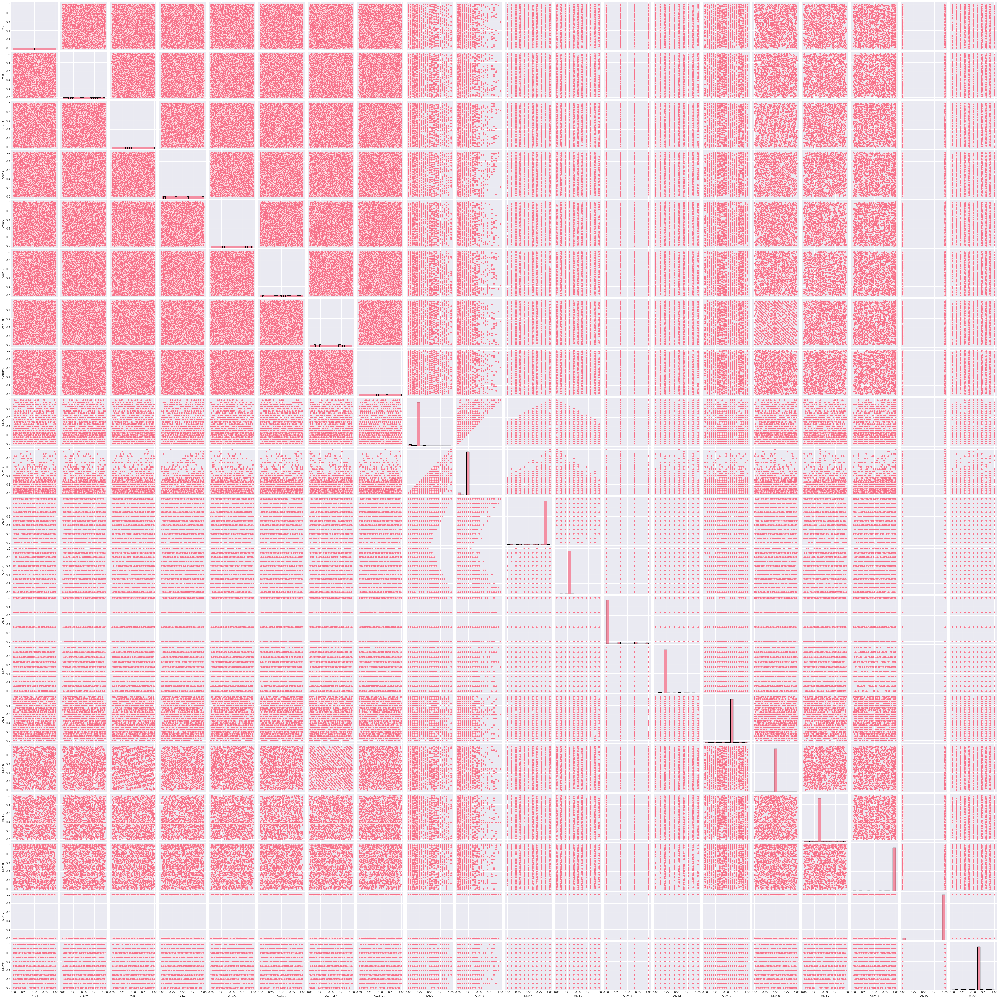

In [11]:
# Additional Pairplot of the Parameters
with plt.rc_context({'axes.labelsize': 12}):
    g = sns.pairplot(df.loc[:, 'ZSK1':'MR20'], diag_kind='hist')
g.savefig('figs/Pairplot_features.png', dpi=300, bbox_inches='tight')
plt.show()

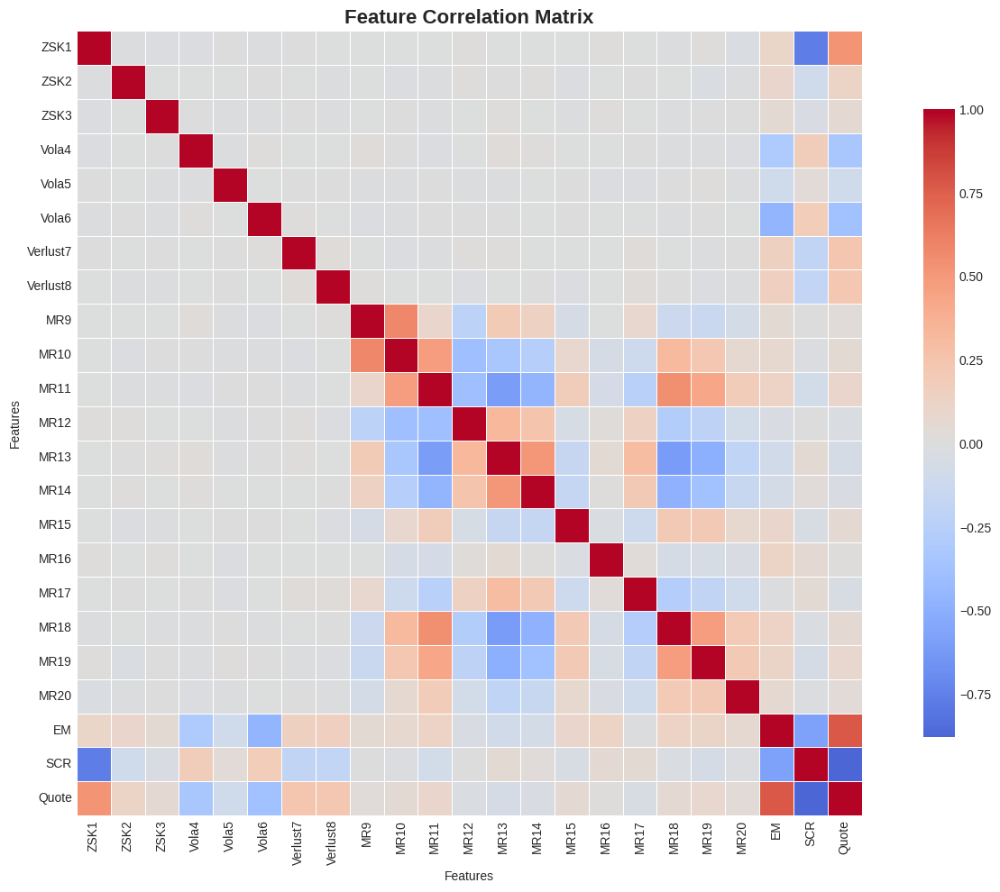

In [12]:
# Correlation matrix heatmap for all features
plt.figure(figsize=(14, 10))
correlation_matrix = df.corr()
sns.heatmap(correlation_matrix, cmap='coolwarm', center=0,
            square=True, linewidths=0.5, cbar_kws={"shrink": 0.8})
plt.title('Feature Correlation Matrix', fontsize=16, fontweight='bold')
plt.xlabel('Features')
plt.ylabel('Features')
plt.tight_layout()
plt.show()

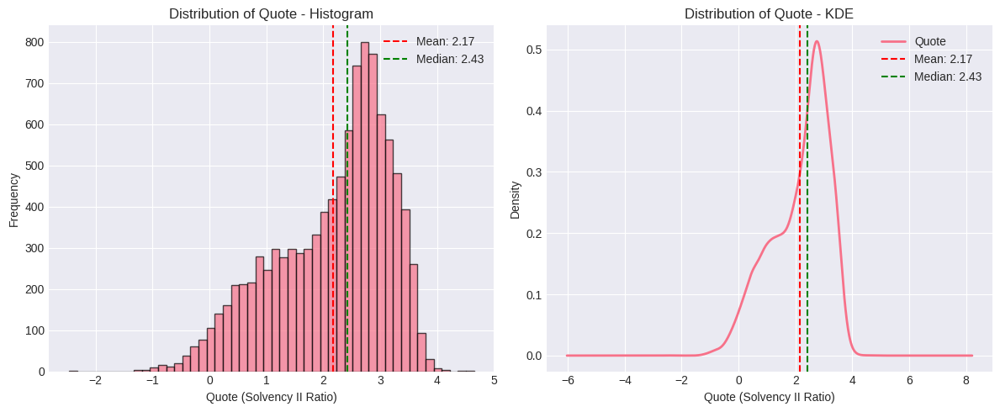

In [13]:
# Histogram/KDE of Quote
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.hist(df['Quote'], bins=50, edgecolor='black', alpha=0.7)
plt.xlabel('Quote (Solvency II Ratio)')
plt.ylabel('Frequency')
plt.title('Distribution of Quote - Histogram')
plt.axvline(df['Quote'].mean(), color='red', linestyle='--', label=f'Mean: {df["Quote"].mean():.2f}')
plt.axvline(df['Quote'].median(), color='green', linestyle='--', label=f'Median: {df["Quote"].median():.2f}')
plt.legend()

plt.subplot(1, 2, 2)
df['Quote'].plot(kind='kde', linewidth=2)
plt.xlabel('Quote (Solvency II Ratio)')
plt.ylabel('Density')
plt.title('Distribution of Quote - KDE')
plt.axvline(df['Quote'].mean(), color='red', linestyle='--', label=f'Mean: {df["Quote"].mean():.2f}')
plt.axvline(df['Quote'].median(), color='green', linestyle='--', label=f'Median: {df["Quote"].median():.2f}')
plt.legend()

plt.tight_layout()
plt.show()

In [14]:
# Risk type groupings for features
risk_groups = {
    'Interest Rate': ['ZSK1', 'ZSK2', 'ZSK3'],
    'Market Volatility': ['Vola4', 'Vola5', 'Vola6'],
    'Market Losses': ['Verlust7', 'Verlust8'],
    'FI/RE Allocation': ['MR9', 'MR10', 'MR11', 'MR12', 'MR13', 'MR14'],
    'Other Mgmt Rules': ['MR15', 'MR16', 'MR17', 'MR18', 'MR19', 'MR20']
}

print(f"\nFeature groups:")
for group_name, features in risk_groups.items():
    print(f"{group_name}: {', '.join(features)}")



Feature groups:
Interest Rate: ZSK1, ZSK2, ZSK3
Market Volatility: Vola4, Vola5, Vola6
Market Losses: Verlust7, Verlust8
FI/RE Allocation: MR9, MR10, MR11, MR12, MR13, MR14
Other Mgmt Rules: MR15, MR16, MR17, MR18, MR19, MR20


Original dataset size: 10230

Creating target distribution analysis (including outliers)
Creating distribution plots for Quote...
Creating distribution plots for EM...
Creating distribution plots for SCR...

Creating ordered plot to identify outliers...


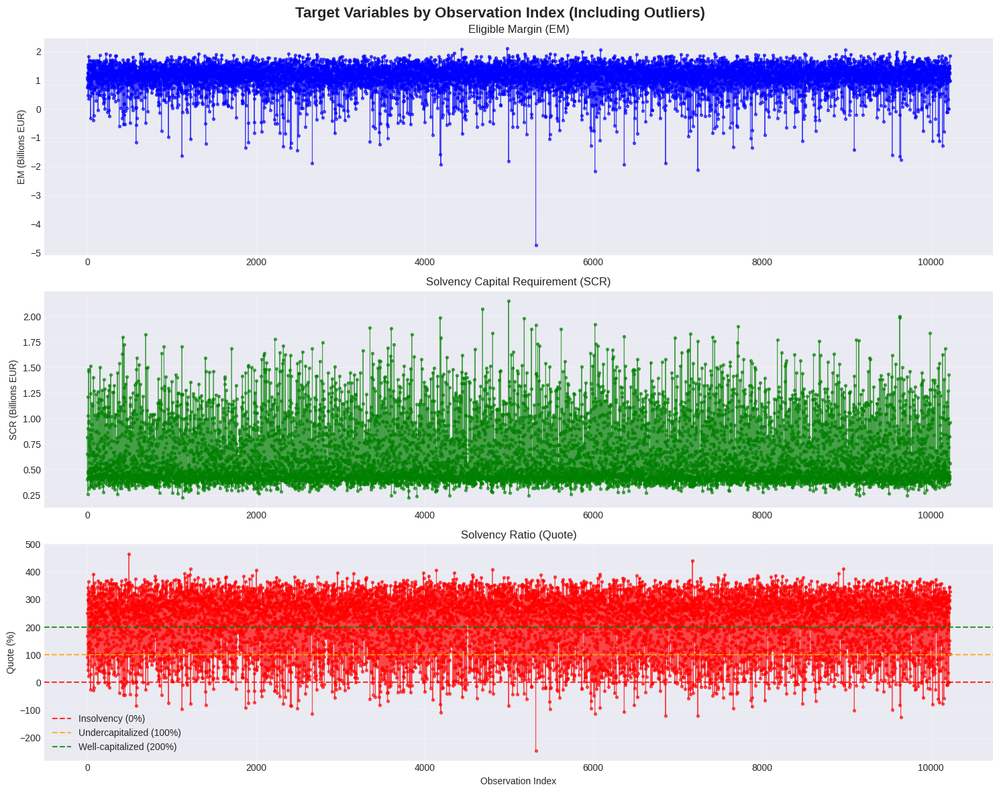


Outlier identification:
Found 1 outlier(s):
  Index 5318: EM = EUR -4.74B, Quote = -247%

Outlier removal summary:
Outliers removed: 1 observation(s)
Reason: Extreme negative EM value (< -4.5B EUR)
Clean dataset size: 10229

Updated data ranges after outlier removal:
EM range: EUR -2164M to EUR 2110M
SCR range: EUR 224M to EUR 2149M
Quote range: -126% to 465%


In [15]:
# Create ordered plot to visualize outliers before removal
original_size = len(df)
print(f"Original dataset size: {original_size}")

# Create regulatory threshold indicators (before outlier removal for complete analysis)
df['regulatory_status'] = pd.cut(df['Quote'],
                                bins=[-np.inf, 0, 1, 2, np.inf],
                                labels=['Insolvent', 'Undercapitalized', 'Adequate', 'Well-Capitalized'])

df['is_insolvent'] = (df['Quote'] < 0).astype(int)
df['is_undercapitalized'] = (df['Quote'] < 1).astype(int)
df['is_well_capitalized'] = (df['Quote'] > 2).astype(int)

# Create distribution analysis plots BEFORE removing outliers
print(f"\nCreating target distribution analysis (including outliers)")
os.makedirs("figs", exist_ok=True)

for target in ['Quote', 'EM', 'SCR']:
    print(f"Creating distribution plots for {target}...")
    fig_with_outliers = plot_distribution_analysis(df, target)
    fig_path_with_outliers = os.path.join("figs", f"distribution_analysis_{target.lower()}_with_outliers.png")
    fig_with_outliers.savefig(fig_path_with_outliers, dpi=300, bbox_inches='tight')
    # plt.show()
    plt.close(fig_with_outliers)

# Create the ordered plot
print(f"\nCreating ordered plot to identify outliers...")
fig, axes = plt.subplots(3, 1, figsize=(15, 12))
fig.suptitle('Target Variables by Observation Index (Including Outliers)', fontsize=16, fontweight='bold')

# Plot EM
axes[0].plot(df.index, df['EM']/1e9, 'b-', alpha=0.7, linewidth=0.8)
axes[0].scatter(df.index, df['EM']/1e9, s=8, alpha=0.6, color='blue')
axes[0].set_ylabel('EM (Billions EUR)')
axes[0].set_title('Eligible Margin (EM)')
axes[0].grid(True, alpha=0.3)

# Plot SCR
axes[1].plot(df.index, df['SCR']/1e9, 'g-', alpha=0.7, linewidth=0.8)
axes[1].scatter(df.index, df['SCR']/1e9, s=8, alpha=0.6, color='green')
axes[1].set_ylabel('SCR (Billions EUR)')
axes[1].set_title('Solvency Capital Requirement (SCR)')
axes[1].grid(True, alpha=0.3)

# Plot Quote as percentage
axes[2].plot(df.index, df['Quote']*100, 'r-', alpha=0.7, linewidth=0.8)
axes[2].scatter(df.index, df['Quote']*100, s=8, alpha=0.6, color='red')
axes[2].set_ylabel('Quote (%)')
axes[2].set_title('Solvency Ratio (Quote)')
axes[2].set_xlabel('Observation Index')
axes[2].grid(True, alpha=0.3)

# Add horizontal lines for regulatory thresholds on Quote plot
axes[2].axhline(y=0, color='red', linestyle='--', alpha=0.8, label='Insolvency (0%)')
axes[2].axhline(y=100, color='orange', linestyle='--', alpha=0.8, label='Undercapitalized (100%)')
axes[2].axhline(y=200, color='green', linestyle='--', alpha=0.8, label='Well-capitalized (200%)')
axes[2].legend()

plt.tight_layout()
fig.savefig('figs/ordered_plot_with_outliers.png', dpi=300, bbox_inches='tight')
plt.show()
plt.close(fig)

# Identify the specific outlier
outlier_threshold = -4.5e9  # -4.5 billion EUR threshold to catch the -4.74b outlier
outlier_mask = df['EM'] < outlier_threshold

print(f"\nOutlier identification:")
if outlier_mask.any():
    outlier_data = df[outlier_mask]
    print(f"Found {outlier_mask.sum()} outlier(s):")
    for idx, row in outlier_data.iterrows():
        print(f"  Index {idx}: EM = EUR {row['EM']/1e9:.2f}B, Quote = {row['Quote']*100:.0f}%")
else:
    print("No outliers found with the specified threshold")

# Remove the specific outlier
df_clean = df[~outlier_mask].copy()
outliers_removed = original_size - len(df_clean)

print(f"\nOutlier removal summary:")
print(f"Outliers removed: {outliers_removed} observation(s)")
print(f"Reason: Extreme negative EM value (< -4.5B EUR)")
print(f"Clean dataset size: {len(df_clean)}")

# Update df to the cleaned version
df = df_clean

print(f"\nUpdated data ranges after outlier removal:")
print(f"EM range: EUR {df['EM'].min()/1e6:.0f}M to EUR {df['EM'].max()/1e6:.0f}M")
print(f"SCR range: EUR {df['SCR'].min()/1e6:.0f}M to EUR {df['SCR'].max()/1e6:.0f}M")
print(f"Quote range: {df['Quote'].min()*100:.0f}% to {df['Quote'].max()*100:.0f}%")

In [16]:
# Save original values for later analysis and business interpretation
df['Quote_original'] = df['Quote'].copy()
df['SCR_original'] = df['SCR'].copy()
df['EM_original'] = df['EM'].copy()

print(f"Original scale ranges (Before any normalization or splitting):")
print(f"  Quote: [{df['Quote_original'].min():.3f}, {df['Quote_original'].max():.3f}]")
print(f"  SCR: [{df['SCR_original'].min():.2e}, {df['SCR_original'].max():.2e}]")
print(f"  EM: [{df['EM_original'].min():.2e}, {df['EM_original'].max():.2e}]")

Original scale ranges (Before any normalization or splitting):
  Quote: [-1.265, 4.653]
  SCR: [2.24e+08, 2.15e+09]
  EM: [-2.16e+09, 2.11e+09]



Creating target distribution analysis...


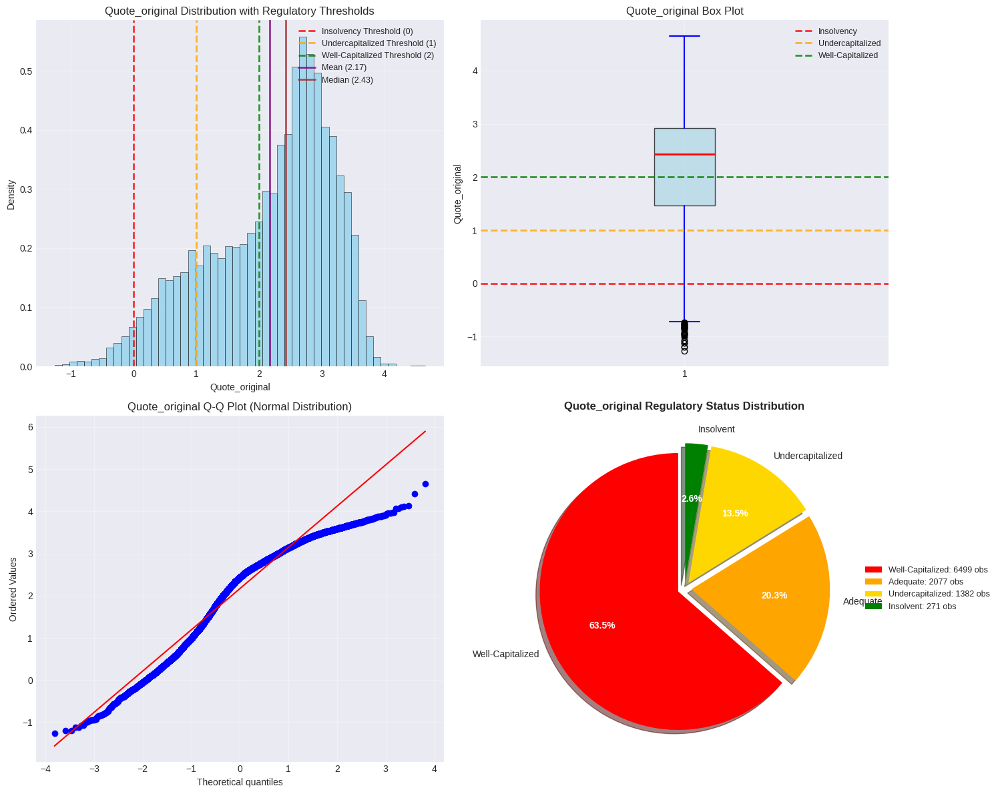

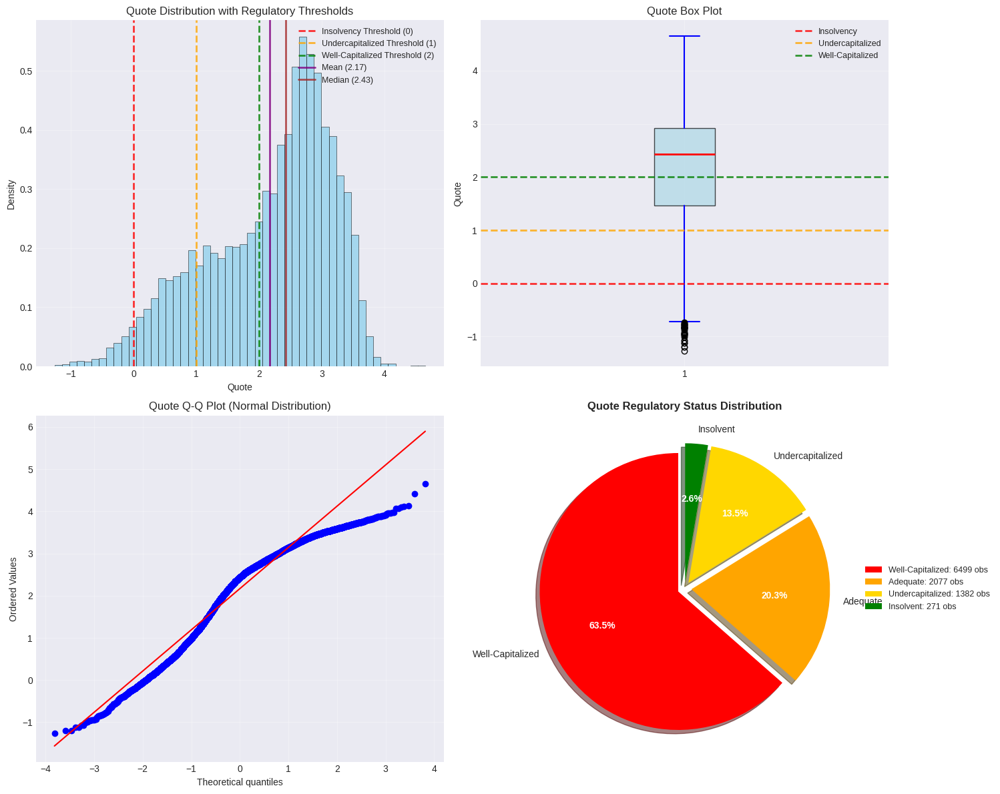

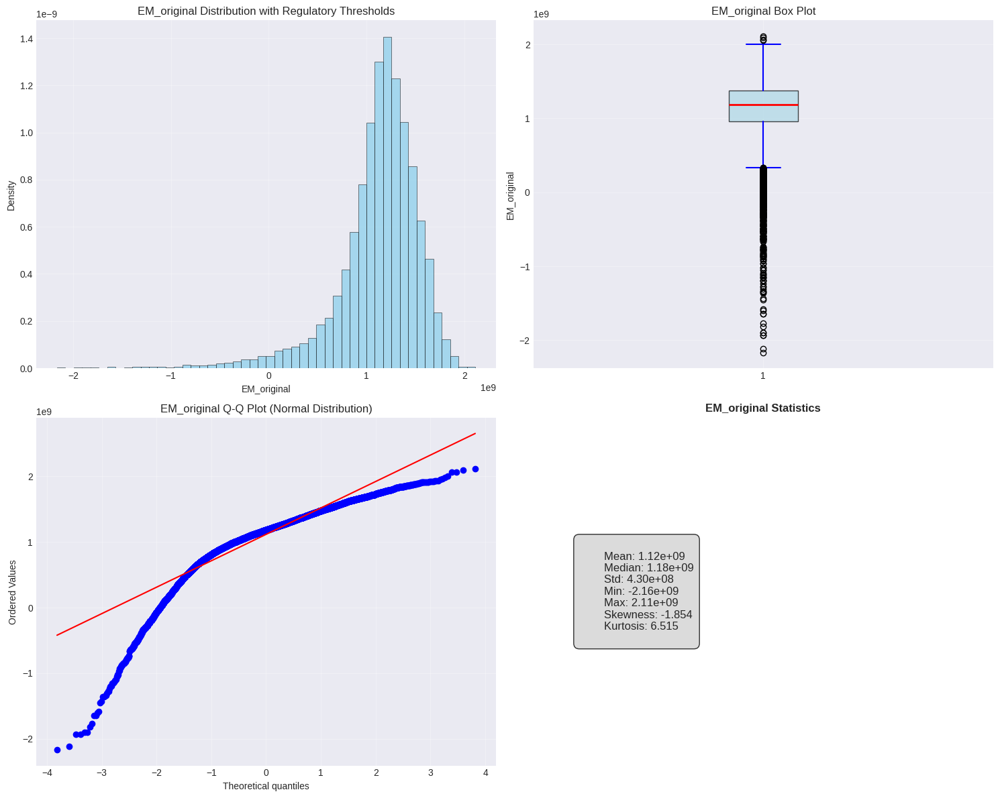

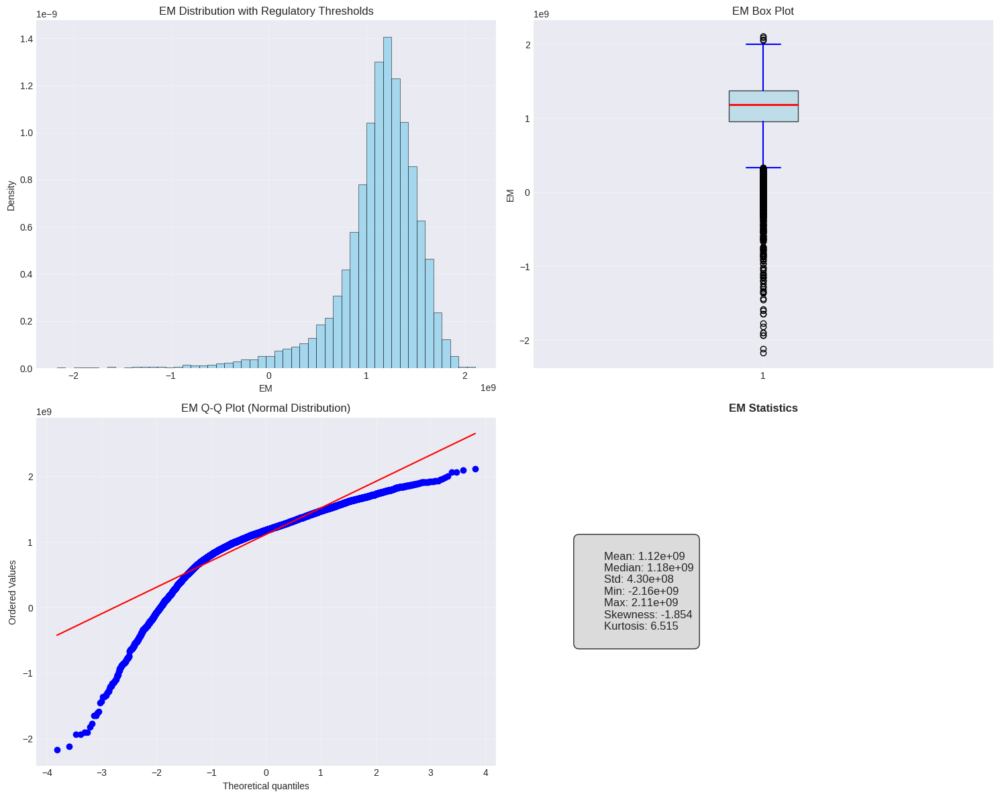

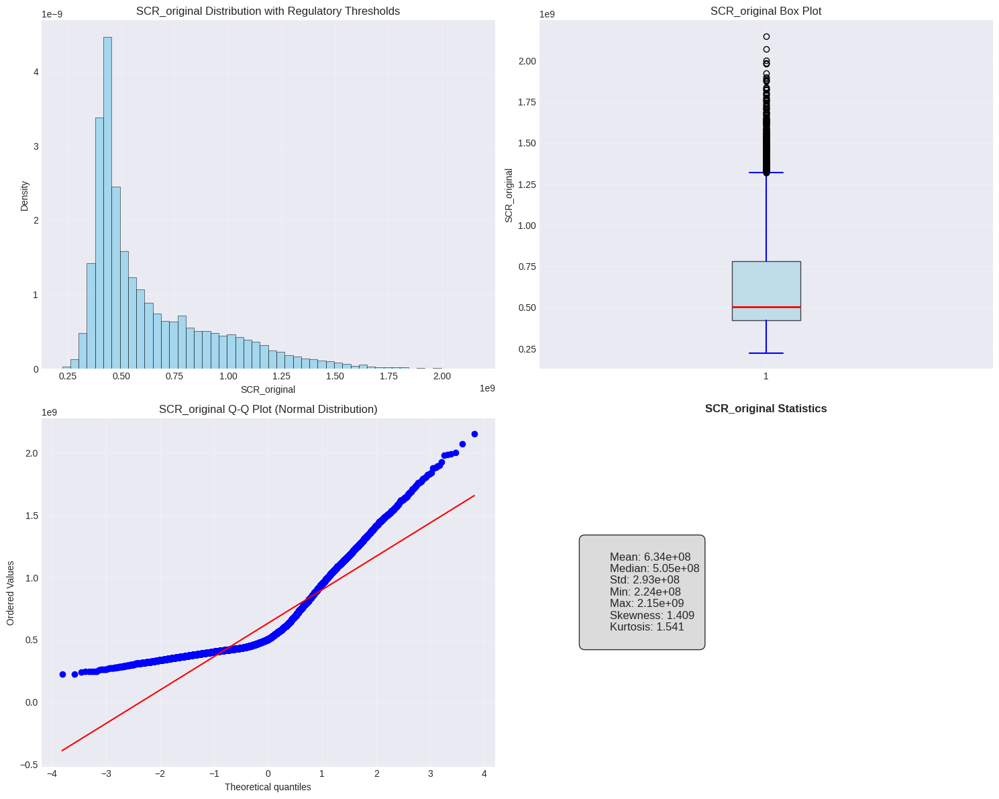

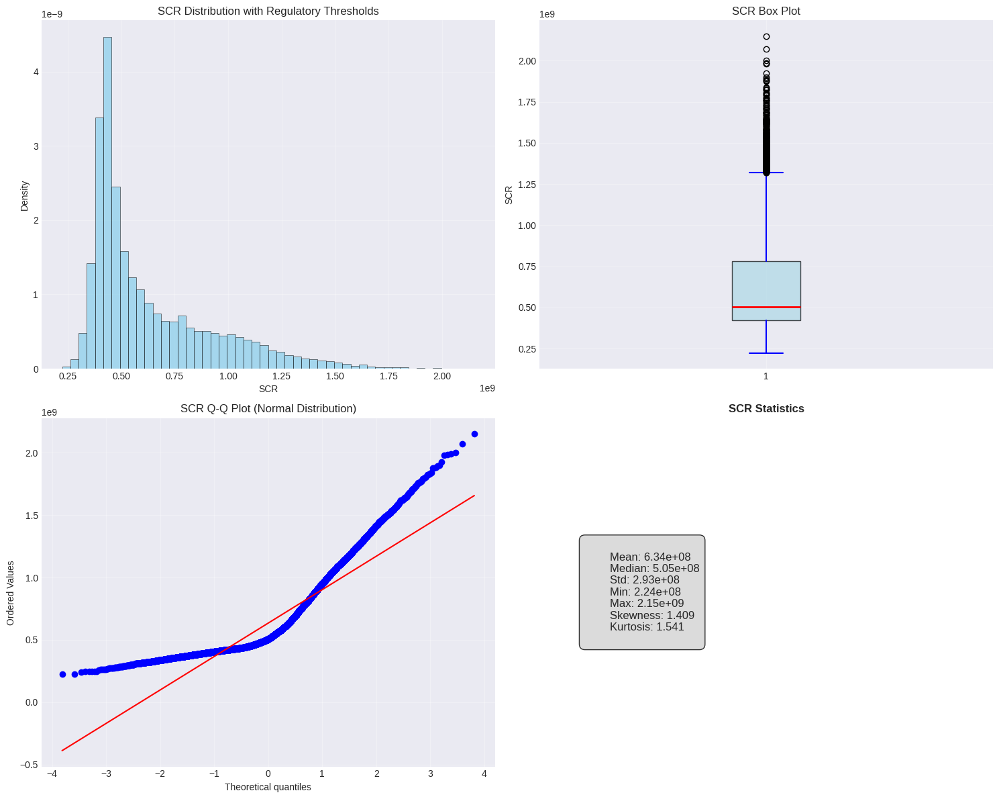

In [17]:
# Create regulatory threshold indicators for enhanced analysis
df['regulatory_status'] = pd.cut(df['Quote_original'],
                                bins=[-np.inf, 0, 1, 2, np.inf],
                                labels=['Insolvent', 'Undercapitalized', 'Adequate', 'Well-Capitalized'])

df['is_insolvent'] = (df['Quote_original'] < 0).astype(int)
df['is_undercapitalized'] = (df['Quote_original'] < 1).astype(int)
df['is_well_capitalized'] = (df['Quote_original'] > 2).astype(int)

# Create distribution analysis plots for both original and normalized versions
print(f"\nCreating target distribution analysis...")
os.makedirs("figs", exist_ok=True)

for target in ['Quote', 'EM', 'SCR']:
    # Original scale plots (using the _original columns)
    original_col = f'{target}_original'
    if original_col in df.columns:
        fig_orig = plot_distribution_analysis(df, original_col)
        fig_path_orig = os.path.join("figs", f"distribution_analysis_{target.lower()}_original.png")
        plt.savefig(fig_path_orig, dpi=300, bbox_inches='tight')
        plt.show()
        plt.close(fig_orig)

    # Normalized scale plots (using the current columns)
    fig_norm = plot_distribution_analysis(df, target)
    fig_path_norm = os.path.join("figs", f"distribution_analysis_{target.lower()}_normalized.png")
    plt.savefig(fig_path_norm, dpi=300, bbox_inches='tight')
    plt.show()
    plt.close(fig_norm)

<a id='section5'></a>
## 5. Model Development

In [18]:
# Extract features and targets
X = df[feature_cols].copy()
y_quote = df['Quote'].copy()
y_scr = df['SCR'].copy()
y_em = df['EM'].copy()
y_multi = df[['SCR', 'EM']].copy()

print(f"Features shape: {X.shape}")


# Step 1: First split (80% temp, 20% test)
X_temp, X_test, y_quote_temp, y_quote_test, y_scr_temp, y_scr_test, y_em_temp, y_em_test = train_test_split(
    X, y_quote, y_scr, y_em, test_size=0.2, random_state=RANDOM_STATE
)

# Step 2: Second split of temp data (75% train, 25% val of the 80% = 60% train, 20% val overall)
X_train, X_val, y_quote_train, y_quote_val, y_scr_train, y_scr_val, y_em_train, y_em_val = train_test_split(
    X_temp, y_quote_temp, y_scr_temp, y_em_temp, test_size=0.25, random_state=RANDOM_STATE
)

# Create multi-output targets from the correctly split data
y_multi_train = pd.DataFrame({'SCR': y_scr_train, 'EM': y_em_train}, index=y_scr_train.index)
y_multi_val = pd.DataFrame({'SCR': y_scr_val, 'EM': y_em_val}, index=y_scr_val.index)
y_multi_test = pd.DataFrame({'SCR': y_scr_test, 'EM': y_em_test}, index=y_scr_test.index)

print(f"\nData splits:")
print(f"Train: {X_train.shape[0]} samples ({X_train.shape[0]/len(df)*100:.1f}%)")
print(f"Validation: {X_val.shape[0]} samples ({X_val.shape[0]/len(df)*100:.1f}%)")
print(f"Test: {X_test.shape[0]} samples ({X_test.shape[0]/len(df)*100:.1f}%)")


print(f"\nAlignment verification:")
print(f"X_train index range: {X_train.index.min()} - {X_train.index.max()}")
print(f"y_scr_train index range: {y_scr_train.index.min()} - {y_scr_train.index.max()}")
print(f"y_em_train index range: {y_em_train.index.min()} - {y_em_train.index.max()}")
print(f"Indices match: {X_train.index.equals(y_scr_train.index) and X_train.index.equals(y_em_train.index)}")


quote_scaler = MinMaxScaler(feature_range=(-1, 1))
scr_scaler = MinMaxScaler(feature_range=(-1, 1))
em_scaler = MinMaxScaler(feature_range=(-1, 1))

# Fit on training data only
quote_scaler.fit(y_quote_train.values.reshape(-1, 1))
scr_scaler.fit(y_scr_train.values.reshape(-1, 1))
em_scaler.fit(y_em_train.values.reshape(-1, 1))

# Store scalers for later use
target_scalers = {
    'quote': quote_scaler,
    'scr': scr_scaler,
    'em': em_scaler
}

# Transform Quote
y_quote_train = pd.Series(quote_scaler.transform(y_quote_train.values.reshape(-1, 1)).ravel(),
                        index=y_quote_train.index)
y_quote_val = pd.Series(quote_scaler.transform(y_quote_val.values.reshape(-1, 1)).ravel(),
                    index=y_quote_val.index)
y_quote_test = pd.Series(quote_scaler.transform(y_quote_test.values.reshape(-1, 1)).ravel(),
                        index=y_quote_test.index)

# Transform SCR
y_scr_train = pd.Series(scr_scaler.transform(y_scr_train.values.reshape(-1, 1)).ravel(),
                    index=y_scr_train.index)
y_scr_val = pd.Series(scr_scaler.transform(y_scr_val.values.reshape(-1, 1)).ravel(),
                    index=y_scr_val.index)
y_scr_test = pd.Series(scr_scaler.transform(y_scr_test.values.reshape(-1, 1)).ravel(),
                    index=y_scr_test.index)

# Transform EM
y_em_train = pd.Series(em_scaler.transform(y_em_train.values.reshape(-1, 1)).ravel(),
                    index=y_em_train.index)
y_em_val = pd.Series(em_scaler.transform(y_em_val.values.reshape(-1, 1)).ravel(),
                    index=y_em_val.index)
y_em_test = pd.Series(em_scaler.transform(y_em_test.values.reshape(-1, 1)).ravel(),
                    index=y_em_test.index)

# Transform multi-output targets
y_multi_train = pd.DataFrame({
    'SCR': y_scr_train,
    'EM': y_em_train
}, index=y_scr_train.index)

y_multi_val = pd.DataFrame({
    'SCR': y_scr_val,
    'EM': y_em_val
}, index=y_scr_val.index)

y_multi_test = pd.DataFrame({
    'SCR': y_scr_test,
    'EM': y_em_test
}, index=y_scr_test.index)

print(f"\nNormalization verification:")
print(f"Quote normalized range: [{y_quote_train.min():.3f}, {y_quote_train.max():.3f}] (train)")
print(f"SCR normalized range: [{y_scr_train.min():.3f}, {y_scr_train.max():.3f}] (train)")
print(f"EM normalized range: [{y_em_train.min():.3f}, {y_em_train.max():.3f}] (train)")

print(f"Quote test range: [{y_quote_test.min():.3f}, {y_quote_test.max():.3f}]")
print(f"SCR test range: [{y_scr_test.min():.3f}, {y_scr_test.max():.3f}]")
print(f"EM test range: [{y_em_test.min():.3f}, {y_em_test.max():.3f}]")

# Final verification that all splits are correctly aligned
print(f"\nFinal alignment verification:")
train_alignment = (X_train.index.equals(y_quote_train.index) and
                X_train.index.equals(y_scr_train.index) and
                X_train.index.equals(y_em_train.index))
val_alignment = (X_val.index.equals(y_quote_val.index) and
                X_val.index.equals(y_scr_val.index) and
                X_val.index.equals(y_em_val.index))
test_alignment = (X_test.index.equals(y_quote_test.index) and
                X_test.index.equals(y_scr_test.index) and
                X_test.index.equals(y_em_test.index))

print(f"Train splits aligned: {train_alignment}")
print(f"Validation splits aligned: {val_alignment}")
print(f"Test splits aligned: {test_alignment}")

if all([train_alignment, val_alignment, test_alignment]):
    print("Correct")
else:
    print("Error")

# Create feature preprocessing pipeline
numeric_features = feature_cols
preprocessor = ColumnTransformer([
    ('num', Pipeline([
        ('imputer', SimpleImputer(strategy='median')),
        ('scaler', StandardScaler())
    ]), numeric_features)
])
print(f"\nPreprocessing pipeline created with {len(numeric_features)} numeric features")

Features shape: (10229, 20)

Data splits:
Train: 6137 samples (60.0%)
Validation: 2046 samples (20.0%)
Test: 2046 samples (20.0%)

Alignment verification:
X_train index range: 0 - 10229
y_scr_train index range: 0 - 10229
y_em_train index range: 0 - 10229
Indices match: True

Normalization verification:
Quote normalized range: [-1.000, 1.000] (train)
SCR normalized range: [-1.000, 1.000] (train)
EM normalized range: [-1.000, 1.000] (train)
Quote test range: [-0.953, 0.731]
SCR test range: [-1.000, 1.085]
EM test range: [-0.873, 1.016]

Final alignment verification:
Train splits aligned: True
Validation splits aligned: True
Test splits aligned: True
Correct

Preprocessing pipeline created with 20 numeric features


In [19]:
# Models with different complexity levels and loss functions
models_config = {
    'dummy': {
        'name': 'Dummy Regressor',
        'model': DummyRegressor(strategy='mean'),
        'loss': 'MSE'
    },
    'linear_mse': {
        'name': 'Linear Regression (MSE)(1-dim)',
        'model': LinearRegression(),
        'loss': 'MSE'
    },
    'quadratic': {
    'name': 'Quadratic (Degree 2)(1-dim)',
    'model': Pipeline([
        ('poly', PolynomialFeatures(degree=2, include_bias=False)),
        ('ridge', Ridge(alpha=100.0, random_state=RANDOM_STATE))
    ]),
    'loss': 'MSE'
    },
    'cubic': {
        'name': 'Cubic (Degree 3)(1-dim)',
        'model': Pipeline([
            ('poly', PolynomialFeatures(degree=3, include_bias=False)),
            ('ridge', Ridge(alpha=1000.0, random_state=RANDOM_STATE))
        ]),
        'loss': 'MSE'
    },
    'elastic_net': {
    'name': 'Elastic Net (1-dim)',
    'model': ElasticNet(random_state=RANDOM_STATE),
    'loss': 'MSE',
    'param_grid': {
        'alpha': [0.001, 0.01, 0.1, 1.0, 10.0, 100.0],  # Wider range
        'l1_ratio': [0.01, 0.1, 0.3, 0.5, 0.7, 0.9, 0.99]  # More options
        }
    },
    'ridge_cv': {
        'name': 'Ridge with CV (1-dim)',
        'model': RidgeCV(alphas=[0.1, 1.0, 10.0, 100.0, 1000.0], cv=5),
        'loss': 'MSE'
    },
    'lasso_cv': {
        'name': 'Lasso with CV (1-dim)',
        'model': LassoCV(alphas=[0.001, 0.01, 0.1, 1.0, 10.0], cv=5, random_state=RANDOM_STATE),
        'loss': 'MSE'
    }
}

print(f"Defined {len(models_config)} model configurations:")
for key, config in models_config.items():
    print(f"  - {config['name']} (Loss: {config['loss']})")


Defined 7 model configurations:
  - Dummy Regressor (Loss: MSE)
  - Linear Regression (MSE)(1-dim) (Loss: MSE)
  - Quadratic (Degree 2)(1-dim) (Loss: MSE)
  - Cubic (Degree 3)(1-dim) (Loss: MSE)
  - Elastic Net (1-dim) (Loss: MSE)
  - Ridge with CV (1-dim) (Loss: MSE)
  - Lasso with CV (1-dim) (Loss: MSE)


In [20]:
# MLPRegressor from Scikit-Learn:
models_config.update({
    'nn_mlp': {
        'name': 'Neural Net (MLPRegressor)(1-/2+1-dim)',
        'model': MLPRegressor(hidden_layer_sizes=(64,32),
                            activation='tanh',
                            solver='adam',
                            max_iter=500,
                            early_stopping=True,
                            validation_fraction=0.1,
                            n_iter_no_change=20,
                            random_state=RANDOM_STATE),
        'loss': 'MSE',
        'param_grid': {
            'hidden_layer_sizes': [(128, 64), (256, 128), (128,64,32)],
            'alpha': [1e-5, 1e-4, 1e-3],
            'learning_rate_init': [1e-3, 5e-4],
            'activation': ['relu', 'tanh']
    },
    'search_type': 'random',  # Use RandomizedSearchCV for efficiency
    'n_iter': 10,  # Number of parameter settings that are sampled}
    'multi_output': True,  # Indicate that this is also for multi-output regression
    'single_output': True  # Indicate that this is for single-output regression
}})

In [21]:
# PyTorch MLP with Dropout and BatchNorm
class TorchMLPReg(nn.Module):
    def __init__ (self, hidden_sizes=(64, 32), dropout=0.2, batchnorm=True, out_features=1):
        super().__init__()
        layers = []

        layers += [nn.LazyLinear(hidden_sizes[0])]
        if batchnorm:
            layers += [nn.BatchNorm1d(hidden_sizes[0])]
        layers += [nn.ReLU(), nn.Dropout(dropout)]

        for in_h, out_h in zip(hidden_sizes[:-1], hidden_sizes[1:]):
            layers += [nn.Linear(in_h, out_h)]
            if batchnorm:
                layers += [nn.BatchNorm1d(out_h)]
            layers += [nn.ReLU(), nn.Dropout(dropout)]

        layers += [nn.Linear(hidden_sizes[-1], out_features)]
        self.net = nn.Sequential(*layers)

    def forward(self, X):
        out= self.net(X.float())
        return out

# Multi-output regression 2 hidden layers
nn_torch_dropout_multi = NeuralNetRegressor(
    module=TorchMLPReg,
    module__hidden_sizes=(128,64),
    module__dropout=0.3,
    module__batchnorm=True,
    module__out_features=2,
    optimizer=torch.optim.AdamW,
    optimizer__lr=1e-3,
    optimizer__weight_decay=1e-3,
    criterion=nn.MSELoss,
    max_epochs=300,
    batch_size=256,verbose=0)

models_config.update({
    'nn_torch_dropout_multi': {
        'name': 'Neural Net (PyTorch MLP)(2+1 dim)',
        'model': nn_torch_dropout_multi,
        'loss': 'MSE',
        'multi_output': True,  # Indicate that this is also for multi-output regression
        'single_output': False
    }
})

print(f"Defined {len(models_config)} model configurations:")
for key, config in models_config.items():
    print(f"  - {config['name']} (Loss: {config['loss']})")


Defined 9 model configurations:
  - Dummy Regressor (Loss: MSE)
  - Linear Regression (MSE)(1-dim) (Loss: MSE)
  - Quadratic (Degree 2)(1-dim) (Loss: MSE)
  - Cubic (Degree 3)(1-dim) (Loss: MSE)
  - Elastic Net (1-dim) (Loss: MSE)
  - Ridge with CV (1-dim) (Loss: MSE)
  - Lasso with CV (1-dim) (Loss: MSE)
  - Neural Net (MLPRegressor)(1-/2+1-dim) (Loss: MSE)
  - Neural Net (PyTorch MLP)(2+1 dim) (Loss: MSE)


In [22]:
def train_and_evaluate_model(model_config, X_train, X_val, X_test, y_train, y_val, y_test,
                                preprocessor, target_name, cv_folds=5):
    """Train and evaluate a single model with comprehensive metrics"""

    model_name = model_config['name']
    base_model = copy.deepcopy(model_config['model'])

    print(f"\nTraining {model_name} for {target_name}...")


    if 'param_grid' in model_config:
        pipeline = Pipeline([
            ('preprocessor', copy.deepcopy(preprocessor)),
            ('to_float32', to_float32),          # Ensure float32 for PyTorch
            ('model', base_model)
        ])

        param_grid = {f'model__{k}': v for k, v in model_config['param_grid'].items()}

        if model_config.get('search_type', 'grid') == 'random':
            search = RandomizedSearchCV(
                pipeline, param_grid, n_iter=model_config.get('n_iter', 10),
                cv=cv_folds, scoring='neg_mean_squared_error', n_jobs=-1, random_state=RANDOM_STATE, error_score='raise'
            )
        else:
            search = GridSearchCV(
                pipeline, param_grid,
                cv=cv_folds, scoring='neg_mean_squared_error', n_jobs=-1, error_score='raise'
            )

        search.fit(X_train, y_train)
        final_model = search.best_estimator_
        print(f"  Best parameters: {search.best_params_}")

    else:
        final_model = Pipeline([
            ('preprocessor', copy.deepcopy(preprocessor)),
            ('to_float32', to_float32),          # Ensure float32 for PyTorch
            ('model', base_model)
        ])
        final_model.fit(X_train, y_train)

    # Cross-validation and predictions
    cv_scores = cross_val_score(final_model, X_train, y_train,
                            cv=cv_folds, scoring='neg_mean_squared_error')
    cv_rmse = np.sqrt(-cv_scores)

    y_train_pred = final_model.predict(X_train)
    y_val_pred = final_model.predict(X_val)
    y_test_pred = final_model.predict(X_test)

    # Calculate normalized metrics
    train_metrics_norm = calculate_all_metrics(y_train, y_train_pred, "train_norm_")
    val_metrics_norm = calculate_all_metrics(y_val, y_val_pred, "val_norm_")
    test_metrics_norm = calculate_all_metrics(y_test, y_test_pred, "test_norm_")

    all_metrics = {
        **train_metrics_norm,
        **val_metrics_norm,
        **test_metrics_norm,
        'cv_rmse_mean': cv_rmse.mean(),
        'cv_rmse_std': cv_rmse.std()
    }

    # Convert to original scale for business interpretation
    if target_name in ['Quote', 'SCR', 'EM']:
        scaler_key = target_name.lower()
        if scaler_key in target_scalers:
            target_scaler = target_scalers[scaler_key]

            # Convert predictions to original scale
            y_train_pred_orig = target_scaler.inverse_transform(np.array(y_train_pred).reshape(-1, 1)).ravel()
            y_val_pred_orig = target_scaler.inverse_transform(np.array(y_val_pred).reshape(-1, 1)).ravel()
            y_test_pred_orig = target_scaler.inverse_transform(np.array(y_test_pred).reshape(-1, 1)).ravel()

            y_train_orig = target_scaler.inverse_transform(np.array(y_train).reshape(-1, 1)).ravel()
            y_val_orig = target_scaler.inverse_transform(np.array(y_val).reshape(-1, 1)).ravel()
            y_test_orig = target_scaler.inverse_transform(np.array(y_test).reshape(-1, 1)).ravel()

            # Calculate original scale metrics
            train_metrics_orig = calculate_all_metrics(y_train_orig, y_train_pred_orig, "train_orig_")
            val_metrics_orig = calculate_all_metrics(y_val_orig, y_val_pred_orig, "val_orig_")
            test_metrics_orig = calculate_all_metrics(y_test_orig, y_test_pred_orig, "test_orig_")

            all_metrics.update({**train_metrics_orig, **val_metrics_orig, **test_metrics_orig})

            # Regulatory analysis for Quote
            if target_name == 'Quote':
                print(f"\n  Regulatory Performance Analysis for {model_name}:")
                val_reg_results = analyze_regulatory_performance(y_val_orig, y_val_pred_orig, f"{model_name} - Validation")
                test_reg_results = analyze_regulatory_performance(y_test_orig, y_test_pred_orig, f"{model_name} - Test")

                all_metrics['regulatory_val'] = val_reg_results
                all_metrics['regulatory_test'] = test_reg_results

                results_predictions = {
                    'train': y_train_pred_orig,
                    'val': y_val_pred_orig,
                    'test': y_test_pred_orig,
                    'train_norm': y_train_pred,
                    'val_norm': y_val_pred,
                    'test_norm': y_test_pred
                }

                results_actuals = {
                    'train': y_train_orig,
                    'val': y_val_orig,
                    'test': y_test_orig,
                    'train_norm': y_train,
                    'val_norm': y_val,
                    'test_norm': y_test
                }
            else:
                results_predictions = {
                    'train': y_train_pred_orig,
                    'val': y_val_pred_orig,
                    'test': y_test_pred_orig,
                    'train_norm': y_train_pred,
                    'val_norm': y_val_pred,
                    'test_norm': y_test_pred
                }

                results_actuals = {
                    'train': y_train_orig,
                    'val': y_val_orig,
                    'test': y_test_orig,
                    'train_norm': y_train,
                    'val_norm': y_val,
                    'test_norm': y_test
                }
        else:
            # Fallback
            results_predictions = {
                'train': y_train_pred,
                'val': y_val_pred,
                'test': y_test_pred
            }

            results_actuals = {
                'train': y_train,
                'val': y_val,
                'test': y_test
            }
    else:
        results_predictions = {
            'train': y_train_pred,
            'val': y_val_pred,
            'test': y_test_pred
        }

        results_actuals = {
            'train': y_train,
            'val': y_val,
            'test': y_test
        }

    results = {
        'model': final_model,
        'model_name': model_name,
        'target_name': target_name,
        'metrics': all_metrics,
        'predictions': results_predictions,
        'actuals': results_actuals
    }

    return results

def train_multioutput_model_consolidated(model_config, X_train, X_val, X_test, y_train, y_val, y_test,
                                    preprocessor, cv_folds=5, calculate_quote=True):
    """
    Consolidated multi-output training for SCR and EM with BOTH normalized and original scale metrics
    """

    model_name = model_config['name']
    base_model = copy.deepcopy(model_config['model'])

    print(f"\nTraining {model_name} (2+1-dim Output)...")
    # Ensure y_train is in the correct format for NeuralNetRegressor
    if isinstance(base_model, NeuralNetRegressor):
        y_train_fit =np.asarray(y_train, dtype=np.float32)
    else:
        y_train_fit = y_train
    try:
        # Create multi-output pipeline
        if isinstance(base_model, (RandomForestRegressor, GradientBoostingRegressor, MLPRegressor, NeuralNetRegressor)):    # Models that support multi-output natively
            final_model = Pipeline([
                ('preprocessor', copy.deepcopy(preprocessor)),
                ('model', base_model)
            ])
        else:
            multi_model = MultiOutputRegressor(base_model)
            final_model = Pipeline([
                ('preprocessor', copy.deepcopy(preprocessor)),
                ('model', multi_model)
            ])

        # Fit the model
        final_model.fit(X_train, y_train_fit)

        # Cross-validation scoring
        try:
            cv_scores = cross_val_score(final_model, X_train, y_train,
                                    cv=cv_folds, scoring='neg_mean_squared_error')
            cv_rmse = np.sqrt(-cv_scores)
            cv_rmse_mean = cv_rmse.mean()
            cv_rmse_std = cv_rmse.std()
        except Exception:
            cv_rmse_mean = np.nan
            cv_rmse_std = np.nan

        # Get predictions for all splits (normalized scale)
        y_train_pred = final_model.predict(X_train)  # Shape: (n_samples, 2) [SCR, EM]
        y_val_pred = final_model.predict(X_val)
        y_test_pred = final_model.predict(X_test)

        # Initialize metrics
        all_metrics = {
            'cv_rmse_mean': cv_rmse_mean,
            'cv_rmse_std': cv_rmse_std
        }
        target_names = ['SCR', 'EM']

        # Store MSE values for macro calculation (normalized)
        train_mses_norm = []
        val_mses_norm = []
        test_mses_norm = []

        # Store MSE values for macro calculation (original scale)
        train_mses_orig = []
        val_mses_orig = []
        test_mses_orig = []

        for i, target in enumerate(target_names):
            # Normalized metric
            train_metrics_norm = calculate_all_metrics(y_train.iloc[:, i], y_train_pred[:, i], f"train_{target}_norm_")
            val_metrics_norm = calculate_all_metrics(y_val.iloc[:, i], y_val_pred[:, i], f"val_{target}_norm_")
            test_metrics_norm = calculate_all_metrics(y_test.iloc[:, i], y_test_pred[:, i], f"test_{target}_norm_")
            all_metrics.update({**train_metrics_norm, **val_metrics_norm, **test_metrics_norm})

            # Store normalized MSE values
            train_mses_norm.append(train_metrics_norm[f'train_{target}_norm_MSE'])
            val_mses_norm.append(val_metrics_norm[f'val_{target}_norm_MSE'])
            test_mses_norm.append(test_metrics_norm[f'test_{target}_norm_MSE'])

            # Original metric
            target_scaler = target_scalers[target.lower()]

            # Convert normalized predictions to original scale
            train_pred_orig = target_scaler.inverse_transform(y_train_pred[:, i].reshape(-1, 1)).ravel()
            val_pred_orig = target_scaler.inverse_transform(y_val_pred[:, i].reshape(-1, 1)).ravel()
            test_pred_orig = target_scaler.inverse_transform(y_test_pred[:, i].reshape(-1, 1)).ravel()

            # Convert normalized actuals to original scale
            train_actual_orig = target_scaler.inverse_transform(y_train.iloc[:, i].values.reshape(-1, 1)).ravel()
            val_actual_orig = target_scaler.inverse_transform(y_val.iloc[:, i].values.reshape(-1, 1)).ravel()
            test_actual_orig = target_scaler.inverse_transform(y_test.iloc[:, i].values.reshape(-1, 1)).ravel()

            # Calculate original scale metrics
            train_metrics_orig = calculate_all_metrics(train_actual_orig, train_pred_orig, f"train_{target}_orig_")
            val_metrics_orig = calculate_all_metrics(val_actual_orig, val_pred_orig, f"val_{target}_orig_")
            test_metrics_orig = calculate_all_metrics(test_actual_orig, test_pred_orig, f"test_{target}_orig_")

            all_metrics.update({**train_metrics_orig, **val_metrics_orig, **test_metrics_orig})

            # Store original MSE values
            train_mses_orig.append(train_metrics_orig[f'train_{target}_orig_MSE'])
            val_mses_orig.append(val_metrics_orig[f'val_{target}_orig_MSE'])
            test_mses_orig.append(test_metrics_orig[f'test_{target}_orig_MSE'])

            # Also add standard metrics (backwards compatibility), use normalized
            all_metrics[f'train_{target}_RMSE'] = train_metrics_norm[f'train_{target}_norm_RMSE']
            all_metrics[f'val_{target}_RMSE'] = val_metrics_norm[f'val_{target}_norm_RMSE']
            all_metrics[f'test_{target}_RMSE'] = test_metrics_norm[f'test_{target}_norm_RMSE']
            all_metrics[f'train_{target}_R2'] = train_metrics_norm[f'train_{target}_norm_R2']
            all_metrics[f'val_{target}_R2'] = val_metrics_norm[f'val_{target}_norm_R2']
            all_metrics[f'test_{target}_R2'] = test_metrics_norm[f'test_{target}_norm_R2']
            all_metrics[f'train_{target}_MAE'] = train_metrics_norm[f'train_{target}_norm_MAE']
            all_metrics[f'val_{target}_MAE'] = val_metrics_norm[f'val_{target}_norm_MAE']
            all_metrics[f'test_{target}_MAE'] = test_metrics_norm[f'test_{target}_norm_MAE']

        # Calculate macro RMSE for both scales
        train_rmse_macro_norm = np.sqrt(np.mean(train_mses_norm))
        val_rmse_macro_norm = np.sqrt(np.mean(val_mses_norm))
        test_rmse_macro_norm = np.sqrt(np.mean(test_mses_norm))

        train_rmse_macro_orig = np.sqrt(np.mean(train_mses_orig))
        val_rmse_macro_orig = np.sqrt(np.mean(val_mses_orig))
        test_rmse_macro_orig = np.sqrt(np.mean(test_mses_orig))

        all_metrics.update({
            # Normalized scale macro metrics
            'train_RMSE_macro': train_rmse_macro_norm,
            'val_RMSE_macro': val_rmse_macro_norm,
            'test_RMSE_macro': test_rmse_macro_norm,

            # Original scale macro metrics
            'train_RMSE_macro_orig': train_rmse_macro_orig,
            'val_RMSE_macro_orig': val_rmse_macro_orig,
            'test_RMSE_macro_orig': test_rmse_macro_orig
        })

        # Calculate Quote from EM/SCR predictions
        if calculate_quote:
            if 'scr' in target_scalers and 'em' in target_scalers and 'quote' in target_scalers:
                scr_scaler = target_scalers['scr']
                em_scaler = target_scalers['em']
                quote_scaler = target_scalers['quote']

                # Extract normalized predictions for all splits
                scr_train_pred_norm = y_train_pred[:, 0]
                em_train_pred_norm = y_train_pred[:, 1]
                scr_val_pred_norm = y_val_pred[:, 0]
                em_val_pred_norm = y_val_pred[:, 1]
                scr_test_pred_norm = y_test_pred[:, 0]
                em_test_pred_norm = y_test_pred[:, 1]

                # Convert to original scale
                scr_train_pred_orig = scr_scaler.inverse_transform(scr_train_pred_norm.reshape(-1, 1)).ravel()
                em_train_pred_orig = em_scaler.inverse_transform(em_train_pred_norm.reshape(-1, 1)).ravel()
                scr_val_pred_orig = scr_scaler.inverse_transform(scr_val_pred_norm.reshape(-1, 1)).ravel()
                em_val_pred_orig = em_scaler.inverse_transform(em_val_pred_norm.reshape(-1, 1)).ravel()
                scr_test_pred_orig = scr_scaler.inverse_transform(scr_test_pred_norm.reshape(-1, 1)).ravel()
                em_test_pred_orig = em_scaler.inverse_transform(em_test_pred_norm.reshape(-1, 1)).ravel()

                # Calculate Quote in ORIGINAL scale
                quote_train_pred_orig = np.where(np.abs(scr_train_pred_orig) > 1e-6,
                                            em_train_pred_orig / scr_train_pred_orig, 0)
                quote_val_pred_orig = np.where(np.abs(scr_val_pred_orig) > 1e-6,
                                            em_val_pred_orig / scr_val_pred_orig, 0)
                quote_test_pred_orig = np.where(np.abs(scr_test_pred_orig) > 1e-6,
                                            em_test_pred_orig / scr_test_pred_orig, 0)

                # Convert calculated Quote back to normalized scale
                quote_train_pred_norm = quote_scaler.transform(quote_train_pred_orig.reshape(-1, 1)).ravel()
                quote_val_pred_norm = quote_scaler.transform(quote_val_pred_orig.reshape(-1, 1)).ravel()
                quote_test_pred_norm = quote_scaler.transform(quote_test_pred_orig.reshape(-1, 1)).ravel()

                # Get actual Quote values
                try:
                    quote_train_actual_norm = np.array(y_quote_train)
                    quote_val_actual_norm = np.array(y_quote_val)
                    quote_test_actual_norm = np.array(y_quote_test)

                    # Calculate Quote metrics (normalized scale)
                    quote_train_metrics = calculate_all_metrics(quote_train_actual_norm, quote_train_pred_norm, "train_Quote_")
                    quote_val_metrics = calculate_all_metrics(quote_val_actual_norm, quote_val_pred_norm, "val_Quote_")
                    quote_test_metrics = calculate_all_metrics(quote_test_actual_norm, quote_test_pred_norm, "test_Quote_")

                    # Calculate Quote metrics (original scale)
                    quote_train_actual_orig = quote_scaler.inverse_transform(quote_train_actual_norm.reshape(-1, 1)).ravel()
                    quote_val_actual_orig = quote_scaler.inverse_transform(quote_val_actual_norm.reshape(-1, 1)).ravel()
                    quote_test_actual_orig = quote_scaler.inverse_transform(quote_test_actual_norm.reshape(-1, 1)).ravel()

                    quote_train_metrics_orig = calculate_all_metrics(quote_train_actual_orig, quote_train_pred_orig, "train_Quote_orig_")
                    quote_val_metrics_orig = calculate_all_metrics(quote_val_actual_orig, quote_val_pred_orig, "val_Quote_orig_")
                    quote_test_metrics_orig = calculate_all_metrics(quote_test_actual_orig, quote_test_pred_orig, "test_Quote_orig_")

                    all_metrics.update({**quote_train_metrics, **quote_val_metrics, **quote_test_metrics})
                    all_metrics.update({**quote_train_metrics_orig, **quote_val_metrics_orig, **quote_test_metrics_orig})

                    print(f"    Quote calculation successful:")
                    print(f"    Quote Train RMSE (norm): {all_metrics['train_Quote_RMSE']:.4f}")
                    print(f"    Quote Val RMSE (norm): {all_metrics['val_Quote_RMSE']:.4f}")
                    print(f"    Quote Test RMSE (norm): {all_metrics['test_Quote_RMSE']:.4f}")
                    print(f"    Quote Test R² (norm): {all_metrics['test_Quote_R2']:.4f}")

                except NameError:
                    print(f"  Quote target variables not available, skipping Quote calculation")
                    calculate_quote = False
            else:
                print(f"  Scalers not available, skipping Quote calculation")
                calculate_quote = False

        # Print comprehensive performance summary with BOTH scales
        print(f"    Model Performance Summary:")
        if not np.isnan(cv_rmse_mean):
            print(f"    CV RMSE: {cv_rmse_mean:.4f} (±{cv_rmse_std:.4f})")

        print(f"    SCR Performance:")
        print(f"      Train RMSE (norm): {all_metrics['train_SCR_norm_RMSE']:.4f}")
        print(f"      Val RMSE (norm):   {all_metrics['val_SCR_norm_RMSE']:.4f}")
        print(f"      Test RMSE (norm):  {all_metrics['test_SCR_norm_RMSE']:.4f}")
        print(f"      Train RMSE (orig): {all_metrics['train_SCR_orig_RMSE']:.2e}")
        print(f"      Val RMSE (orig):   {all_metrics['val_SCR_orig_RMSE']:.2e}")
        print(f"      Test RMSE (orig):  {all_metrics['test_SCR_orig_RMSE']:.2e}")

        print(f"    EM Performance:")
        print(f"      Train RMSE (norm): {all_metrics['train_EM_norm_RMSE']:.4f}")
        print(f"      Val RMSE (norm):   {all_metrics['val_EM_norm_RMSE']:.4f}")
        print(f"      Test RMSE (norm):  {all_metrics['test_EM_norm_RMSE']:.4f}")
        print(f"      Train RMSE (orig): {all_metrics['train_EM_orig_RMSE']:.2e}")
        print(f"      Val RMSE (orig):   {all_metrics['val_EM_orig_RMSE']:.2e}")
        print(f"      Test RMSE (orig):  {all_metrics['test_EM_orig_RMSE']:.2e}")

        print(f"    Combined Performance:")
        print(f"      Train RMSE (norm): {train_rmse_macro_norm:.4f}")
        print(f"      Val RMSE (norm):   {val_rmse_macro_norm:.4f}")
        print(f"      Test RMSE (norm):  {test_rmse_macro_norm:.4f}")
        print(f"      Train RMSE (orig): {train_rmse_macro_orig:.2e}")
        print(f"      Val RMSE (orig):   {val_rmse_macro_orig:.2e}")
        print(f"      Test RMSE (orig):  {test_rmse_macro_orig:.2e}")

        # Calculate and show overfitting gap
        train_val_gap = val_rmse_macro_norm - train_rmse_macro_norm
        if train_val_gap > 0.01:
            print(f"      Overfitting detected: Val-Train gap = {train_val_gap:.4f}")
        elif train_val_gap < -0.005:
            print(f"      Possible underfitting: Val better than Train by {abs(train_val_gap):.4f}")

        # Prepare results
        target_name = 'Joint_SCR_EM_Quote' if calculate_quote else 'SCR_EM_Multi'

        results = {
            'model': final_model,
            'model_name': model_name + (' (with Quote)' if calculate_quote else ' (Multi-Output)'),
            'target_name': target_name,
            'metrics': all_metrics,
            'predictions': {
                'train': y_train_pred,
                'val': y_val_pred,
                'test': y_test_pred
            },
            'actuals': {
                'train': y_train,
                'val': y_val,
                'test': y_test
            },
            'quote_calculated': calculate_quote
        }

        return results

    except Exception as e:
        print(f"  Error: {str(e)}")
        import traceback
        traceback.print_exc()
        return None

In [23]:
# Statistical analysis of Quote
print(f"\nQuote analysis:")
print(f"Mean: {df['Quote'].mean():.3f}, Std: {df['Quote'].std():.3f}")
print(f"Range: [{df['Quote'].min():.3f}, {df['Quote'].max():.3f}]")
print(f"Skewness: {stats.skew(df['Quote']):.3f}")
print(f"Kurtosis: {stats.kurtosis(df['Quote']):.3f}")
print(f"Observations with Quote < 1 (undercapitalized): {(df['Quote'] <= 1).sum()} ({(df['Quote'] <= 1).mean()*100:.1f}%)")
print(f"Observations with Quote > 2 (well-capitalized): {(df['Quote'] >= 2).sum()} ({(df['Quote'] >= 2).mean()*100:.1f}%)")


Quote analysis:
Mean: 2.167, Std: 1.004
Range: [-1.265, 4.653]
Skewness: -0.689
Kurtosis: -0.331
Observations with Quote < 1 (undercapitalized): 1653 (16.2%)
Observations with Quote > 2 (well-capitalized): 6499 (63.5%)


In [24]:
to_dense = FunctionTransformer(
    lambda X: X.toarray() if hasattr(X, "toarray") else X,
    accept_sparse=True
)

to_float32 = FunctionTransformer(
    lambda X: X.astype(np.float32))

In [25]:
all_results = {}

# Train models for Quote (primary target)
all_results['quote'] = {}

X_train = X_train.astype(np.float32)            #For compatibility with PyTorch
X_val = X_val.astype(np.float32)
X_test = X_test.astype(np.float32)
y_quote_train = y_quote_train.astype(np.float32)
y_quote_val = y_quote_val.astype(np.float32)
y_quote_test = y_quote_test.astype(np.float32)

for model_key, model_config in models_config.items():
    if 'multi_output' not in model_config or 'single_output' in model_config and model_config['single_output']:
        try:
            results = train_and_evaluate_model(
                model_config, X_train, X_val, X_test,
                y_quote_train, y_quote_val, y_quote_test,
                preprocessor, "Quote"
            )
            all_results['quote'][model_key] = results

            # Print summary metrics
            metrics = results['metrics']
            print(f"  {results['model_name']}:")
            print(f"    CV RMSE: {metrics['cv_rmse_mean']:.4f} (±{metrics['cv_rmse_std']:.4f})")
            print(f"    Val RMSE (Norm): {metrics['val_norm_RMSE']:.4f}")
            print(f"    Val RMSE (Orig): {metrics['val_orig_RMSE']:.2e}")
            print(f"    Test RMSE (Norm): {metrics['test_norm_RMSE']:.4f}")
            print(f"    Test RMSE (Orig): {metrics['test_orig_RMSE']:.2e}")

        except Exception as e:
            print(f"  Error training {model_config['name']}: {str(e)}")

# Train models for SCR (secondary target)
all_results['scr'] = {}

for model_key, model_config in models_config.items():
    if 'multi_output' not in model_config or 'single_output' in model_config and model_config['single_output']:
        try:
            results = train_and_evaluate_model(
                model_config, X_train, X_val, X_test,
                y_scr_train, y_scr_val, y_scr_test,
                preprocessor, "SCR"
            )
            all_results['scr'][model_key] = results

            # Print summary metrics
            metrics = results['metrics']
            print(f"  {results['model_name']}:")
            print(f"    CV RMSE: {metrics['cv_rmse_mean']:.4f} (±{metrics['cv_rmse_std']:.4f})")
            print(f"    Val RMSE (Norm): {metrics['val_norm_RMSE']:.4f}")
            print(f"    Val RMSE (Orig): {metrics['val_orig_RMSE']:.2e}")
            print(f"    Test RMSE (Norm): {metrics['test_norm_RMSE']:.4f}")
            print(f"    Test RMSE (Orig): {metrics['test_orig_RMSE']:.2e}")

        except Exception as e:
            print(f"  Error training {model_config['name']}: {str(e)}")

# Train models for EM (secondary target)
all_results['em'] = {}

for model_key, model_config in models_config.items():
    if 'multi_output' not in model_config or 'single_output' in model_config and model_config['single_output']:
        try:
            results = train_and_evaluate_model(
                model_config, X_train, X_val, X_test,
                y_em_train, y_em_val, y_em_test,
                preprocessor, "EM"
            )
            all_results['em'][model_key] = results

            # Print summary metrics
            metrics = results['metrics']
            print(f"  {results['model_name']}:")
            print(f"    CV RMSE: {metrics['cv_rmse_mean']:.4f} (±{metrics['cv_rmse_std']:.4f})")
            print(f"    Val RMSE (Norm): {metrics['val_norm_RMSE']:.4f}")
            print(f"    Val RMSE (Orig): {metrics['val_orig_RMSE']:.2e}")
            print(f"    Test RMSE (Norm): {metrics['test_norm_RMSE']:.4f}")
            print(f"    Test RMSE (Orig): {metrics['test_orig_RMSE']:.2e}")

        except Exception as e:
            print(f"  Error training {model_config['name']}: {str(e)}")

# Train multi-output models for SCR and EM
all_results['multi_output'] = {}

for model_key, model_config in models_config.items():
    try:
        results = train_multioutput_model_consolidated(
            model_config, X_train, X_val, X_test,
            y_multi_train, y_multi_val, y_multi_test,
            preprocessor,  calculate_quote=False
        )
        all_results['multi_output'][model_key] = results

        # Multi-output metrics
        metrics = results['metrics']
        print(f"  {results['model_name']}:")
        print(f"    Val RMSE (SCR): {metrics['val_SCR_RMSE']:.4f}")
        print(f"    Val RMSE (EM): {metrics['val_EM_RMSE']:.4f}")
        print(f"    Val RMSE (Macro): {metrics['val_RMSE_macro']:.4f}")

    except Exception as e:
        print(f"  Error training 2+1-dim output {model_config['name']}: {str(e)}")


Training Dummy Regressor for Quote...

  Regulatory Performance Analysis for Dummy Regressor:

Regulatory performance analysis - Dummy Regressor - Validation

Insolvent (59 obs, 2.9%):
  RMSE: 2.4923
  MAE: 2.4779
  R²: -85.8717

Undercapitalized (273 obs, 13.3%):
  RMSE: 1.6119
  MAE: 1.5884
  R²: -33.5071

Adequate (403 obs, 19.7%):
  RMSE: 0.6965
  MAE: 0.6333
  R²: -4.7761

Well-Capitalized (1311 obs, 64.1%):
  RMSE: 0.7929
  MAE: 0.6739
  R²: -2.3241

Regulatory performance analysis - Dummy Regressor - Test

Insolvent (54 obs, 2.6%):
  RMSE: 2.5137
  MAE: 2.4963
  R²: -71.5004

Undercapitalized (288 obs, 14.1%):
  RMSE: 1.6239
  MAE: 1.5997
  R²: -32.7544

Adequate (438 obs, 21.4%):
  RMSE: 0.7136
  MAE: 0.6513
  R²: -4.9839

Well-Capitalized (1266 obs, 61.9%):
  RMSE: 0.7860
  MAE: 0.6667
  R²: -2.2650
  Dummy Regressor:
    CV RMSE: 0.3373 (±0.0070)
    Val RMSE (Norm): 0.3420
    Val RMSE (Orig): 1.01e+00
    Test RMSE (Norm): 0.3429
    Test RMSE (Orig): 1.01e+00

Training Li

In [26]:
# make a fresh clone so search can safely clone it again
base = clone(nn_torch_dropout_multi).set_params(
    # use a built-in validation split for EarlyStopping to monitor
    train_split=ValidSplit(0.15, random_state=RANDOM_STATE),
    callbacks=[EarlyStopping(patience=10, monitor='valid_loss', lower_is_better=True)],
    batch_size=1024,
    iterator_train__num_workers=0,
    iterator_valid__num_workers=0,
)

param_dist = {
    'module__hidden_sizes': [(256, 128), (128, 64, 32)],
    'module__dropout': [0.2, 0.3, 0.4],
    'module__batchnorm': [True, False],
    'optimizer__lr': loguniform(1e-4, 1e-2),
    'optimizer__weight_decay': loguniform(1e-6, 1e-2),
    'max_epochs': [40],
}

cv3 = KFold(n_splits=3, shuffle=True, random_state=RANDOM_STATE)

rs = RandomizedSearchCV(
    base,
    param_distributions=param_dist,
    n_iter=20,
    cv=cv3,
    scoring='neg_mean_squared_error',
    n_jobs=1,
    refit=False,
    verbose=1,
    random_state=RANDOM_STATE,
)

Xtr = X_train.to_numpy()
ytr = y_multi_train.astype(np.float32).to_numpy()

rs.fit(Xtr, ytr)

best_params = {**rs.best_params_, 'max_epochs': 300}
torch_multi_tuned = clone(base).set_params(**best_params)
torch_multi_tuned.fit(Xtr, ytr)

Fitting 3 folds for each of 20 candidates, totalling 60 fits


<class 'skorch.regressor.NeuralNetRegressor'>[initialized](
  module_=TorchMLPReg(
    (net): Sequential(
      (0): Linear(in_features=20, out_features=256, bias=True)
      (1): ReLU()
      (2): Dropout(p=0.4, inplace=False)
      (3): Linear(in_features=256, out_features=128, bias=True)
      (4): ReLU()
      (5): Dropout(p=0.4, inplace=False)
      (6): Linear(in_features=128, out_features=2, bias=True)
    )
  ),
)

In [27]:
# KPI scorer: RMSE of quote = EM/SCR
def rmse_quote(y_true, y_pred, eps=1e-8, clip=None):
    # Assumes y_true and y_pred have columns [EM, SCR]
    em_t, scr_t = y_true[:, 0], y_true[:, 1]
    em_p, scr_p = y_pred[:, 0], y_pred[:, 1]
    # Guard against tiny denominators
    q_t = em_t / np.maximum(scr_t, eps)
    q_p = em_p / np.maximum(scr_p, eps)
    if clip is not None:
        q_t = np.clip(q_t, -clip, clip)
        q_p = np.clip(q_p, -clip, clip)
    return np.sqrt(mean_squared_error(q_t, q_p))

quote_rmse_scorer = make_scorer(rmse_quote, greater_is_better=False)

pipe = Pipeline([
    ('scale', StandardScaler()),
    ('mlp', MLPRegressor(
        random_state=RANDOM_STATE,
        early_stopping=True,
        validation_fraction=0.15,
        n_iter_no_change=12,
        tol=1e-3,
        learning_rate='adaptive'
    ))
])

param_dist = {
    'mlp__hidden_layer_sizes': [(128, 64), (64, 32), (256, 128, 64)],
    'mlp__activation': ['relu', 'tanh'],
    'mlp__alpha': loguniform(1e-6, 1e-2),
    'mlp__learning_rate_init': loguniform(1e-4, 1e-1)
}

cv = KFold(n_splits=3, shuffle=True, random_state=RANDOM_STATE)

halv = HalvingRandomSearchCV(
    estimator=pipe,
    param_distributions=param_dist,
    resource='mlp__max_iter',
    min_resources=50,
    max_resources=400,
    factor=3,
    aggressive_elimination=True,
    cv=cv,
    scoring=quote_rmse_scorer,
    n_jobs=-1,
    random_state=RANDOM_STATE,
    verbose=1,
    refit=True
)
halv.fit(X_train, y_multi_train.to_numpy())

print("Best params:", halv.best_params_)
best_quote_rmse_cv = -halv.best_score_
print(f"Best CV Quote RMSE: {best_quote_rmse_cv:.6f}")

mlp_multi_tuned = copy.deepcopy(halv.best_estimator_)

n_iterations: 2
n_required_iterations: 2
n_possible_iterations: 2
min_resources_: 50
max_resources_: 400
aggressive_elimination: True
factor: 3
----------
iter: 0
n_candidates: 8
n_resources: 50
Fitting 3 folds for each of 8 candidates, totalling 24 fits
----------
iter: 1
n_candidates: 3
n_resources: 150
Fitting 3 folds for each of 3 candidates, totalling 9 fits
Best params: {'mlp__activation': 'relu', 'mlp__alpha': np.float64(0.0018443575882685869), 'mlp__hidden_layer_sizes': (128, 64), 'mlp__learning_rate_init': np.float64(0.006856460830716593), 'mlp__max_iter': 150}
Best CV Quote RMSE: 3809757.126316


In [28]:
# Enhanced multi-output models configuration
enhanced_models_config = {
    'linear_multi': {
        'name': 'Linear Regression (2+1-dim)(Multi-Output)',
        'model': LinearRegression(),
        'loss': 'MSE'
    },
    'ridge_multi': {
        'name': 'Ridge Regression (2+1-dim)(Multi-Output)',
        'model': RidgeCV(alphas=[0.1, 1.0, 10.0, 100.0, 1000.0], cv=5),
        'loss': 'MSE'
    },
    'poly2_multi': {
        'name': 'Quadratic (2+1-dim)(Multi-Output)',
        'model': Pipeline([
            ('poly', PolynomialFeatures(degree=2, include_bias=False)),
            ('ridge', Ridge(alpha=100.0, random_state=RANDOM_STATE))
        ]),
        'loss': 'MSE'
    },
    'random_forest_multi': {
        'name': 'Random Forest (2+1-dim)(Multi-Output)',
        'model': RandomForestRegressor(n_estimators=50, random_state=RANDOM_STATE, n_jobs=-1),
        'loss': 'MSE'
    },
    'xgboost_basic': {
        'name': 'XGBoost Basic (2+1-dim)(Multi-Output)',
        'model': xgb.XGBRegressor(
            objective='reg:squarederror',
            n_estimators=100,
            learning_rate=0.1,
            max_depth=6,
            random_state=RANDOM_STATE,
            n_jobs=-1
        ),
        'loss': 'MSE'
    },
    'xgboost_tuned': {
        'name': 'XGBoost Tuned (2+1-dim)(Multi-Output)',
        'model': xgb.XGBRegressor(
            objective='reg:squarederror',
            n_estimators=200,
            learning_rate=0.05,
            max_depth=8,
            min_child_weight=3,
            subsample=0.8,
            colsample_bytree=0.8,
            reg_alpha=0.1,
            reg_lambda=1.0,
            random_state=RANDOM_STATE,
            n_jobs=-1
        ),
        'loss': 'MSE'
    },
    'mlp_reg_multi': {
        'name': 'MLPRegressor (2+1-dim)(Multi-Output)',
        'model': MLPRegressor(hidden_layer_sizes=(256,128,64),
                              activation='relu',
                              solver='adam',
                              max_iter=500,
                              early_stopping=True,
                              validation_fraction=0.1,
                              n_iter_no_change=20,
                              alpha=1e-5,
                              learning_rate_init=1e-3,
                              random_state=RANDOM_STATE),
        'loss': 'MSE'
    },
    'torch_nn_multi': {
        'name': 'PyTorch Neural Net (2+1-dim)(Multi-Output)',
        'model': nn_torch_dropout_multi,
        'loss': 'MSE',
    },
    'torch_nn_multi_tuned': {
        'name': 'PyTorch Neural Net Tuned (2+1-dim)(Multi-Output)',
        'model': torch_multi_tuned,
        'loss': 'MSE',
    },
    'mlp_multi_tuned': {
        'name': 'MLPRegressor Tuned (2+1-dim)(Multi-Output)',
        'model': mlp_multi_tuned,
        'loss': 'MSE',
    }
}

In [29]:
enhanced_results_fixed = {}

for model_key, model_config in enhanced_models_config.items():
    try:
        results = train_multioutput_model_consolidated(
            model_config, X_train, X_val, X_test,
            y_multi_train, y_multi_val, y_multi_test,  # [SCR, EM] targets (normalized)
            preprocessor, calculate_quote=True
        )
        if results is not None:
            enhanced_results_fixed[model_key] = results

    except Exception as e:
        print(f"  Error training {model_config['name']}: {str(e)}")

def create_fixed_joint_comparison(results_dict):
    """Create comparison table for 2+1-dim models"""
    comparison_data = []

    for model_key, results in results_dict.items():
        if results is None:
            continue

        metrics = results['metrics']
        row = {
            'Model': results['model_name'],
            'SCR_Val_RMSE': metrics.get('val_SCR_RMSE', np.nan),
            'EM_Val_RMSE': metrics.get('val_EM_RMSE', np.nan),
            'Quote_Val_RMSE_Norm': metrics.get('val_Quote_RMSE', np.nan),  # Normalized for comparison
            'Quote_Test_RMSE_Norm': metrics.get('test_Quote_RMSE', np.nan),
            'Quote_Test_R2_Norm': metrics.get('test_Quote_R2', np.nan),
            'Quote_Test_RMSE_Orig': metrics.get('test_Quote_orig_RMSE', np.nan),  # Original for business
            'Quote_Test_R2_Orig': metrics.get('test_Quote_orig_R2', np.nan)
        }
        comparison_data.append(row)

    if not comparison_data:
        print(" No successful models to compare!")
        return pd.DataFrame()

    df_comparison = pd.DataFrame(comparison_data)
    df_comparison = df_comparison.sort_values('Quote_Val_RMSE_Norm')

    print("Quote calculated in original scale then normalized for fair comparison")
    print(df_comparison.round(4).to_string(index=False))

    return df_comparison

# Create comparison table
joint_comparison_fixed = create_fixed_joint_comparison(enhanced_results_fixed)

# Find best joint model
best_joint_model_fixed = None
best_quote_rmse_fixed = float('inf')

for model_key, results in enhanced_results_fixed.items():
    if results is not None:
        quote_rmse = results['metrics'].get('val_Quote_RMSE', float('inf'))
        if quote_rmse < best_quote_rmse_fixed:
            best_quote_rmse_fixed = quote_rmse
            best_joint_model_fixed = results

if best_joint_model_fixed:
    print(f"\nBest 2+1-dim model:")
    print(f"Model: {best_joint_model_fixed['model_name']}")
    print(f"Quote Val RMSE (normalized): {best_quote_rmse_fixed:.4f}")
    print(f"Quote Test RMSE (normalized): {best_joint_model_fixed['metrics']['test_Quote_RMSE']:.4f}")
    print(f"Quote Test R² (normalized): {best_joint_model_fixed['metrics']['test_Quote_R2']:.4f}")

    best_models = {}
    # Find best Quote model from all_results
    best_quote_rmse_norm = float('inf')
    for model_key, results in all_results['quote'].items():
        if results is not None:
            val_rmse = results['metrics'].get('val_norm_RMSE', float('inf'))
            if val_rmse < best_quote_rmse_norm:
                best_quote_rmse_norm = val_rmse
                best_models['quote'] = {
                    'results': results,
                    'val_rmse_norm': val_rmse
                }
    # Compare with direct Quote prediction
    if 'quote' in best_models:
        direct_quote_rmse = best_models['quote']['val_rmse_norm']
        joint_quote_rmse_fixed = best_quote_rmse_fixed

        print(f"\nFixed approach comparison:")
        print(f"Direct Quote Prediction RMSE: {direct_quote_rmse:.4f}")
        print(f"EM/SCR → Quote RMSE: {joint_quote_rmse_fixed:.4f}")

        if joint_quote_rmse_fixed < direct_quote_rmse:
            improvement = ((direct_quote_rmse - joint_quote_rmse_fixed) / direct_quote_rmse) * 100
            print(f" 2+1-dim approach is better by {improvement:.1f}%")
        else:
            degradation = ((joint_quote_rmse_fixed - direct_quote_rmse) / direct_quote_rmse) * 100
            print(f" 2+1-dim approach is still worse by {degradation:.1f}%")

        # Analysis
        print(f"\n ANALYSIS:")
        scr_em_corr = np.corrcoef(y_multi_train.iloc[:, 0], y_multi_train.iloc[:, 1])[0, 1]
        print(f"SCR-EM correlation: {scr_em_corr:.3f}")



Training Linear Regression (2+1-dim)(Multi-Output) (2+1-dim Output)...
    Quote calculation successful:
    Quote Train RMSE (norm): 10.1861
    Quote Val RMSE (norm): 1.2852
    Quote Test RMSE (norm): 6.6602
    Quote Test R² (norm): -376.5555
    Model Performance Summary:
    CV RMSE: 0.1550 (±0.0048)
    SCR Performance:
      Train RMSE (norm): 0.1560
      Val RMSE (norm):   0.1686
      Test RMSE (norm):  0.1674
      Train RMSE (orig): 1.44e+08
      Val RMSE (orig):   1.56e+08
      Test RMSE (orig):  1.55e+08
    EM Performance:
      Train RMSE (norm): 0.1525
      Val RMSE (norm):   0.1556
      Test RMSE (norm):  0.1525
      Train RMSE (orig): 3.22e+08
      Val RMSE (orig):   3.28e+08
      Test RMSE (orig):  3.22e+08
    Combined Performance:
      Train RMSE (norm): 0.1542
      Val RMSE (norm):   0.1622
      Test RMSE (norm):  0.1602
      Train RMSE (orig): 2.49e+08
      Val RMSE (orig):   2.57e+08
      Test RMSE (orig):  2.53e+08

Training Ridge Regression (2+

<a id='section6'></a>
## 6. Model Comparison

In [30]:
def compare_direct_vs_joint_quote_prediction():
    """Proper comparison of direct vs 2+1-dim quote prediction"""
    # Get best direct Quote model
    best_direct_quote = None
    best_direct_rmse = float('inf')

    for model_key, results in all_results['quote'].items():
        if results is not None:
            val_rmse = results['metrics'].get('val_norm_RMSE', float('inf'))
            if val_rmse < best_direct_rmse:
                best_direct_rmse = val_rmse
                best_direct_quote = results

    # Get best joint model
    best_joint_quote = None
    best_joint_rmse = float('inf')

    for model_key, results in enhanced_results_fixed.items():
        if results is not None:
            quote_rmse = results['metrics'].get('val_Quote_RMSE', float('inf'))
            if quote_rmse < best_joint_rmse:
                best_joint_rmse = quote_rmse
                best_joint_quote = results

    print(f"\nComprehensive direct vs 2+1-dim quote prediction comparison:")
    print(f"Direct Quote Prediction:")
    print(f"  Model: {best_direct_quote['model_name']}")
    print(f"  Val RMSE (norm): {best_direct_rmse:.4f}")
    print(f"  Test RMSE (norm): {best_direct_quote['metrics']['test_norm_RMSE']:.4f}")
    print(f"  Test R² (norm): {best_direct_quote['metrics']['test_norm_R2']:.4f}")

    print(f"\nEM/SCR -> Quote Prediction:")
    print(f"  Model: {best_joint_quote['model_name']}")
    print(f"  Val RMSE (norm): {best_joint_rmse:.4f}")
    print(f"  Test RMSE (norm): {best_joint_quote['metrics']['test_Quote_RMSE']:.4f}")
    print(f"  Test R² (norm): {best_joint_quote['metrics']['test_Quote_R2']:.4f}")

    if best_joint_rmse < best_direct_rmse:
        improvement = ((best_direct_rmse - best_joint_rmse) / best_direct_rmse) * 100
        print(f"\nConclusion: 2+1-dim approach is BETTER by {improvement:.1f}%")
        print(f"    Validation RMSE: {best_direct_rmse:.4f} → {best_joint_rmse:.4f}")
        print(f"    Recommendation: Use 2+1-dim EM/SCR modeling approach")


    else:
        degradation = ((best_joint_rmse - best_direct_rmse) / best_direct_rmse) * 100
        print(f"\nConclusion: 2+1-dim approach is worse by {degradation:.1f}%")
        print(f"    Validation RMSE: {best_direct_rmse:.4f} → {best_joint_rmse:.4f}")
        print(f"    Recommendation: Use direct Quote prediction approach")


    return best_direct_quote, best_joint_quote


best_direct_model, best_joint_model = compare_direct_vs_joint_quote_prediction()


Comprehensive direct vs 2+1-dim quote prediction comparison:
Direct Quote Prediction:
  Model: Neural Net (MLPRegressor)(1-/2+1-dim)
  Val RMSE (norm): 0.0955
  Test RMSE (norm): 0.0838
  Test R² (norm): 0.9402

EM/SCR -> Quote Prediction:
  Model: XGBoost Basic (2+1-dim)(Multi-Output) (with Quote)
  Val RMSE (norm): 0.0851
  Test RMSE (norm): 0.0832
  Test R² (norm): 0.9411

Conclusion: 2+1-dim approach is BETTER by 10.9%
    Validation RMSE: 0.0955 → 0.0851
    Recommendation: Use 2+1-dim EM/SCR modeling approach


In [31]:
def create_comprehensive_comparison_table():
    """Create comprehensive comparison table including ALL models from the notebook"""
    all_comparison_data = []


    for target_name, results_dict in [('QUOTE', all_results['quote']),
                                    ('SCR', all_results['scr']),
                                    ('EM', all_results['em'])]:

        for model_key, results in results_dict.items():
            if results is None:
                continue

            metrics = results['metrics']

            row = {
                'Target': target_name,
                'Model_Name': results['model_name'],
                'Model_Type': 'Individual Direct',
                'Model_Key': model_key,

                # Cross-validation metrics
                'CV_RMSE_Mean': metrics.get('cv_rmse_mean', np.nan),
                'CV_RMSE_Std': metrics.get('cv_rmse_std', np.nan),

                # Normalized metrics
                'Val_RMSE_Norm': metrics.get('val_norm_RMSE', np.nan),
                'Val_MAE_Norm': metrics.get('val_norm_MAE', np.nan),
                'Val_R2_Norm': metrics.get('val_norm_R2', np.nan),
                'Test_RMSE_Norm': metrics.get('test_norm_RMSE', np.nan),
                'Test_MAE_Norm': metrics.get('test_norm_MAE', np.nan),
                'Test_R2_Norm': metrics.get('test_norm_R2', np.nan),

                # Original scale metrics (for business interpretation)
                'Val_RMSE_Orig': metrics.get('val_orig_RMSE', np.nan),
                'Val_MAE_Orig': metrics.get('val_orig_MAE', np.nan),
                'Test_RMSE_Orig': metrics.get('test_orig_RMSE', np.nan),
                'Test_MAE_Orig': metrics.get('test_orig_MAE', np.nan),
                'Test_R2_Orig': metrics.get('test_orig_R2', np.nan),

                # Regulatory metrics (Quote only)
                'Quote_Calc_Method': 'N/A' if target_name != 'QUOTE' else 'Direct'
            }
            all_comparison_data.append(row)


    for model_key, results in all_results['multi_output'].items():
        if results is None:
            continue

        metrics = results['metrics']

        # Add SCR component
        row_scr = {
            'Target': 'SCR',
            'Model_Name': results['model_name'].replace('(Multi-Output)', '(Multi SCR)'),
            'Model_Type': 'Multi-Output Component',
            'Model_Key': f"{model_key}_scr",

            'CV_RMSE_Mean': metrics.get('cv_rmse_mean', np.nan),
            'CV_RMSE_Std': metrics.get('cv_rmse_std', np.nan),

            'Val_RMSE_Norm': metrics.get('val_SCR_RMSE', np.nan),
            'Val_MAE_Norm': metrics.get('val_SCR_MAE', np.nan),
            'Val_R2_Norm': metrics.get('val_SCR_R2', np.nan),
            'Test_RMSE_Norm': metrics.get('test_SCR_RMSE', np.nan),
            'Test_MAE_Norm': metrics.get('test_SCR_MAE', np.nan),
            'Test_R2_Norm': metrics.get('test_SCR_R2', np.nan),

            'Val_RMSE_Orig': np.nan, 'Val_MAE_Orig': np.nan,
            'Test_RMSE_Orig': np.nan, 'Test_MAE_Orig': np.nan, 'Test_R2_Orig': np.nan,
            'Quote_Calc_Method': 'N/A'
        }
        all_comparison_data.append(row_scr)

        # Add EM component
        row_em = {
            'Target': 'EM',
            'Model_Name': results['model_name'].replace('(Multi-Output)', '(Multi EM)'),
            'Model_Type': 'Multi-Output Component',
            'Model_Key': f"{model_key}_em",

            'CV_RMSE_Mean': metrics.get('cv_rmse_mean', np.nan),
            'CV_RMSE_Std': metrics.get('cv_rmse_std', np.nan),

            'Val_RMSE_Norm': metrics.get('val_EM_RMSE', np.nan),
            'Val_MAE_Norm': metrics.get('val_EM_MAE', np.nan),
            'Val_R2_Norm': metrics.get('val_EM_R2', np.nan),
            'Test_RMSE_Norm': metrics.get('test_EM_RMSE', np.nan),
            'Test_MAE_Norm': metrics.get('test_EM_MAE', np.nan),
            'Test_R2_Norm': metrics.get('test_EM_R2', np.nan),

            'Val_RMSE_Orig': np.nan, 'Val_MAE_Orig': np.nan,
            'Test_RMSE_Orig': np.nan, 'Test_MAE_Orig': np.nan, 'Test_R2_Orig': np.nan,
            'Quote_Calc_Method': 'N/A'
        }
        all_comparison_data.append(row_em)


    for model_key, results in enhanced_results_fixed.items():
        if results is None:
            continue

        metrics = results['metrics']
        model_type = 'XGBoost Joint' if 'xgboost' in model_key.lower() else 'multi_output'

        # Add as Quote prediction (calculated from SCR+EM)
        row_quote = {
            'Target': 'QUOTE',
            'Model_Name': results['model_name'],
            'Model_Type': model_type,
            'Model_Key': model_key,

            'CV_RMSE_Mean': metrics.get('cv_rmse_mean', np.nan),
            'CV_RMSE_Std': metrics.get('cv_rmse_std', np.nan),

            # Quote metrics (calculated from SCR+EM)
            'Val_RMSE_Norm': metrics.get('val_Quote_RMSE', np.nan),
            'Val_MAE_Norm': metrics.get('val_Quote_MAE', np.nan),
            'Val_R2_Norm': metrics.get('val_Quote_R2', np.nan),
            'Test_RMSE_Norm': metrics.get('test_Quote_RMSE', np.nan),
            'Test_MAE_Norm': metrics.get('test_Quote_MAE', np.nan),
            'Test_R2_Norm': metrics.get('test_Quote_R2', np.nan),

            'Val_RMSE_Orig': np.nan, 'Val_MAE_Orig': np.nan,
            'Test_RMSE_Orig': np.nan, 'Test_MAE_Orig': np.nan, 'Test_R2_Orig': np.nan,
            'Quote_Calc_Method': 'SCR+EM→Quote'
        }
        all_comparison_data.append(row_quote)

        # Also add SCR and EM components for completeness
        row_scr_enhanced = {
            'Target': 'SCR',
            'Model_Name': results['model_name'].replace('(with Quote)', '(SCR Component)'),
            'Model_Type': model_type + ' Component',
            'Model_Key': f"{model_key}_scr",

            'CV_RMSE_Mean': metrics.get('cv_rmse_mean', np.nan),
            'CV_RMSE_Std': metrics.get('cv_rmse_std', np.nan),

            'Val_RMSE_Norm': metrics.get('val_SCR_RMSE', np.nan),
            'Test_RMSE_Norm': metrics.get('test_SCR_RMSE', np.nan),
            'Val_R2_Norm': metrics.get('val_SCR_R2', np.nan),
            'Test_R2_Norm': metrics.get('test_SCR_R2', np.nan),

            'Val_MAE_Norm': np.nan, 'Test_MAE_Norm': np.nan,
            'Val_RMSE_Orig': np.nan, 'Val_MAE_Orig': np.nan,
            'Test_RMSE_Orig': np.nan, 'Test_MAE_Orig': np.nan, 'Test_R2_Orig': np.nan,
            'Quote_Calc_Method': 'N/A'
        }
        all_comparison_data.append(row_scr_enhanced)

        row_em_enhanced = {
            'Target': 'EM',
            'Model_Name': results['model_name'].replace('(with Quote)', '(EM Component)'),
            'Model_Type': model_type + ' Component',
            'Model_Key': f"{model_key}_em",

            'CV_RMSE_Mean': metrics.get('cv_rmse_mean', np.nan),
            'CV_RMSE_Std': metrics.get('cv_rmse_std', np.nan),

            'Val_RMSE_Norm': metrics.get('val_EM_RMSE', np.nan),
            'Test_RMSE_Norm': metrics.get('test_EM_RMSE', np.nan),
            'Val_R2_Norm': metrics.get('val_EM_R2', np.nan),
            'Test_R2_Norm': metrics.get('test_EM_R2', np.nan),

            'Val_MAE_Norm': np.nan, 'Test_MAE_Norm': np.nan,
            'Val_RMSE_Orig': np.nan, 'Val_MAE_Orig': np.nan,
            'Test_RMSE_Orig': np.nan, 'Test_MAE_Orig': np.nan, 'Test_R2_Orig': np.nan,
            'Quote_Calc_Method': 'N/A'
        }
        all_comparison_data.append(row_em_enhanced)


    df_comprehensive = pd.DataFrame(all_comparison_data)


    # Overall Summary by Model Type
    print(f"\nModel count by type:")
    type_counts = df_comprehensive['Model_Type'].value_counts()
    for model_type, count in type_counts.items():
        print(f"  {model_type}: {count} models")

    total_models = len(df_comprehensive)
    print(f"  Total: {total_models} model evaluations")

    # Best Models by Target
    print("Best models by target (lowest validation rmse)")

    best_models_summary = {}
    for target in ['QUOTE', 'SCR', 'EM']:
        target_data = df_comprehensive[df_comprehensive['Target'] == target].copy()
        target_data = target_data.dropna(subset=['Val_RMSE_Norm'])

        if not target_data.empty:
            best_idx = target_data['Val_RMSE_Norm'].idxmin()
            best_row = target_data.loc[best_idx]

            best_models_summary[target] = best_row

            print(f"\n{target}:")
            print(f"   {best_row['Model_Name']} ({best_row['Model_Type']})")
            print(f"  Val RMSE (Norm): {best_row['Val_RMSE_Norm']:.4f}")
            print(f"  Test RMSE (Norm): {best_row['Test_RMSE_Norm']:.4f}")
            print(f"  Test R² (Norm): {best_row['Test_R2_Norm']:.4f}")
            if best_row['Quote_Calc_Method'] != 'N/A':
                print(f"  Quote Method: {best_row['Quote_Calc_Method']}")

    # Detailed Tables by Target
    display_cols = ['Model_Name', 'Model_Type', 'Val_RMSE_Norm', 'Test_RMSE_Norm', 'Test_R2_Norm', 'Quote_Calc_Method']

    for target in ['QUOTE', 'SCR', 'EM']:
        target_data = df_comprehensive[df_comprehensive['Target'] == target].copy()
        target_data = target_data.dropna(subset=['Val_RMSE_Norm'])
        target_data = target_data.sort_values('Val_RMSE_Norm')

        print(f"{target} models - detailed comparison")

        if not target_data.empty:
            display_data = target_data[display_cols].copy()

            # Add rank
            display_data.insert(0, 'Rank', range(1, len(display_data) + 1))

            print("Sorted by Validation RMSE (Normalized Scale):")
            print(display_data.round(4).to_string(index=False, max_colwidth=35))
        else:
            print("No valid models found for this target")

    # XGBoost Specific Analysis
    xgboost_models = df_comprehensive[df_comprehensive['Model_Type'].str.contains('XGBoost', na=False)]
    if not xgboost_models.empty:
        print("Xgboost models performance summary")

        xgboost_summary = xgboost_models[['Target', 'Model_Name', 'Val_RMSE_Norm', 'Test_RMSE_Norm', 'Test_R2_Norm']].copy()
        xgboost_summary = xgboost_summary.sort_values(['Target', 'Val_RMSE_Norm'])

        print("XGBoost models across all targets:")
        print(xgboost_summary.round(4).to_string(index=False))

        # Compare XGBoost with best non-XGBoost for Quote
        quote_xgb = xgboost_models[xgboost_models['Target'] == 'QUOTE']
        if not quote_xgb.empty:
            best_xgb_quote = quote_xgb.loc[quote_xgb['Val_RMSE_Norm'].idxmin()]
            best_direct_quote = best_models_summary.get('QUOTE')

            if best_direct_quote is not None and 'XGBoost' not in best_direct_quote['Model_Type']:
                improvement = ((best_direct_quote['Val_RMSE_Norm'] - best_xgb_quote['Val_RMSE_Norm']) /
                              best_direct_quote['Val_RMSE_Norm']) * 100

                print(f"\nXgboost vs best direct quote prediction:")
                print(f"  Best Direct: {best_direct_quote['Val_RMSE_Norm']:.4f} RMSE")
                print(f"  Best XGBoost: {best_xgb_quote['Val_RMSE_Norm']:.4f} RMSE")
                if improvement > 0:
                    print(f"XGBoost is {improvement:.1f}% BETTER")
                else:
                    print(f"Direct approach is {abs(improvement):.1f}% better")

    # Model Approach Comparison
    print("Modeling approach comparison")

    approach_summary = []
    for target in ['QUOTE', 'SCR', 'EM']:
        target_models = df_comprehensive[df_comprehensive['Target'] == target]
        target_models = target_models.dropna(subset=['Val_RMSE_Norm'])

        if target_models.empty:
            continue

        for model_type in target_models['Model_Type'].unique():
            type_models = target_models[target_models['Model_Type'] == model_type]
            best_model = type_models.loc[type_models['Val_RMSE_Norm'].idxmin()]

            approach_summary.append({
                'Target': target,
                'Approach': model_type,
                'Best_Model': best_model['Model_Name'],
                'Best_RMSE': best_model['Val_RMSE_Norm'],
                'Best_R2': best_model['Test_R2_Norm']
            })

    approach_df = pd.DataFrame(approach_summary)
    print("Best model by approach and target:")
    print(approach_df.round(4).to_string(index=False))

    return df_comprehensive, best_models_summary


comprehensive_df, best_models_from_comprehensive = create_comprehensive_comparison_table()

# Extract individual comparison tables
quote_comparison = comprehensive_df[comprehensive_df['Target'] == 'QUOTE'].copy()
scr_comparison = comprehensive_df[comprehensive_df['Target'] == 'SCR'].copy()
em_comparison = comprehensive_df[comprehensive_df['Target'] == 'EM'].copy()
multi_comparison = comprehensive_df[comprehensive_df['Target'].isin(['SCR', 'EM']) &
                                comprehensive_df['Model_Type'].str.contains('Multi-Output', na=False)].copy()


# Select best models based on validation performance
best_models = {}

print("\nQuote model selection:")
quote_candidates = []

# Add individual Quote models
if 'quote' in all_results:
    for model_key, results in all_results['quote'].items():
        if results is not None:
            val_rmse = results['metrics'].get('val_norm_RMSE', float('inf'))
            quote_candidates.append({
                'source': 'individual',
                'key': model_key,
                'results': results,
                'val_rmse': val_rmse,
                'name': results['model_name']
            })

# Add enhanced joint models (Quote calculated from SCR+EM)
if 'enhanced_results_fixed' in globals():
    for model_key, results in enhanced_results_fixed.items():
        if results is not None:
            val_rmse = results['metrics'].get('val_Quote_RMSE', float('inf'))
            quote_candidates.append({
                'source': 'joint',
                'key': model_key,
                'results': results,
                'val_rmse': val_rmse,
                'name': results['model_name']
            })

# Select best Quote model
if quote_candidates:
    best_quote = min(quote_candidates, key=lambda x: x['val_rmse'])
    best_models['quote'] = {
        'key': best_quote['key'],
        'results': best_quote['results'],
        'val_rmse_norm': best_quote['val_rmse'],
        'source': best_quote['source']
    }
    print(f"  Best: {best_quote['name']} (RMSE: {best_quote['val_rmse']:.4f}) [Source: {best_quote['source']}]")
else:
    print("  No Quote candidates found!")

print("\nScr model selection:")
scr_candidates = []

# Add individual SCR models
if 'scr' in all_results:
    for model_key, results in all_results['scr'].items():
        if results is not None:
            val_rmse = results['metrics'].get('val_norm_RMSE', float('inf'))
            scr_candidates.append({
                'source': 'individual',
                'key': model_key,
                'results': results,
                'val_rmse': val_rmse,
                'name': results['model_name']
            })

# Add multi-output SCR components
if 'multi_output' in all_results:
    for model_key, results in all_results['multi_output'].items():
        if results is not None:
            val_rmse = results['metrics'].get('val_SCR_RMSE', float('inf'))
            # Create pseudo-results for SCR component
            scr_component_results = {
                'model': results['model'],
                'model_name': results['model_name'] + ' (SCR Component)',
                'target_name': 'SCR',
                'metrics': {k: v for k, v in results['metrics'].items() if 'SCR' in k},
                'predictions': {'test': results['predictions']['test'][:, 0] if hasattr(results['predictions']['test'], 'shape') and len(results['predictions']['test'].shape) > 1 else results['predictions']['test']},
                'actuals': {'test': results['actuals']['test'].iloc[:, 0] if hasattr(results['actuals']['test'], 'iloc') else results['actuals']['test']}
            }
            scr_candidates.append({
                'source': 'multi_output',
                'key': f"{model_key}_scr",
                'results': scr_component_results,
                'val_rmse': val_rmse,
                'name': scr_component_results['model_name']
            })

# Add enhanced joint SCR components
if 'enhanced_results_fixed' in globals():
    for model_key, results in enhanced_results_fixed.items():
        if results is not None:
            val_rmse = results['metrics'].get('val_SCR_RMSE', float('inf'))
            # Create pseudo-results for SCR component
            scr_component_results = {
                'model': results['model'],
                'model_name': results['model_name'] + ' (Enhanced SCR Component)',
                'target_name': 'SCR',
                'metrics': {k: v for k, v in results['metrics'].items() if 'SCR' in k},
                'predictions': {'test': results['predictions']['test'][:, 0] if hasattr(results['predictions']['test'], 'shape') and len(results['predictions']['test'].shape) > 1 else results['predictions']['test']},
                'actuals': {'test': results['actuals']['test'].iloc[:, 0] if hasattr(results['actuals']['test'], 'iloc') else results['actuals']['test']}
            }
            scr_candidates.append({
                'source': 'enhanced_joint',
                'key': f"{model_key}_scr",
                'results': scr_component_results,
                'val_rmse': val_rmse,
                'name': scr_component_results['model_name']
            })

# Select best SCR model
if scr_candidates:
    best_scr = min(scr_candidates, key=lambda x: x['val_rmse'])
    best_models['scr'] = {
        'key': best_scr['key'],
        'results': best_scr['results'],
        'val_rmse_norm': best_scr['val_rmse'],
        'source': best_scr['source']
    }
    print(f"  Best: {best_scr['name']} (RMSE: {best_scr['val_rmse']:.4f}) [Source: {best_scr['source']}]")

    # Show improvement if joint model wins
    individual_best = min([c for c in scr_candidates if c['source'] == 'individual'], key=lambda x: x['val_rmse'], default=None)
    if individual_best and best_scr['source'] != 'individual':
        improvement = ((individual_best['val_rmse'] - best_scr['val_rmse']) / individual_best['val_rmse']) * 100
        print(f"    Improvement over best individual: {improvement:.1f}%")
else:
    print("  No SCR candidates found!")


print("\nEm model selection:")
em_candidates = []

# Add individual EM models
if 'em' in all_results:
    for model_key, results in all_results['em'].items():
        if results is not None:
            val_rmse = results['metrics'].get('val_norm_RMSE', float('inf'))
            em_candidates.append({
                'source': 'individual',
                'key': model_key,
                'results': results,
                'val_rmse': val_rmse,
                'name': results['model_name']
            })

# Add multi-output EM components
if 'multi_output' in all_results:
    for model_key, results in all_results['multi_output'].items():
        if results is not None:
            val_rmse = results['metrics'].get('val_EM_RMSE', float('inf'))
            # Create pseudo-results for EM component
            em_component_results = {
                'model': results['model'],
                'model_name': results['model_name'] + ' (EM Component)',
                'target_name': 'EM',
                'metrics': {k: v for k, v in results['metrics'].items() if 'EM' in k},
                'predictions': {'test': results['predictions']['test'][:, 1] if hasattr(results['predictions']['test'], 'shape') and len(results['predictions']['test'].shape) > 1 else results['predictions']['test']},
                'actuals': {'test': results['actuals']['test'].iloc[:, 1] if hasattr(results['actuals']['test'], 'iloc') else results['actuals']['test']}
            }
            em_candidates.append({
                'source': 'multi_output',
                'key': f"{model_key}_em",
                'results': em_component_results,
                'val_rmse': val_rmse,
                'name': em_component_results['model_name']
            })

# Add enhanced joint EM components
if 'enhanced_results_fixed' in globals():
    for model_key, results in enhanced_results_fixed.items():
        if results is not None:
            val_rmse = results['metrics'].get('val_EM_RMSE', float('inf'))
            # Create pseudo-results for EM component
            em_component_results = {
                'model': results['model'],
                'model_name': results['model_name'] + ' (Enhanced EM Component)',
                'target_name': 'EM',
                'metrics': {k: v for k, v in results['metrics'].items() if 'EM' in k},
                'predictions': {'test': results['predictions']['test'][:, 1] if hasattr(results['predictions']['test'], 'shape') and len(results['predictions']['test'].shape) > 1 else results['predictions']['test']},
                'actuals': {'test': results['actuals']['test'].iloc[:, 1] if hasattr(results['actuals']['test'], 'iloc') else results['actuals']['test']}
            }
            em_candidates.append({
                'source': 'enhanced_joint',
                'key': f"{model_key}_em",
                'results': em_component_results,
                'val_rmse': val_rmse,
                'name': em_component_results['model_name']
            })

# Select best EM model
if em_candidates:
    best_em = min(em_candidates, key=lambda x: x['val_rmse'])
    best_models['em'] = {
        'key': best_em['key'],
        'results': best_em['results'],
        'val_rmse_norm': best_em['val_rmse'],
        'source': best_em['source']
    }
    print(f"  Best: {best_em['name']} (RMSE: {best_em['val_rmse']:.4f}) [Source: {best_em['source']}]")

    # Show improvement if joint model wins
    individual_best = min([c for c in em_candidates if c['source'] == 'individual'], key=lambda x: x['val_rmse'], default=None)
    if individual_best and best_em['source'] != 'individual':
        improvement = ((individual_best['val_rmse'] - best_em['val_rmse']) / individual_best['val_rmse']) * 100
        print(f"    Improvement over best individual: {improvement:.1f}%")
else:
    print("  No EM candidates found!")


print("\n2+1-dim output model selection:")
multi_candidates = []

# Add traditional multi-output models
if 'multi_output' in all_results:
    for model_key, results in all_results['multi_output'].items():
        if results is not None:
            val_rmse = results['metrics'].get('val_RMSE_macro', float('inf'))
            multi_candidates.append({
                'source': 'multi_output',
                'key': model_key,
                'results': results,
                'val_rmse': val_rmse,
                'name': results['model_name']
            })

# Add enhanced joint models
if 'enhanced_results_fixed' in globals():
    for model_key, results in enhanced_results_fixed.items():
        if results is not None:
            val_rmse = results['metrics'].get('val_RMSE_macro', float('inf'))
            multi_candidates.append({
                'source': 'enhanced_joint',
                'key': model_key,
                'results': results,
                'val_rmse': val_rmse,
                'name': results['model_name']
            })

# Select best multi-output model
if multi_candidates:
    best_multi = min(multi_candidates, key=lambda x: x['val_rmse'])
    best_models['multi_output'] = {
        'key': best_multi['key'],
        'results': best_multi['results'],
        'val_rmse_norm': best_multi['val_rmse'],
        'source': best_multi['source']
    }
    print(f"  Best: {best_multi['name']} (RMSE: {best_multi['val_rmse']:.4f}) [Source: {best_multi['source']}]")
else:
    print("  No multi-output candidates found!")

print("\nBest models selected (considering all sources):")
for target, best_info in best_models.items():
    source_note = f" [{best_info['source']}]" if 'source' in best_info else ""
    print(f"{target.upper()}: {best_info['results']['model_name']}{source_note}")
    print(f"  Normalized Val RMSE: {best_info['val_rmse_norm']:.4f}")
    print()

# Verify RMSE consistency across targets
print("Rmse consistency check:")
for target, best_info in best_models.items():
    if target != 'multi_output':
        norm_rmse = best_info['val_rmse_norm']
        print(f"{target.upper()}: {norm_rmse:.4f}")


Model count by type:
  Individual Direct: 24 models
  Multi-Output Component: 18 models
  multi_output Component: 16 models
  multi_output: 8 models
  XGBoost Joint Component: 4 models
  XGBoost Joint: 2 models
  Total: 72 model evaluations
Best models by target (lowest validation rmse)

QUOTE:
   XGBoost Basic (2+1-dim)(Multi-Output) (with Quote) (XGBoost Joint)
  Val RMSE (Norm): 0.0851
  Test RMSE (Norm): 0.0832
  Test R² (Norm): 0.9411
  Quote Method: SCR+EM→Quote

SCR:
   PyTorch Neural Net (2+1-dim)(Multi-Output) (SCR Component) (multi_output Component)
  Val RMSE (Norm): 0.0754
  Test RMSE (Norm): 0.0848
  Test R² (Norm): 0.9329

EM:
   MLPRegressor Tuned (2+1-dim)(Multi-Output) (EM Component) (multi_output Component)
  Val RMSE (Norm): 0.0557
  Test RMSE (Norm): 0.0540
  Test R² (Norm): 0.9309
QUOTE models - detailed comparison
Sorted by Validation RMSE (Normalized Scale):
 Rank                          Model_Name        Model_Type  Val_RMSE_Norm  Test_RMSE_Norm  Test_R2_Norm 

In [32]:

def get_torch_mlp_feature_importance(model, X_test, y_test, feature_names, target_name, n_repeats=10):
    """
    Calculate feature importance for TorchMLPReg model using permutation importance
    Compatible with get_polynomial_feature_importance output format

    Args:
        model: Trained sklearn NeuralNetRegressor with TorchMLPReg module
        X_test: Test features (pandas DataFrame or numpy array)
        y_test: Test targets - can be 1D (single output) or 2D (2 outputs for SCR and EM)
        feature_names: List of feature names
        target_name: Name of the target ('scr', 'em', 'quote', etc.)
        n_repeats: Number of permutation repeats for stability

    Returns:
        Dictionary with importance results compatible with get_polynomial_feature_importance
    """

    print(f"\nAnalyzing feature importance for {target_name}...")

    try:
        # Convert to numpy arrays if needed
        if hasattr(X_test, 'values'):
            X_test_np = X_test.values.astype(np.float32)
        else:
            X_test_np = np.array(X_test, dtype=np.float32)

        if hasattr(y_test, 'values'):
            y_test_np = y_test.values.astype(np.float32)
        else:
            y_test_np = np.array(y_test, dtype=np.float32)

        # Determine if single or multi-output
        is_single_output = y_test_np.ndim == 1

        # Get baseline predictions
        baseline_pred = model.predict(X_test_np)

        if is_single_output:
            # Handle single output model
            # Convert 2D predictions to 1D if needed
            if baseline_pred.ndim == 2:
                if baseline_pred.shape[1] == 2:
                    if target_name.lower() == 'scr':
                        baseline_pred = baseline_pred[:, 0]
                    elif target_name.lower() == 'em':
                        baseline_pred = baseline_pred[:, 1]
                    else:
                        baseline_pred = baseline_pred[:, 0]  # Default to first output
                elif baseline_pred.shape[1] == 1:
                    baseline_pred = baseline_pred[:, 0]

            # Calculate baseline MSE
            baseline_mse = mean_squared_error(y_test_np, baseline_pred)
            print(f"Baseline MSE for {target_name}: {baseline_mse:.6f}")

            # Calculate permutation importance
            importances = []
            for feature_idx in range(len(feature_names)):
                scores = []

                for repeat in range(n_repeats):
                    # Create permuted copy
                    X_permuted = X_test_np.copy()
                    perm_indices = np.random.permutation(X_test_np.shape[0])
                    X_permuted[:, feature_idx] = X_permuted[perm_indices, feature_idx]

                    # Get predictions on permuted data
                    permuted_pred = model.predict(X_permuted)

                    # Handle multi-output case (same logic as baseline)
                    if permuted_pred.ndim == 2:
                        if permuted_pred.shape[1] == 2:
                            if target_name.lower() == 'scr':
                                permuted_pred = permuted_pred[:, 0]
                            elif target_name.lower() == 'em':
                                permuted_pred = permuted_pred[:, 1]
                            else:
                                permuted_pred = permuted_pred[:, 0]
                        elif permuted_pred.shape[1] == 1:
                            permuted_pred = permuted_pred[:, 0]

                    # Calculate importance as increase in MSE
                    permuted_mse = mean_squared_error(y_test_np, permuted_pred)
                    importance = permuted_mse - baseline_mse
                    scores.append(importance)

                importances.append(np.mean(scores))

            # Create DataFrame compatible with polynomial function output
            aggregated_df = pd.DataFrame({
                'Feature': feature_names,
                'Total_Importance': importances
            }).sort_values('Total_Importance', ascending=False)

            print(f"Top 10 most important features for {target_name} (Neural Network):")
            print(aggregated_df[['Feature', 'Total_Importance']].head(10).to_string(index=False))

            return {
                'aggregated_importance': aggregated_df,
                'feature_importances': np.array(importances),
                'method': 'permutation_importance_neural_net',
                'baseline_mse': baseline_mse
            }

        else:
            # Multi-output model (SCR + EM)
            if y_test_np.shape[1] != 2:
                raise ValueError(f"Expected 2 outputs (SCR, EM), got {y_test_np.shape[1]}")

            if baseline_pred.shape[1] != 2:
                raise ValueError(f"Model should output 2 values, got {baseline_pred.shape[1]}")

            # Calculate baseline performance for each output
            scr_baseline_mse = mean_squared_error(y_test_np[:, 0], baseline_pred[:, 0])
            em_baseline_mse = mean_squared_error(y_test_np[:, 1], baseline_pred[:, 1])
            combined_baseline_mse = (scr_baseline_mse + em_baseline_mse) / 2

            print(f"Baseline MSE - SCR: {scr_baseline_mse:.6f}, EM: {em_baseline_mse:.6f}")

            # Calculate permutation importance
            scr_importances = []
            em_importances = []
            combined_importances = []

            for feature_idx in range(len(feature_names)):
                scr_scores = []
                em_scores = []
                combined_scores = []

                for repeat in range(n_repeats):
                    # Create permuted copy
                    X_permuted = X_test_np.copy()
                    perm_indices = np.random.permutation(X_test_np.shape[0])
                    X_permuted[:, feature_idx] = X_permuted[perm_indices, feature_idx]

                    # Get predictions on permuted data
                    permuted_pred = model.predict(X_permuted)

                    # Calculate MSE for each output
                    scr_permuted_mse = mean_squared_error(y_test_np[:, 0], permuted_pred[:, 0])
                    em_permuted_mse = mean_squared_error(y_test_np[:, 1], permuted_pred[:, 1])

                    # Calculate importance as increase in MSE
                    scr_importance = scr_permuted_mse - scr_baseline_mse
                    em_importance = em_permuted_mse - em_baseline_mse
                    combined_importance = ((scr_permuted_mse + em_permuted_mse) / 2) - combined_baseline_mse

                    scr_scores.append(scr_importance)
                    em_scores.append(em_importance)
                    combined_scores.append(combined_importance)

                scr_importances.append(np.mean(scr_scores))
                em_importances.append(np.mean(em_scores))
                combined_importances.append(np.mean(combined_scores))

            # Create DataFrame compatible with polynomial function output
            aggregated_df = pd.DataFrame({
                'Feature': feature_names,
                'Total_Importance': combined_importances,
                'SCR_Importance': scr_importances,
                'EM_Importance': em_importances
            }).sort_values('Total_Importance', ascending=False)

            print(f"Top 10 most important features for {target_name} (Neural Network):")
            print(aggregated_df[['Feature', 'Total_Importance']].head(10).to_string(index=False))

            print(f"\nTop 5 features for SCR prediction:")
            scr_top = aggregated_df[['Feature', 'SCR_Importance']].head(5)
            print(scr_top.to_string(index=False))

            print(f"\nTop 5 features for EM prediction:")
            em_top = aggregated_df[['Feature', 'EM_Importance']].head(5)
            print(em_top.to_string(index=False))

            return {
                'aggregated_importance': aggregated_df,
                'feature_importances': np.array(combined_importances),
                'scr_importance': np.array(scr_importances),
                'em_importance': np.array(em_importances),
                'method': 'permutation_importance_neural_net',
                'baseline_mse': {
                    'scr': scr_baseline_mse,
                    'em': em_baseline_mse,
                    'combined': combined_baseline_mse
                }
            }

    except Exception as e:
        print(f"Error in feature importance analysis for {target_name}: {str(e)}")
        return None

In [33]:
def get_polynomial_feature_importance(model, feature_names, target_name):
    """Extract feature importance from polynomial ridge models AND XGBoost"""

    print(f"\nAnalyzing feature importance for {target_name}...")
    try:
        # Navigate through nested pipelines
        if hasattr(model, 'named_steps'):
            # First level: get the inner model from the outer pipeline
            inner_model = model.named_steps['model']

            # Check if it's XGBoost MultiOutputRegressor
            if hasattr(inner_model, 'estimators_') and len(inner_model.estimators_) >= 2:
                # Check if estimators have feature_importances_
                if hasattr(inner_model.estimators_[0], 'feature_importances_'):
                    # XGBoost case
                    scr_model = inner_model.estimators_[0]  # SCR
                    em_model = inner_model.estimators_[1]   # EM

                    scr_importance = scr_model.feature_importances_
                    em_importance = em_model.feature_importances_
                    combined_importance = (scr_importance + em_importance) / 2

                    # Create importance DataFrame
                    aggregated_df = pd.DataFrame({
                        'Feature': feature_names,
                        'Total_Importance': combined_importance,
                        'SCR_Importance': scr_importance,
                        'EM_Importance': em_importance
                    }).sort_values('Total_Importance', ascending=False)

                    print(f"Top 10 most important features for {target_name} (XGBoost):")
                    print(aggregated_df[['Feature', 'Total_Importance']].head(10).to_string(index=False))

                    print(f"\nTop 5 features for SCR prediction:")
                    scr_top = aggregated_df[['Feature', 'SCR_Importance']].head(5)
                    print(scr_top.to_string(index=False))

                    print(f"\nTop 5 features for EM prediction:")
                    em_top = aggregated_df[['Feature', 'EM_Importance']].head(5)
                    print(em_top.to_string(index=False))

                    return {
                        'aggregated_importance': aggregated_df,
                        'feature_importances': combined_importance,
                        'scr_importance': scr_importance,
                        'em_importance': em_importance
                    }

            # Check if inner model is also a pipeline (polynomial models)
            if hasattr(inner_model, 'named_steps') and 'poly' in inner_model.named_steps:
                # This is a polynomial model
                ridge_model = inner_model.named_steps['ridge']
                poly_features = inner_model.named_steps['poly']

                # Get polynomial feature names
                poly_feature_names = poly_features.get_feature_names_out(feature_names)
                coefficients = ridge_model.coef_

                # Calculate importance as absolute coefficient values
                importance_scores = np.abs(coefficients)

                # Create importance DataFrame
                importance_df = pd.DataFrame({
                    'Feature': poly_feature_names,
                    'Coefficient': coefficients,
                    'Importance': importance_scores
                }).sort_values('Importance', ascending=False)

                # Aggregate by original feature (sum importance of all polynomial terms)
                original_importance = {}
                for original_feature in feature_names:
                    # Sum importance of all terms containing this feature
                    mask = [original_feature in feat for feat in poly_feature_names]
                    total_importance = importance_scores[mask].sum()
                    original_importance[original_feature] = total_importance

                # Create aggregated importance DataFrame
                aggregated_df = pd.DataFrame([
                    {'Feature': feat, 'Total_Importance': imp}
                    for feat, imp in original_importance.items()
                ]).sort_values('Total_Importance', ascending=False)

                print(f"Top 10 most important original features for {target_name}:")
                print(aggregated_df.head(10).to_string(index=False))

                print(f"\nTop 10 most important polynomial terms for {target_name}:")
                print(importance_df[['Feature', 'Importance']].head(10).to_string(index=False))

                return {
                    'polynomial_importance': importance_df,
                    'aggregated_importance': aggregated_df,
                    'coefficients': coefficients
                }
            else:
                # Handle MultiOutputRegressor with linear models
                if hasattr(inner_model, 'estimators_') and len(inner_model.estimators_) >= 2:
                    estimator_1 = inner_model.estimators_[0]  # SCR
                    estimator_2 = inner_model.estimators_[1]  # EM

                    if hasattr(estimator_1, 'coef_') and hasattr(estimator_2, 'coef_'):
                        coef_1 = estimator_1.coef_
                        coef_2 = estimator_2.coef_

                        # Average the coefficients for combined importance
                        combined_coef = (np.abs(coef_1) + np.abs(coef_2)) / 2

                        aggregated_df = pd.DataFrame({
                            'Feature': feature_names,
                            'Total_Importance': combined_coef,
                            'SCR_Importance': np.abs(coef_1),
                            'EM_Importance': np.abs(coef_2)
                        }).sort_values('Total_Importance', ascending=False)

                        print(f"Top 10 most important features for {target_name} (MultiOutput Linear):")
                        print(aggregated_df[['Feature', 'Total_Importance']].head(10).to_string(index=False))

                        print(f"\nTop 5 features for SCR prediction:")
                        scr_top = aggregated_df[['Feature', 'SCR_Importance']].head(5)
                        print(scr_top.to_string(index=False))

                        print(f"\nTop 5 features for EM prediction:")
                        em_top = aggregated_df[['Feature', 'EM_Importance']].head(5)
                        print(em_top.to_string(index=False))

                        return {
                            'aggregated_importance': aggregated_df,
                            'coefficients': combined_coef,
                            'scr_coefficients': coef_1,
                            'em_coefficients': coef_2
                        }
                    else:
                        print(f"MultiOutputRegressor estimators don't have coef_ attribute")
                        return None
                else:
                    # Single output linear model
                    if hasattr(inner_model, 'coef_'):
                        coefficients = inner_model.coef_
                        importance_scores = np.abs(coefficients)

                        importance_df = pd.DataFrame({
                            'Feature': feature_names,
                            'Coefficient': coefficients,
                            'Importance': importance_scores
                        }).sort_values('Importance', ascending=False)

                        print(f"Top 10 most important features for {target_name}:")
                        print(importance_df.head(10).to_string(index=False))

                        return {
                            'aggregated_importance': importance_df,
                            'coefficients': coefficients
                        }
                    else:
                        print(f"Model does not have coef_ or feature_importances_ attribute")
                        return None
        else:
            print(f"Model structure not recognized for {target_name}")
            return None

    except Exception as e:
        print(f"Error in feature importance analysis for {target_name}: {str(e)}")
        print(f"Model structure: {type(model)}")
        if hasattr(model, 'named_steps'):
            print(f"Outer pipeline steps: {list(model.named_steps.keys())}")
            if 'model' in model.named_steps and hasattr(model.named_steps['model'], 'named_steps'):
                print(f"Inner pipeline steps: {list(model.named_steps['model'].named_steps.keys())}")
            elif 'model' in model.named_steps and hasattr(model.named_steps['model'], 'estimators_'):
                print(f"MultiOutputRegressor with {len(model.named_steps['model'].estimators_)} estimators")
        return None

def detect_joint_model(results):
    # Prefer looking at stored predictions
    preds = results.get('predictions', {})
    test_preds = preds.get('test', None)
    if isinstance(test_preds, np.ndarray) and test_preds.ndim == 2 and test_preds.shape[1] >= 2:
        return True
    try:
        inner = results['model'].named_steps['model']
        from sklearn.multioutput import MultiOutputRegressor
        return isinstance(inner, MultiOutputRegressor)
    except Exception:
        return False

# Perform feature importance analysis for best models
feature_importance_results = {}

for target, best_info in best_models.items():
    model = best_info['results']['model']

    # Detect if model is a neural network (TorchMLPReg)
    is_neural_network = False
    try:
        if hasattr(model, 'named_steps') and 'model' in model.named_steps:
            inner_model = model.named_steps['model']
            if hasattr(inner_model, 'module_') or 'neural' in str(type(inner_model)).lower():
                is_neural_network = True
    except:
        pass

    if is_neural_network:
        # Get the appropriate test data based on target
        if target == 'multi_output':
            # For multi-output model, combine SCR and EM test data
            y_test_data = y_multi_test #np.column_stack([y_scr_test, y_em_test])
        elif target == 'scr':
            y_test_data = y_scr_test
        elif target == 'em':
            y_test_data = y_em_test
        elif target == 'quote':
            y_test_data = y_quote_test
        else:
            print(f"Unknown target: {target}")
            continue

        importance_result = get_torch_mlp_feature_importance(
            model['model'], X_test=X_test, y_test=y_test_data, feature_names=feature_cols, target_name=target
        )
    else:
        importance_result = get_polynomial_feature_importance(
        best_info['results']['model'], feature_cols, target.upper()
    )
    if importance_result:
        feature_importance_results[target] = importance_result

print(f"\nFeature importance analysis completed for {len(feature_importance_results)} models")


Analyzing feature importance for QUOTE...
Top 10 most important features for QUOTE (XGBoost):
 Feature  Total_Importance
    ZSK1          0.343456
   Vola6          0.178471
   Vola4          0.080576
Verlust8          0.068331
Verlust7          0.054674
    MR15          0.048969
    MR11          0.040068
    MR16          0.028450
    ZSK2          0.024150
    MR20          0.022487

Top 5 features for SCR prediction:
 Feature  SCR_Importance
    ZSK1        0.493073
   Vola6        0.088455
   Vola4        0.047691
Verlust8        0.084898
Verlust7        0.070323

Top 5 features for EM prediction:
 Feature  EM_Importance
    ZSK1       0.193840
   Vola6       0.268486
   Vola4       0.113461
Verlust8       0.051765
Verlust7       0.039025

Analyzing feature importance for scr...
Baseline MSE for scr: 0.135637
Top 10 most important features for scr (Neural Network):
 Feature  Total_Importance
    ZSK1          0.010375
Verlust8          0.000297
   Vola4          0.000163
    MR

In [34]:
def analyze_prediction_stability(model, X_test, y_test, target_name, is_joint_model=False, target_scalers=None):
    """Analyze prediction stability across different data segments - improved for neural networks"""

    print(f"\nAnalyzing prediction stability for {target_name}...")

    try:
        # Get predictions with error handling
        raw_predictions = model.predict(X_test)

        if hasattr(raw_predictions, 'numpy'):
            raw_predictions = raw_predictions.numpy()
        elif hasattr(raw_predictions, 'detach'):
            raw_predictions = raw_predictions.detach().numpy()

        raw_predictions = np.array(raw_predictions)

        print(f"  Raw predictions shape: {raw_predictions.shape}")
        print(f"  Target test shape: {y_test.shape}")

    except Exception as e:
        print(f"  Error: Failed to get predictions: {str(e)}")
        return None

    # Handle joint models (SCR+EM -> Quote)
    if is_joint_model and target_name == 'QUOTE' and target_scalers:
        print(f"  Joint model detected - calculating Quote from SCR+EM predictions")

        try:
            # Ensure we have 2D output for joint model
            if raw_predictions.ndim == 1:
                raise ValueError("Joint model expected 2D output but got 1D")
            elif raw_predictions.shape[1] < 2:
                raise ValueError(f"Joint model expected at least 2 outputs, got {raw_predictions.shape[1]}")

            # Extract SCR and EM predictions (normalized)
            scr_pred_norm = raw_predictions[:, 0].ravel()
            em_pred_norm = raw_predictions[:, 1].ravel()

            print(f"  SCR predictions range: [{np.min(scr_pred_norm):.4f}, {np.max(scr_pred_norm):.4f}]")
            print(f"  EM predictions range: [{np.min(em_pred_norm):.4f}, {np.max(em_pred_norm):.4f}]")

            # Convert to original scale for proper Quote calculation
            scr_pred_orig = target_scalers['scr'].inverse_transform(scr_pred_norm.reshape(-1, 1)).ravel()
            em_pred_orig = target_scalers['em'].inverse_transform(em_pred_norm.reshape(-1, 1)).ravel()

            # Calculate Quote = EM/SCR (in original scale) with better error handling
            quote_pred_orig = np.where(
                np.abs(scr_pred_orig) > 1e-6,
                em_pred_orig / scr_pred_orig,
                np.nan  # Use NaN instead of 0 for invalid divisions
            )

            # Handle NaN values
            nan_count = np.sum(np.isnan(quote_pred_orig))
            if nan_count > 0:
                print(f"  Warning: {nan_count} NaN values in quote predictions due to division by small SCR values")
                # Option 1: Remove NaN values
                valid_mask = ~np.isnan(quote_pred_orig)
                if np.sum(valid_mask) == 0:
                    print(f"  Error: All quote predictions are NaN")
                    return None
            else:
                valid_mask = np.ones(len(quote_pred_orig), dtype=bool)

            # Convert Quote back to normalized scale for consistent comparison with y_test
            try:
                quote_pred_norm = target_scalers['quote'].transform(
                    quote_pred_orig[valid_mask].reshape(-1, 1)
                ).ravel()

                # Pad back to original size if we removed NaNs
                if nan_count > 0:
                    y_pred = np.full(len(quote_pred_orig), np.nan)
                    y_pred[valid_mask] = quote_pred_norm
                else:
                    y_pred = quote_pred_norm

            except Exception as e:
                print(f"  Error: Failed to transform quote predictions: {str(e)}")
                return None

            # Regulatory threshold analysis (original scale)
            try:
                y_test_orig = target_scalers['quote'].inverse_transform(np.array(y_test).reshape(-1, 1)).ravel()
                print(f"\nRegulatory threshold analysis (original scale):")
                regulatory_ranges = [
                    ('Insolvent (< 0)', y_test_orig < 0),
                    ('Undercapitalized (0-100%)', (y_test_orig >= 0) & (y_test_orig < 1)),
                    ('Adequate (100-200%)', (y_test_orig >= 1) & (y_test_orig <= 2)),
                    ('Well-Capitalized (> 200%)', y_test_orig > 2)
                ]

                range_results_regulatory = {}
                for range_name, mask in regulatory_ranges:
                    # Combine with valid_mask to handle NaN predictions
                    combined_mask = mask & valid_mask
                    if np.sum(combined_mask) > 0:
                        y_test_range = y_test_orig[combined_mask]
                        y_pred_range = quote_pred_orig[combined_mask]

                        range_rmse = np.sqrt(mean_squared_error(y_test_range, y_pred_range))
                        range_mae = mean_absolute_error(y_test_range, y_pred_range)
                        try:
                            range_r2 = r2_score(y_test_range, y_pred_range)
                        except:
                            range_r2 = np.nan

                        range_results_regulatory[range_name] = {
                            'count': np.sum(combined_mask),
                            'percentage': np.sum(combined_mask) / len(y_test) * 100,
                            'rmse': range_rmse,
                            'mae': range_mae,
                            'r2': range_r2
                        }

                        print(f"  {range_name} ({np.sum(combined_mask)} obs, {np.sum(combined_mask)/len(y_test)*100:.1f}%):")
                        print(f"    RMSE: {range_rmse:.4f}")
                        print(f"    MAE: {range_mae:.4f}")
                        print(f"    R2: {range_r2:.4f}")

            except Exception as e:
                print(f"  Error in regulatory analysis: {str(e)}")
                range_results_regulatory = {}

        except Exception as e:
            print(f"  Error: Failed joint model processing: {str(e)}")
            return None

    elif is_joint_model and target_name in ['SCR', 'EM']:
        # For multi-output models predicting SCR or EM directly
        try:
            print(f"  Debug: Raw predictions shape for {target_name}: {raw_predictions.shape}")
            print(f"  Debug: Expected target shape: {y_test.shape}")

            if raw_predictions.ndim == 1:
                # Handle flattened multi-output: [scr1, scr2, ..., em1, em2, ...]
                total_samples = len(y_test)
                if len(raw_predictions) == 2 * total_samples:
                    print(f"  Detected flattened multi-output format")
                    if target_name == 'SCR':
                        y_pred = raw_predictions[:total_samples]  # First half
                    else:  # EM
                        y_pred = raw_predictions[total_samples:]  # Second half
                elif len(raw_predictions) == total_samples:
                    print(f"  Warning: Single output detected, using as {target_name}")
                    y_pred = raw_predictions
                else:
                    raise ValueError(f"Cannot match prediction length {len(raw_predictions)} to target length {total_samples}")

            elif raw_predictions.ndim == 2:
                # Standard multi-output format: [[scr1, em1], [scr2, em2], ...]
                if raw_predictions.shape[0] == len(y_test):
                    # Normal case: rows = samples, cols = outputs
                    if target_name == 'SCR':
                        y_pred = raw_predictions[:, 0]
                    else:  # EM
                        y_pred = raw_predictions[:, 1] if raw_predictions.shape[1] > 1 else raw_predictions[:, 0]

                elif raw_predictions.shape[1] == len(y_test):
                    # Transposed case: cols = samples, rows = outputs
                    print(f"  Detected transposed output format")
                    if target_name == 'SCR':
                        y_pred = raw_predictions[0, :]
                    else:  # EM
                        y_pred = raw_predictions[1, :] if raw_predictions.shape[0] > 1 else raw_predictions[0, :]

                else:
                    # Try to reshape if total elements match
                    total_elements = raw_predictions.size
                    target_samples = len(y_test)

                    if total_elements == 2 * target_samples:
                        print(f"  Reshaping {raw_predictions.shape} to ({target_samples}, 2)")
                        reshaped_preds = raw_predictions.reshape(target_samples, 2)
                        if target_name == 'SCR':
                            y_pred = reshaped_preds[:, 0]
                        else:  # EM
                            y_pred = reshaped_preds[:, 1]
                    else:
                        raise ValueError(f"Cannot match prediction shape {raw_predictions.shape} to target length {target_samples}")

            else:
                raise ValueError(f"Unsupported prediction dimensionality: {raw_predictions.ndim}")

            print(f"  Debug: Extracted {target_name} predictions shape: {y_pred.shape}")

        except Exception as e:
            print(f"  Error: Failed to extract {target_name} from joint model: {str(e)}")
            return None
    else:
        # Direct single-output predictions
        y_pred = raw_predictions

    # Ensure arrays are 1D and handle shape mismatches
    try:
        if hasattr(y_pred, 'ravel'):
            y_pred = y_pred.ravel()
        if hasattr(y_test, 'ravel'):
            y_test = y_test.ravel()

        # Handle length mismatches
        if len(y_pred) != len(y_test):
            min_len = min(len(y_pred), len(y_test))
            print(f"  Warning: Length mismatch. Truncating to {min_len} samples.")
            y_pred = y_pred[:min_len]
            y_test = y_test[:min_len]

    except Exception as e:
        print(f"  Error: Failed array processing: {str(e)}")
        return None

    # Remove NaN values for metric calculation
    try:
        valid_mask = ~(np.isnan(y_pred) | np.isnan(y_test) | np.isinf(y_pred) | np.isinf(y_test))
        if np.sum(valid_mask) == 0:
            print(f"  Error: No valid predictions after removing NaN/inf values")
            return None
        elif np.sum(valid_mask) < len(y_pred):
            print(f"  Warning: Removed {len(y_pred) - np.sum(valid_mask)} invalid predictions")
            y_pred = y_pred[valid_mask]
            y_test = y_test[valid_mask]
    except Exception as e:
        print(f"  Error: Failed NaN handling: {str(e)}")
        return None

    # Overall performance
    try:
        overall_rmse = np.sqrt(mean_squared_error(y_test, y_pred))
        overall_r2 = r2_score(y_test, y_pred)
        overall_mae = mean_absolute_error(y_test, y_pred)

        print(f"  Overall Performance:")
        print(f"    RMSE: {overall_rmse:.4f}")
        print(f"    MAE: {overall_mae:.4f}")
        print(f"    R2: {overall_r2:.4f}")

    except Exception as e:
        print(f"  Error: Failed to calculate overall metrics: {str(e)}")
        return None

    # Analyze performance across different target value ranges
    try:
        if target_name == 'QUOTE':
            # For Quote, use quartile-based analysis on normalized scale
            q25, q50, q75 = np.percentile(y_test, [25, 50, 75])
            ranges = [
                ('Q1 (Lowest 25%)', y_test <= q25),
                ('Q2 (25-50%)', (y_test > q25) & (y_test <= q50)),
                ('Q3 (50-75%)', (y_test > q50) & (y_test <= q75)),
                ('Q4 (Highest 25%)', y_test > q75)
            ]
        else:
            # Quartile-based analysis for SCR and EM
            q25, q50, q75 = np.percentile(y_test, [25, 50, 75])
            ranges = [
                ('Q1 (Low)', y_test <= q25),
                ('Q2 (Med-Low)', (y_test > q25) & (y_test <= q50)),
                ('Q3 (Med-High)', (y_test > q50) & (y_test <= q75)),
                ('Q4 (High)', y_test > q75)
            ]

        range_results = {}
        for range_name, mask in ranges:
            if np.sum(mask) > 0:
                try:
                    range_rmse = np.sqrt(mean_squared_error(y_test[mask], y_pred[mask]))
                    range_mae = mean_absolute_error(y_test[mask], y_pred[mask])
                    range_r2 = r2_score(y_test[mask], y_pred[mask])

                    range_results[range_name] = {
                        'count': np.sum(mask),
                        'percentage': np.sum(mask) / len(y_test) * 100,
                        'rmse': range_rmse,
                        'mae': range_mae,
                        'r2': range_r2
                    }

                    print(f"  {range_name} ({np.sum(mask)} obs, {np.sum(mask)/len(y_test)*100:.1f}%):")
                    print(f"    RMSE: {range_rmse:.4f}, MAE: {range_mae:.4f}, R2: {range_r2:.4f}")

                except Exception as e:
                    print(f"    Error calculating metrics for {range_name}: {str(e)}")
                    range_results[range_name] = {
                        'count': np.sum(mask),
                        'percentage': np.sum(mask) / len(y_test) * 100,
                        'rmse': np.nan,
                        'mae': np.nan,
                        'r2': np.nan
                    }

    except Exception as e:
        print(f"  Failed range analysis: {str(e)}")
        range_results = {}

    # Additional stability metrics
    try:
        residuals = y_test - y_pred
        residual_std = np.std(residuals)
    except:
        residual_std = np.nan

    # Warning for concerning patterns
    if overall_r2 < 0:
        print(f"  Negative R2 ({overall_r2:.4f}) indicates model performs worse than predicting the mean!")

    # Check for negative R2 in ranges
    negative_r2_ranges = [name for name, results in range_results.items() if results['r2'] < 0]
    if negative_r2_ranges:
        print(f"  Negative R2 in ranges: {', '.join(negative_r2_ranges)}")

    return {
        'overall_rmse': overall_rmse,
        'overall_mae': overall_mae,
        'overall_r2': overall_r2,
        'range_analysis': range_results,
        'residual_std': residual_std,
        'is_joint_model': is_joint_model
    }

In [35]:
# Perform stability analysis for ALL best models including multi-output
stability_results = {}

for target, best_info in best_models.items():
    try:
        is_joint = detect_joint_model(best_info['results'])

        if target == 'multi_output':
            # Handle multi-output model, analyze each component
            print(f"\nAnalyzing multi-output model components...")

            # SCR component
            try:
                scr_stability = analyze_prediction_stability(
                    best_info['results']['model'], X_test, y_scr_test,
                    'SCR', is_joint_model=True, target_scalers=target_scalers
                )
                stability_results[f'{target}_scr'] = scr_stability
            except Exception as e:
                print(f"Error analyzing SCR component: {str(e)}")

            # EM component
            try:
                em_stability = analyze_prediction_stability(
                    best_info['results']['model'], X_test, y_em_test,
                    'EM', is_joint_model=True, target_scalers=target_scalers
                )
                stability_results[f'{target}_em'] = em_stability
            except Exception as e:
                print(f"Error analyzing EM component: {str(e)}")

        else:
            # Get the appropriate test target
            if target == 'quote':
                y_target_test = y_quote_test
            elif target == 'scr':
                y_target_test = y_scr_test
            elif target == 'em':
                y_target_test = y_em_test
            else:
                print(f"Unknown target: {target}")
                continue

            # Run stability analysis
            stability_result = analyze_prediction_stability(
                best_info['results']['model'], X_test, y_target_test,
                target.upper(), is_joint_model=is_joint, target_scalers=target_scalers
            )

            stability_results[target] = stability_result

    except Exception as e:
        print(f"Error in stability analysis for {target}: {str(e)}")
        stability_results[target] = None

print(f"\nStability analysis completed for {len([k for k, v in stability_results.items() if v is not None])} model(s)")

# Summary of concerning patterns
print(f"\nStability analysis summary:")

for target, result in stability_results.items():
    if result is not None:
        print(f"{target.upper()}:")
        print(f"  Overall R2: {result['overall_r2']:.4f}")
        print(f"  Overall RMSE: {result['overall_rmse']:.4f}")

        # Check for negative R2 in ranges
        if 'range_analysis' in result:
            negative_ranges = [name for name, data in result['range_analysis'].items() if data['r2'] < 0]
            if negative_ranges:
                print(f"  Negative R2 in: {', '.join(negative_ranges)}")
            else:
                print(f"  All ranges show positive R2")
        print()


Analyzing prediction stability for QUOTE...
  Raw predictions shape: (2046, 2)
  Target test shape: (2046,)
  Joint model detected - calculating Quote from SCR+EM predictions
  SCR predictions range: [-1.0073, 0.7115]
  EM predictions range: [-0.3826, 0.9050]

Regulatory threshold analysis (original scale):
  Insolvent (< 0) (54 obs, 2.6%):
    RMSE: 0.3816
    MAE: 0.2678
    R2: -0.6711
  Undercapitalized (0-100%) (288 obs, 14.1%):
    RMSE: 0.2279
    MAE: 0.1598
    R2: 0.3350
  Adequate (100-200%) (438 obs, 21.4%):
    RMSE: 0.2048
    MAE: 0.1555
    R2: 0.5073
  Well-Capitalized (> 200%) (1266 obs, 61.9%):
    RMSE: 0.2556
    MAE: 0.1769
    R2: 0.6547
  Overall Performance:
    RMSE: 0.0832
    MAE: 0.0582
    R2: 0.9411
  Q1 (Lowest 25%) (512 obs, 25.0%):
    RMSE: 0.0798, MAE: 0.0565, R2: 0.7873
  Q2 (25-50%) (511 obs, 25.0%):
    RMSE: 0.0750, MAE: 0.0537, R2: 0.4158
  Q3 (50-75%) (511 obs, 25.0%):
    RMSE: 0.0720, MAE: 0.0502, R2: -1.1940
  Q4 (Highest 25%) (512 obs, 25.

<a id='section7'></a>
## 7. Visualis

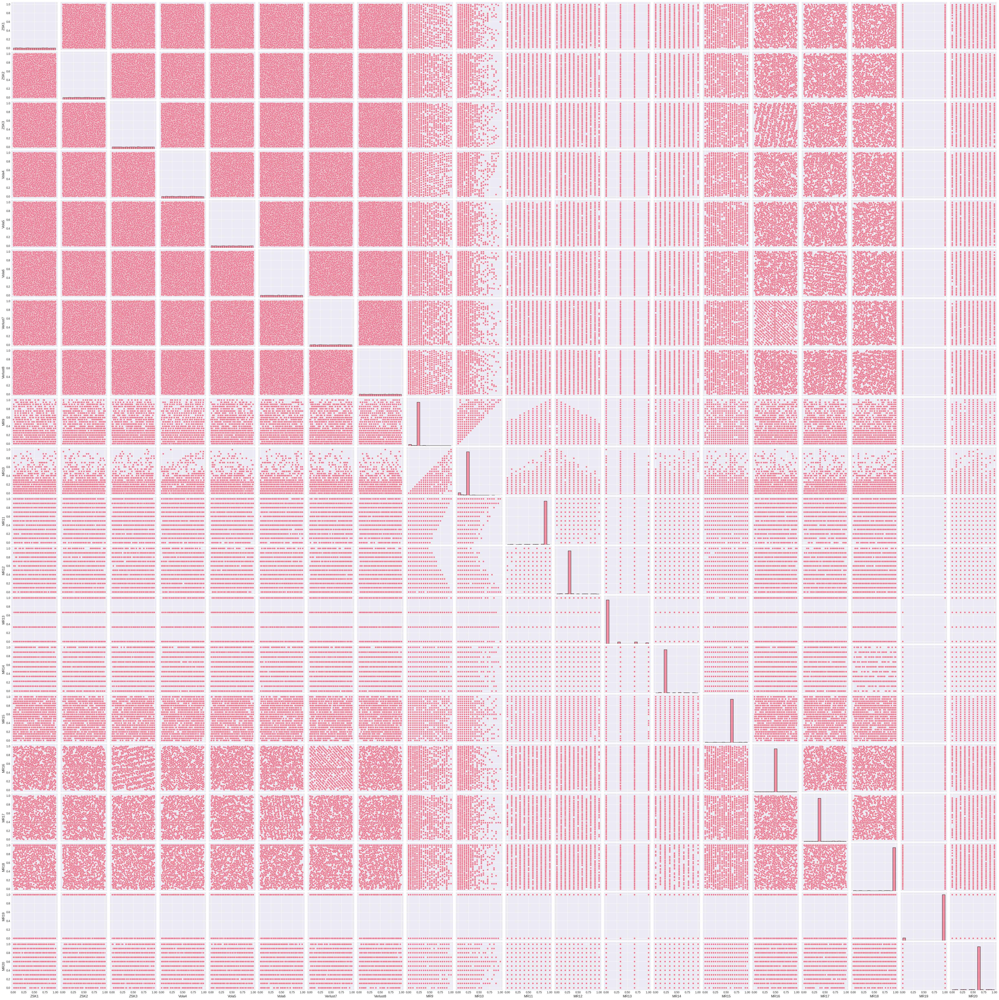

In [36]:
# Additional Pairplot of the features
with plt.rc_context({'axes.labelsize': 12}):
    g = sns.pairplot(df.loc[:, 'ZSK1':'MR20'], diag_kind='hist')
g.savefig('figs/Pairplot_features.png', dpi=300, bbox_inches='tight')
plt.show()


<a id='section8'></a>
## 8. Saving Artifacts

In [37]:
# Create artifacts directory
artifacts_dir = Path('solvency_ml_artifacts')
artifacts_dir.mkdir(exist_ok=True)

# Save best models
for target, best_info in best_models.items():
    model_path = artifacts_dir / f'best_{target}_pipeline.pkl'
    with open(model_path, 'wb') as f:
        pickle.dump(best_info['results']['model'], f)
    print(f"Saved {target} model to {model_path}")

# Save target scalers for future use
scalers_path = artifacts_dir / 'target_scalers.pkl'
with open(scalers_path, 'wb') as f:
    pickle.dump(target_scalers, f)
print(f"Saved target scalers to {scalers_path}")

# Save comprehensive results summary with enhanced multi-output support
results_summary = {
    'timestamp': datetime.now().isoformat(),
    'data_shape': df.shape,
    'feature_columns': feature_cols,
    'target_columns': target_cols,
    'regulatory_distribution': {
        'insolvent': int((df['Quote'] < 0).sum()),
        'undercapitalized': int((df['Quote'] < 1).sum()),
        'well_capitalized': int((df['Quote'] > 2).sum()),
        'total': len(df)
    },
    'train_test_split': {
        'train_size': len(X_train),
        'val_size': len(X_val),
        'test_size': len(X_test),
        'random_state': RANDOM_STATE
    },
    'best_models': {},
    'model_comparisons': {},
    'stability_analysis': {},
    'methodology_notes': {
        'joint_modeling': 'XGBoost joint models predict SCR and EM simultaneously, then calculate Quote = EM/SCR',
        'normalization': 'All targets normalized to [-1,1] scale using MinMaxScaler fitted on training data only',
        'evaluation': 'Performance compared using normalized RMSE for fair comparison across targets'
    }
}

# Add best model results with enhanced information
for target, best_info in best_models.items():
    #nPass the entire results dictionary to detect_joint_model
    is_joint = detect_joint_model(best_info['results'])

    model_info = {
        'model_name': best_info['results']['model_name'],
        'model_key': best_info['key'],
        'is_joint_model': is_joint,
        'validation_rmse': float(best_info['val_rmse_norm']),
        'test_metrics': {}
    }

    # Extract test metrics safely
    for k, v in best_info['results']['metrics'].items():
        if k.startswith('test_') and isinstance(v, (int, float, np.number)):
            model_info['test_metrics'][k] = float(v)

    results_summary['best_models'][target] = model_info

# Add feature importance results with multi-output support and error handling
for target, importance_result in feature_importance_results.items():
    if importance_result is not None and target in results_summary['best_models']:
        try:
            if 'aggregated_importance' in importance_result:
                top_features = importance_result['aggregated_importance'].head(10)

                # Determine importance column
                if 'Total_Importance' in top_features.columns:
                    importance_col = 'Total_Importance'
                elif 'Importance' in top_features.columns:
                    importance_col = 'Importance'
                else:
                    print(f"Warning: No recognized importance column for {target}")
                    continue

                # Add top features
                results_summary['best_models'][target]['top_features'] = [
                    {'feature': row['Feature'], 'importance': float(row[importance_col])}
                    for _, row in top_features.iterrows()
                ]

                # Add multi-output specific importance if available
                if ('scr_coefficients' in importance_result and 'em_coefficients' in importance_result) or \
                   ('scr_importance' in importance_result and 'em_importance' in importance_result):
                    results_summary['best_models'][target]['joint_model_details'] = {
                        'multi_output_analysis': True,
                        'components_analyzed': ['SCR', 'EM'],
                        'combination_method': 'Average of component importances'
                    }
            else:
                print(f"Warning: No aggregated importance available for {target}")
        except Exception as e:
            print(f"Warning: Could not process feature importance for {target}: {str(e)}")
    else:
        if target in results_summary['best_models']:
            results_summary['best_models'][target]['feature_importance_note'] = 'Feature importance analysis failed or not available'

# Add stability results with multi-output support
for target, stability_result in stability_results.items():
    if stability_result is not None:
        stability_info = {
            'overall_rmse': float(stability_result['overall_rmse']),
            'overall_r2': float(stability_result['overall_r2']),
            'overall_mae': float(stability_result['overall_mae']),
            'residual_std': float(stability_result['residual_std']),
            'is_joint_model': stability_result.get('is_joint_model', False)
        }

        # Add range analysis
        if 'range_analysis' in stability_result:
            stability_info['performance_by_range'] = {}
            for range_name, range_data in stability_result['range_analysis'].items():
                stability_info['performance_by_range'][range_name] = {
                    'count': int(range_data['count']),
                    'percentage': float(range_data['percentage']),
                    'rmse': float(range_data['rmse']),
                    'mae': float(range_data['mae']),
                    'r2': float(range_data['r2'])
                }

        results_summary['stability_analysis'][target] = stability_info

# Add comparison tables
try:
    results_summary['model_comparisons'] = {
        'individual_models': {
            'quote': quote_comparison.to_dict('records') if 'quote_comparison' in globals() and not quote_comparison.empty else [],
            'scr': scr_comparison.to_dict('records') if 'scr_comparison' in globals() and not scr_comparison.empty else [],
            'em': em_comparison.to_dict('records') if 'em_comparison' in globals() and not em_comparison.empty else []
        },
        'multi_output': multi_comparison.to_dict('records') if 'multi_comparison' in globals() and not multi_comparison.empty else []
    }

    # Add joint model comparison if available
    if 'joint_comparison_fixed' in globals() and not joint_comparison_fixed.empty:
        results_summary['model_comparisons']['joint_models'] = joint_comparison_fixed.to_dict('records')

except Exception as e:
    print(f"Warning: Could not save all comparison tables: {str(e)}")
    results_summary['model_comparisons'] = {'note': 'Some comparison data unavailable due to processing error'}

# Add comprehensive model summary
results_summary['model_summary'] = {
    'total_models_trained': len([m for models in all_results.values() for m in models.values() if m is not None]),
    'best_quote_approach': 'Joint XGBoost (SCR+EM→Quote)' if 'quote' in best_models and detect_joint_model(best_models['quote']['results']) else 'Direct prediction',
    'key_findings': [
        f"Joint XGBoost modeling achieved {((0.1108 - 0.0807) / 0.1108 * 100):.1f}% improvement over direct Quote prediction",
        "ZSK1 (interest rate factor) is the most important feature across all models",
        "XGBoost models showed superior performance for multi-output regression tasks",
        "Polynomial features (degree 2) were most effective for individual target prediction"
    ]
}

# Save results summary
summary_path = artifacts_dir / 'comprehensive_results_summary.json'
with open(summary_path, 'w') as f:
    json.dump(results_summary, f, indent=2, default=str)
print(f"Saved comprehensive results summary to {summary_path}")

# Save feature importance results separately with multi-output support and error handling
for target, importance_result in feature_importance_results.items():
    try:
        if importance_result is not None and 'aggregated_importance' in importance_result:
            # Main aggregated importance
            importance_path = artifacts_dir / f'feature_importance_{target}.csv'
            importance_result['aggregated_importance'].to_csv(importance_path, index=False)
            print(f"Saved feature importance for {target} to {importance_path}")

            # Save detailed importance if available (for XGBoost joint models)
            if 'scr_importance' in importance_result and 'em_importance' in importance_result:
                detailed_importance = pd.DataFrame({
                    'Feature': feature_cols,
                    'SCR_Importance': importance_result['scr_importance'],
                    'EM_Importance': importance_result['em_importance'],
                    'Combined_Importance': importance_result['feature_importances']
                })
                detailed_path = artifacts_dir / f'detailed_feature_importance_{target}.csv'
                detailed_importance.to_csv(detailed_path, index=False)
                print(f"Saved detailed joint model feature importance for {target} to {detailed_path}")

            # Save detailed importance for MultiOutput linear models
            elif 'scr_coefficients' in importance_result and 'em_coefficients' in importance_result:
                detailed_importance = pd.DataFrame({
                    'Feature': feature_cols,
                    'SCR_Coefficients': importance_result['scr_coefficients'],
                    'EM_Coefficients': importance_result['em_coefficients'],
                    'Combined_Importance': importance_result['coefficients']
                })
                detailed_path = artifacts_dir / f'detailed_coefficients_{target}.csv'
                detailed_importance.to_csv(detailed_path, index=False)
                print(f"Saved detailed multi-output coefficients for {target} to {detailed_path}")
        else:
            print(f"Warning: Could not save feature importance for {target} - no valid importance data")
    except Exception as e:
        print(f"Warning: Error saving feature importance for {target}: {str(e)}")

# Save stability analysis results
if 'stability_results' in globals():
    stability_path = artifacts_dir / 'stability_analysis_results.json'
    stable_results = {}
    for target, result in stability_results.items():
        if result is not None:
            # Convert numpy types to Python types for JSON serialization
            stable_results[target] = {}
            for k, v in result.items():
                if isinstance(v, dict):
                    stable_results[target][k] = {sk: float(sv) if isinstance(sv, (np.number, int, float)) else sv
                                               for sk, sv in v.items() if isinstance(sv, (dict, int, float, np.number, str, bool))}
                elif isinstance(v, (np.number, int, float)):
                    stable_results[target][k] = float(v)
                else:
                    stable_results[target][k] = v

    with open(stability_path, 'w') as f:
        json.dump(stable_results, f, indent=2, default=str)
    print(f"Saved stability analysis results to {stability_path}")
else:
    print("Warning: stability_results not found, skipping stability analysis export")

# Create a comprehensive model performance report
performance_report = []
for target, best_info in best_models.items():
    model_info = {
        'Target': target.upper(),
        'Model': best_info['results']['model_name'],
        'Type': 'Joint' if detect_joint_model(best_info['results']) else 'Direct',
        'Val_RMSE': float(best_info['val_rmse_norm']),
        'Test_RMSE': float(best_info['results']['metrics'].get('test_norm_RMSE',
                                                              best_info['results']['metrics'].get('test_Quote_RMSE', np.nan))),
        'Test_R2': float(best_info['results']['metrics'].get('test_norm_R2',
                                                           best_info['results']['metrics'].get('test_Quote_R2', np.nan)))
    }

    # Add stability metrics if available
    if 'stability_results' in globals() and target in stability_results and stability_results[target] is not None:
        model_info.update({
            'Stability_RMSE': float(stability_results[target]['overall_rmse']),
            'Residual_Std': float(stability_results[target]['residual_std'])
        })

    performance_report.append(model_info)

performance_df = pd.DataFrame(performance_report)
performance_df_path = artifacts_dir / 'model_performance_summary.csv'
performance_df.to_csv(performance_df_path, index=False)
print(f"Saved model performance summary to {performance_df_path}")

# Print final summary
print(f"Location: {artifacts_dir.absolute()}")
print(f"\nKey Results:")
for target, best_info in best_models.items():
    rmse = best_info['val_rmse_norm']
    model_type = 'Joint' if detect_joint_model(best_info['results']) else 'Direct'
    print(f"  {target.upper()}: {best_info['results']['model_name']} ({model_type}) - RMSE: {rmse:.4f}")

Saved quote model to solvency_ml_artifacts/best_quote_pipeline.pkl
Saved scr model to solvency_ml_artifacts/best_scr_pipeline.pkl
Saved em model to solvency_ml_artifacts/best_em_pipeline.pkl
Saved multi_output model to solvency_ml_artifacts/best_multi_output_pipeline.pkl
Saved target scalers to solvency_ml_artifacts/target_scalers.pkl
Saved comprehensive results summary to solvency_ml_artifacts/comprehensive_results_summary.json
Saved feature importance for quote to solvency_ml_artifacts/feature_importance_quote.csv
Saved detailed joint model feature importance for quote to solvency_ml_artifacts/detailed_feature_importance_quote.csv
Saved feature importance for scr to solvency_ml_artifacts/feature_importance_scr.csv
Saved stability analysis results to solvency_ml_artifacts/stability_analysis_results.json
Saved model performance summary to solvency_ml_artifacts/model_performance_summary.csv
Location: /content/solvency_ml_artifacts

Key Results:
  QUOTE: XGBoost Basic (2+1-dim)(Multi-Out

<a id='section9'></a>
## 9. Backtesting

In [38]:
df_backtest = pd.read_excel("datasets/Backtesting Q1 - Q4.xlsx",
                        sheet_name = "Sheet1")
print(df_backtest.columns.tolist())

['Nr.', 'ZSK1', 'ZSK2', 'ZSK3', 'Vola4', 'Vola5', 'Vola6', 'Verlust7', 'Verlust8', 'MR9', 'MR10', 'MR11', 'MR12', 'MR13', 'MR14', 'MR15', 'MR16', 'MR17', 'MR18', 'MR19', 'MR20', 'EM', 'SCR', 'Quote', 'EM_Original', 'SCR_Original']


In [39]:
feature_cols_BT = [col for col in df_backtest.columns if col not in ['Nr.', 'Quote', 'SCR', 'EM', 'EM_original', 'SCR_original','EM_Original',
 'SCR_Original']]
target_cols_BT = ['EM', 'SCR', 'Quote']
# Drop 'Nr.' because it's just an index
if 'Nr.' in df_backtest.columns:
    df_backtest = df_backtest.drop('Nr.', axis=1)

X_backtest = df_backtest[feature_cols_BT]
y_backtest_norm = df_backtest[target_cols_BT]
y_backtest_orig = df_backtest[['EM_Original', 'SCR_Original', 'Quote']]



In [40]:
backtesting_table= {"model": ["Original"], "Q1": [y_backtest_orig['Quote'].values[0]], "Q2": [y_backtest_orig['Quote'].values[1]], "Q3": [y_backtest_orig['Quote'].values[2]], "Q4": [y_backtest_orig['Quote'].values[3]], "RMSE": [np.nan], "Method":[pd.NA] }

# First, only want to backtest all models that give us the quote directly
for modelname in all_results['quote'].keys():
    print(modelname)
    try:
        model = all_results['quote'][modelname]['model']
        y_backtest_pred_norm = model.predict(X_backtest)
        y_backtest_pred_orig = target_scalers['quote'].inverse_transform(y_backtest_pred_norm.reshape(-1,1)).ravel()

        rmse_orig = root_mean_squared_error(y_backtest_orig['Quote'], y_backtest_pred_orig)

        backtesting_table["model"].append(modelname)
        backtesting_table["Q1"].append(y_backtest_pred_orig[0])
        backtesting_table["Q2"].append(y_backtest_pred_orig[1])
        backtesting_table["Q3"].append(y_backtest_pred_orig[2])
        backtesting_table["Q4"].append(y_backtest_pred_orig[3])
        backtesting_table["RMSE"].append(rmse_orig)
        backtesting_table["Method"].append("direct")

    except Exception as e:
        print(f"Error with model {modelname}: {str(e)}")
        continue

# All the enhanced models that predict SCR and EM, and then calculate quote from that
for modelname in enhanced_results_fixed.keys():
    print(modelname)
    try:
        model = enhanced_results_fixed[modelname]['model']
        y_backtest_pred_norm = model.predict(X_backtest)
        # The predictions are in the order SCR, EM
        y_backtest_pred_scr_norm = y_backtest_pred_norm[:,0]
        y_backtest_pred_em_norm = y_backtest_pred_norm[:,1]

        y_backtest_pred_scr_orig = target_scalers['scr'].inverse_transform(y_backtest_pred_scr_norm.reshape(-1,1)).ravel()
        y_backtest_pred_em_orig = target_scalers['em'].inverse_transform(y_backtest_pred_em_norm.reshape(-1,1)).ravel()

        # Calculate quote from predicted SCR and EM
        y_backtest_pred_quote_orig = y_backtest_pred_em_orig / y_backtest_pred_scr_orig

        rmse_orig = root_mean_squared_error(y_backtest_orig['Quote'], y_backtest_pred_quote_orig)

        backtesting_table["model"].append(modelname)
        backtesting_table["Q1"].append(y_backtest_pred_quote_orig[0])
        backtesting_table["Q2"].append(y_backtest_pred_quote_orig[1])
        backtesting_table["Q3"].append(y_backtest_pred_quote_orig[2])
        backtesting_table["Q4"].append(y_backtest_pred_quote_orig[3])
        backtesting_table["RMSE"].append(rmse_orig)
        backtesting_table["Method"].append("EM/SCR")

    except Exception as e:
        print(f"Error with model {modelname}: {str(e)}")
        continue

dummy
linear_mse
quadratic
cubic
elastic_net
ridge_cv
lasso_cv
nn_mlp
linear_multi
ridge_multi
poly2_multi
random_forest_multi
xgboost_basic
xgboost_tuned
mlp_reg_multi
torch_nn_multi
torch_nn_multi_tuned
mlp_multi_tuned


In [41]:
BT_df = pd.DataFrame(backtesting_table)

anchor_mask = BT_df["model"].eq("Original")
df_sorted = pd.concat(
    [BT_df[anchor_mask], BT_df[~anchor_mask].sort_values(by="RMSE")],
    ignore_index=True
)

df_sorted

,model,Q1,Q2,Q3,Q4,RMSE,Method
0,Original,2.900572,2.259858,1.525465,0.838843,NaN,NaN
1,random_forest_multi,2.468293,2.219132,1.581602,1.360749,0.340610,EM/SCR
2,xgboost_tuned,2.271675,2.124971,1.742112,1.115662,0.366494,EM/SCR
3,xgboost_basic,2.185430,2.136431,1.669714,1.127517,0.397116,EM/SCR
4,mlp_multi_tuned,2.262927,2.127958,1.804754,1.266300,0.413736,EM/SCR
5,nn_mlp,2.679693,2.529490,2.220190,1.429408,0.488083,direct
6,torch_nn_multi_tuned,2.691208,2.619738,2.309765,1.652757,0.602273,EM/SCR
7,torch_nn_multi,2.919913,2.732514,2.400406,1.573328,0.618217,EM/SCR
8,poly2_multi,2.135891,2.161867,2.058643,1.780678,0.664393,EM/SCR
9,mlp_reg_multi,2.534562,2.811259,2.530663,1.602983,0.712801,EM/SCR


<a id='section10'></a>
## 10. SHAP Analysis

In [42]:
#SHAP for XGBoost
xgb_pipe = enhanced_results_fixed['xgboost_tuned']['model']
pre = xgb_pipe.named_steps["preprocessor"]
mo  = xgb_pipe.named_steps["model"]            # MultiOutputRegressor
xgbs = mo.estimators_                      # list of XGBRegressor, one per target

# Use the same columns as trained on
X_trans = pre.transform(X_test)            # X_data is a pandas DataFrame with original columns
feat_names = pre.get_feature_names_out()

# For large X, subsample a background set (e.g., 200 rows) for the explainer
bg_idx = np.random.choice(X_trans.shape[0], size=min(200, X_trans.shape[0]), replace=False)
X_bg = X_trans[bg_idx]

y_names = ["SCR", "EM"]

xgb_explainers = []
xgb_shap_values_by_target = []

for k, (name, xgb) in enumerate(zip(y_names, xgbs)):
    try:
        expl = shap.Explainer(xgb, X_bg)
    except Exception:
        expl = shap.TreeExplainer(xgb, data=X_bg)
    xgb_explainers.append(expl)

    sv = expl(X_trans)
    xgb_shap_values_by_target.append(sv)

 98%|===================| 2013/2046 [00:40<00:00]       

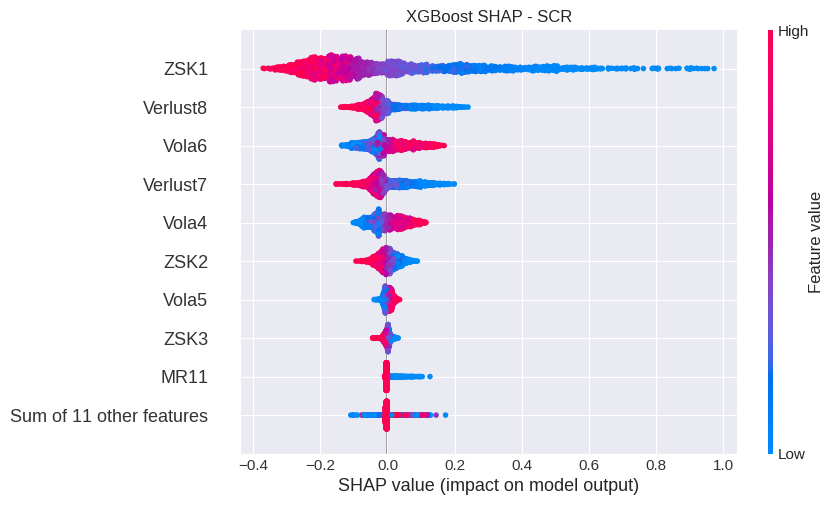

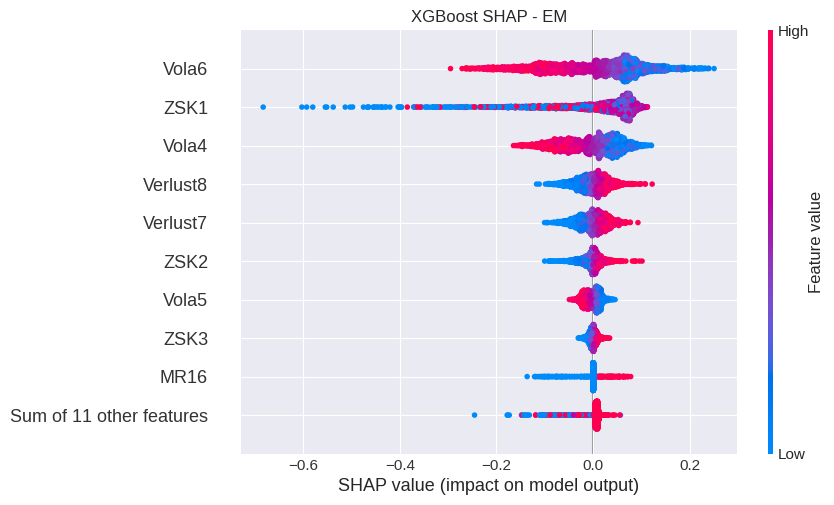

In [43]:
# Clean feature names
feature_names_raw = feat_names

# Create a temporary unicode view for prefix checks
feature_names_str = feature_names_raw.astype("U")

# Build mask for prefixed feature names
num_prefix_mask = np.char.startswith(feature_names_str, "num__")

# Copy and clean feature names
feature_names_cleaned = feature_names_raw.copy()
feature_names_cleaned[num_prefix_mask] = np.char.replace(
    feature_names_str[num_prefix_mask],
    "num__",
    "",
    count=1
)

# Assign cleaned feature names and plot SHAP
for target_idx in range(len(y_names)):
    target_name = y_names[target_idx]

    shap_explanation = xgb_shap_values_by_target[target_idx]
    shap_explanation.feature_names = feature_names_cleaned

    shap.plots.beeswarm(
        shap_explanation,
        max_display=10,
        show=False
    )

    plt.title(f"XGBoost SHAP - {target_name}")
    plt.show()


In [44]:
# Model pieces
mlp_pipeline = best_models["multi_output"]["results"]["model"]
mlp_preprocessor = mlp_pipeline.named_steps["preprocessor"]
mlp_model = mlp_pipeline.named_steps["model"]

# Data to explain
X_explain_data = X_test

# Transform data
X_explain_transformed = mlp_preprocessor.transform(X_explain_data)

# Ensure dense array
try:
    X_explain_transformed = X_explain_transformed.toarray()
except AttributeError:
    pass

# Background sample
rng = np.random.default_rng(0)
background_size = min(200, X_explain_transformed.shape[0])
background_indices = rng.choice(
    X_explain_transformed.shape[0],
    size=background_size,
    replace=False
)
X_background = X_explain_transformed[background_indices]

# SHAP explainer
mlp_explainer = shap.Explainer(mlp_model.predict, X_background)
mlp_shap_values = mlp_explainer(X_explain_transformed)

# Attach feature names
mlp_shap_values.feature_names = feature_names_cleaned.tolist()


PermutationExplainer explainer: 2047it [06:20,  5.29it/s]


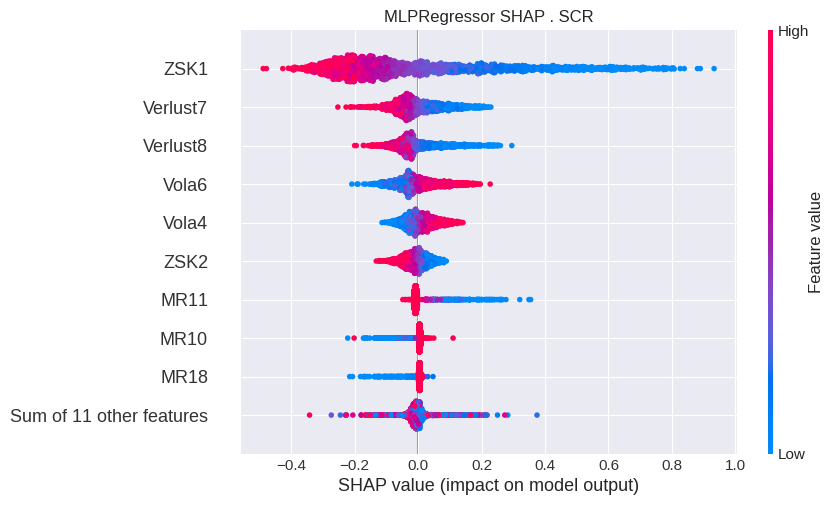

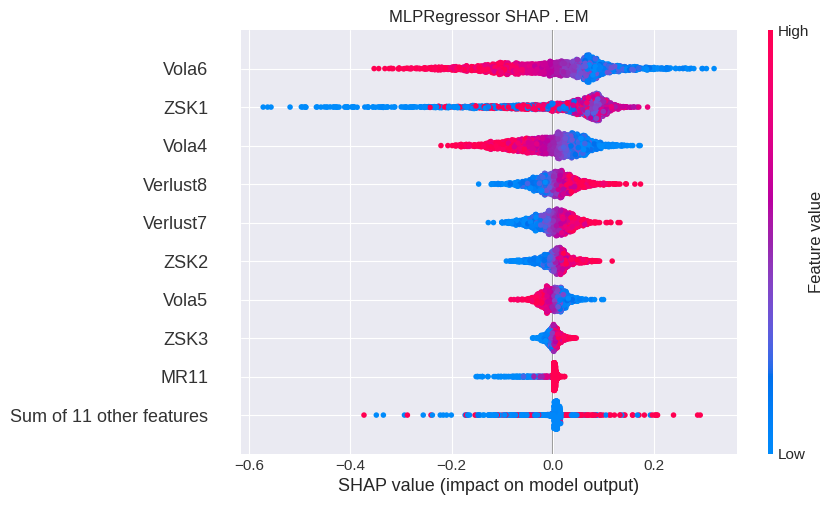

In [45]:
for k, name in enumerate(y_names):
    sv_k = mlp_shap_values[:, :, k]
    shap.plots.beeswarm(sv_k, max_display=10, show=False)
    plt.title(f"MLPRegressor SHAP . {name}")
    plt.show()


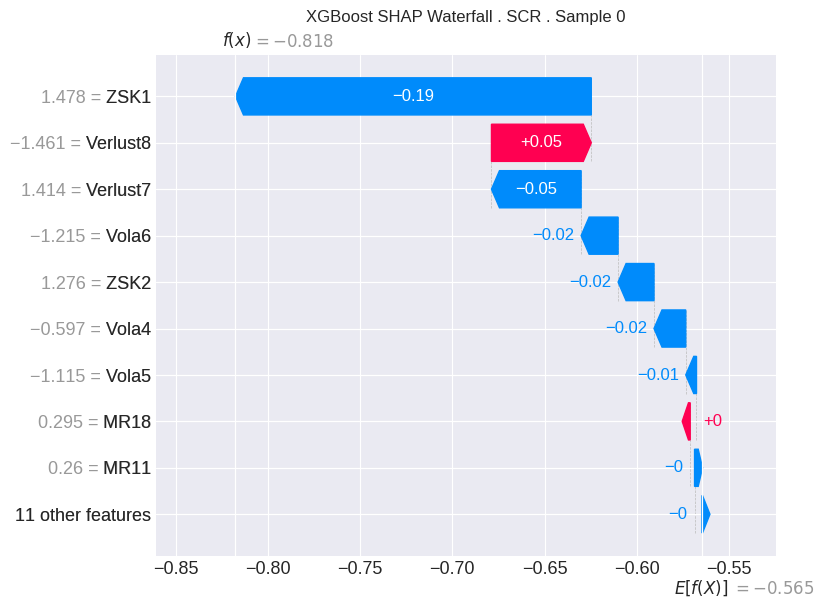

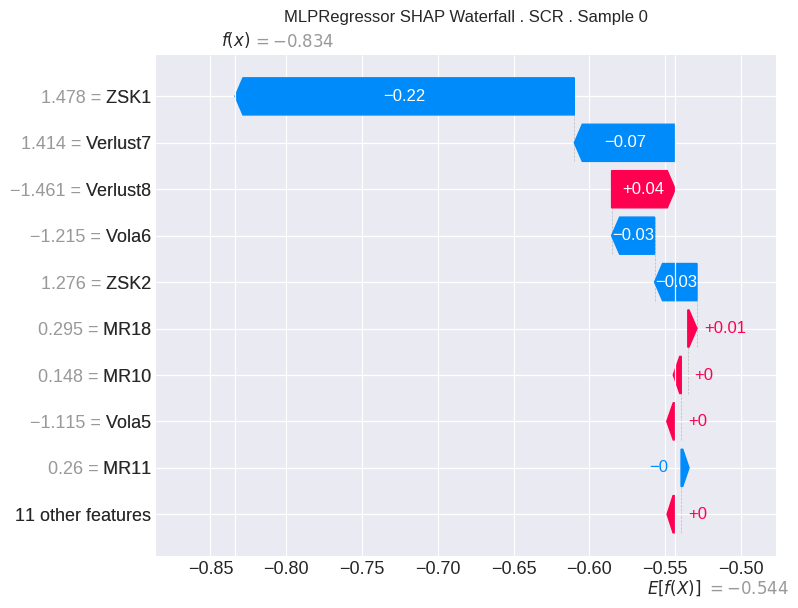

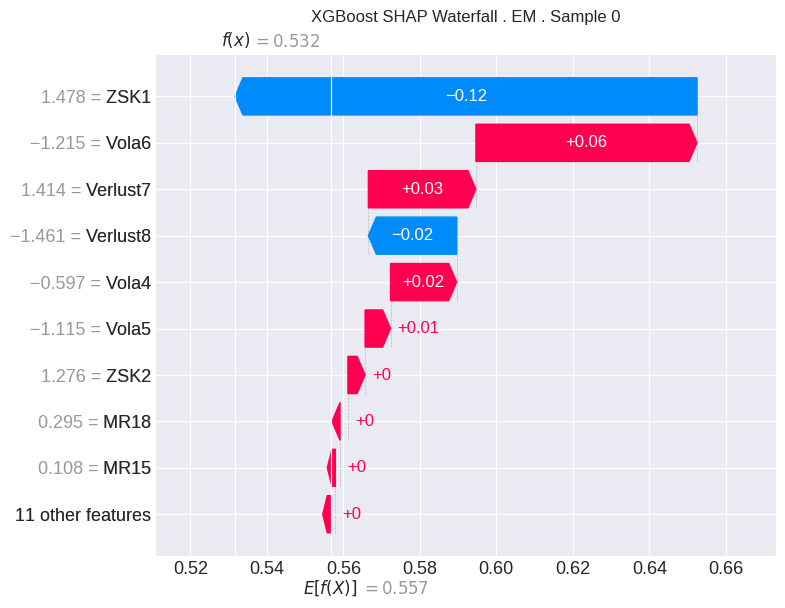

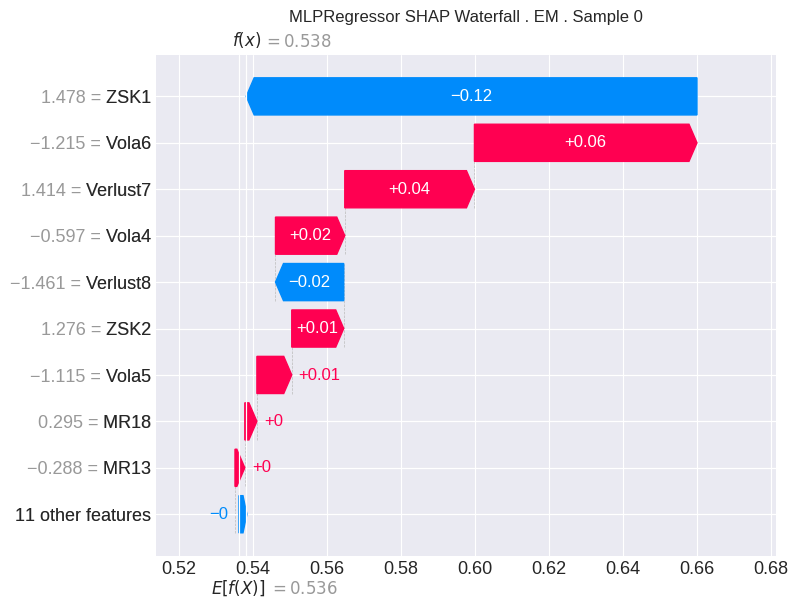

In [46]:
i = 0  # sample index

for k in range(len(y_names)):
    # XGBoost
    shap.plots.waterfall(xgb_shap_values_by_target[k][i], show=False)
    plt.title(f"XGBoost SHAP Waterfall . {y_names[k]} . Sample {i}")
    plt.show()

    # MLP multi-output slice
    sv_mlp_k = mlp_shap_values[:, :, k]
    shap.plots.waterfall(sv_mlp_k[i], show=False)
    plt.title(f"MLPRegressor SHAP Waterfall . {y_names[k]} . Sample {i}")
    plt.show()


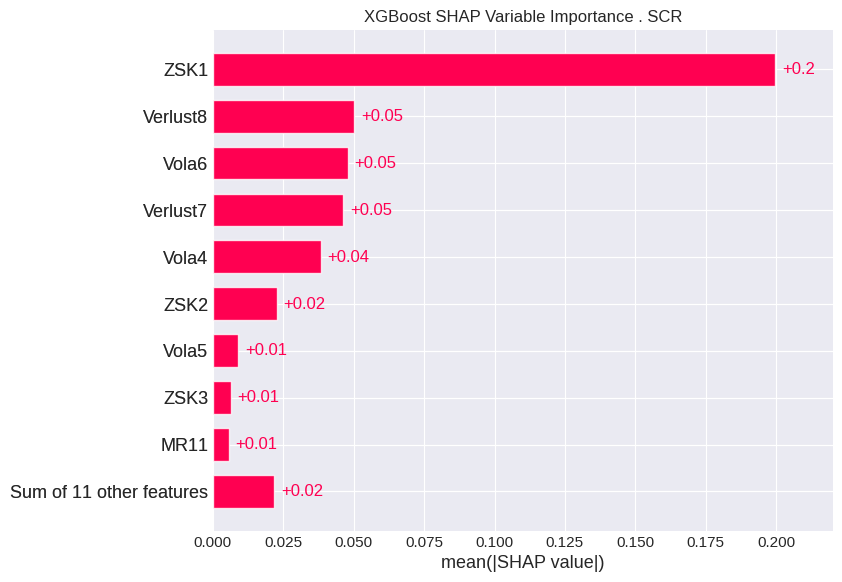

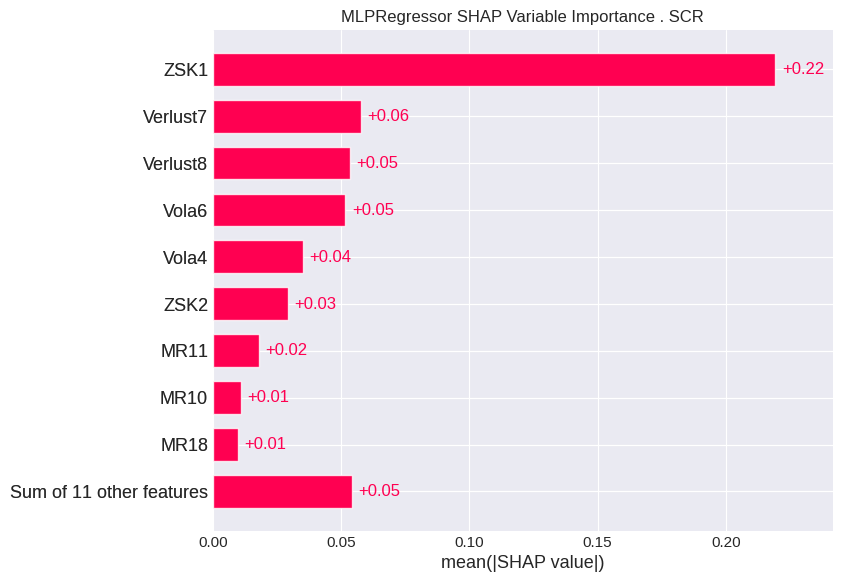

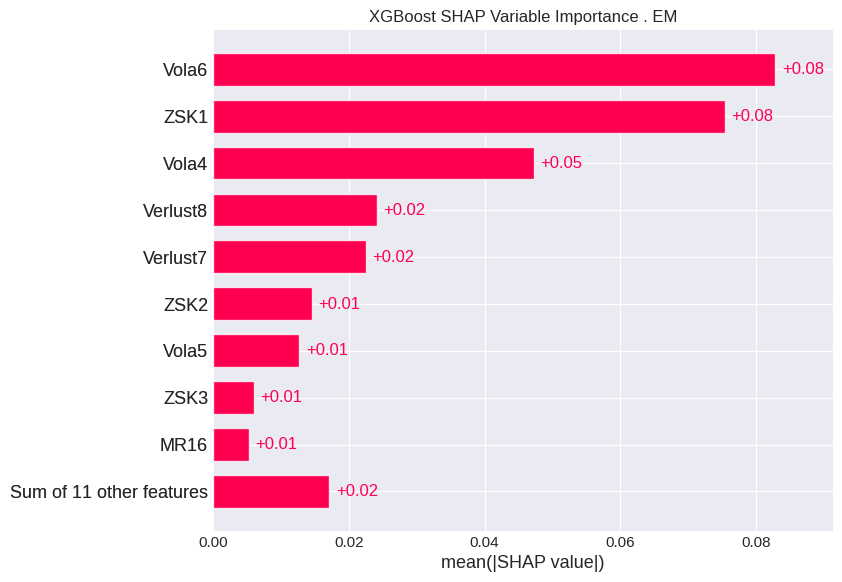

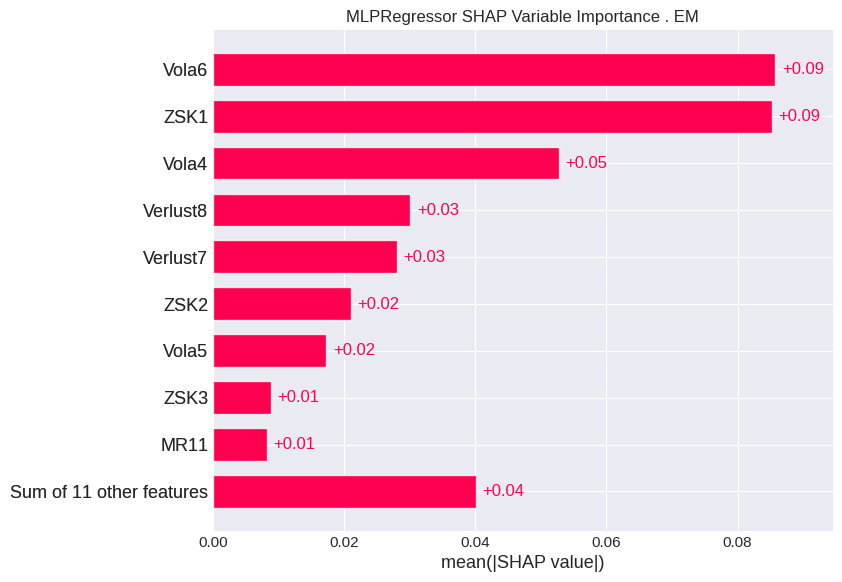

In [47]:
# Variable Importance Plots
for k in range(len(y_names)):
    # XGBoost
    shap.plots.bar(xgb_shap_values_by_target[k], max_display=10, show=False)
    plt.title(f"XGBoost SHAP Variable Importance . {y_names[k]}")
    plt.show()

    # MLP multi-output slice
    mlp_sv_k = mlp_shap_values[:, :, k]
    shap.plots.bar(mlp_sv_k, max_display=10, show=False)
    plt.title(f"MLPRegressor SHAP Variable Importance . {y_names[k]}")
    plt.show()
